<a href="https://colab.research.google.com/github/nidhihegde001/CRISMIS/blob/master/lacosmic.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import time
from numpy import asarray
from PIL import Image
import os
from astropy import log
from astropy.nddata.utils import block_reduce, block_replicate
import numpy as np
from scipy import ndimage
import requests
import re
from bs4 import BeautifulSoup
import urllib.request as urllib2

In [ ]:
from matplotlib import pyplot as plt
np.set_printoptions(threshold=np.inf)
plt.rcParams["figure.figsize"] = (20,10)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
'''
    Source: (Modified from) lacosmic library, Astropy

    Returns
    -------
    cr_image : numpy array
               The cosmic ray mask for the input image (0-background pixel, 255-cosmic ray pixel)
    ncosmics_tot : int
                Total number of cosmic ray pixels in the image
    '''

def lacosmic(data, contrast, cr_threshold, neighbor_threshold,
             error=None, mask=None, background=None, effective_gain=None,
             readnoise=None, maxiter=4, border_mode='mirror'):

    block_size = 2.0
    kernel = np.array([[0.0, -1.0, 0.0], [-1.0, 4.0, -1.0], [0.0, -1.0, 0.0]])

    clean_data = data.copy()
    if background is not None:
        clean_data += background
    final_crmask = np.zeros(data.shape, dtype=bool)

    if error is not None:
        if data.shape != error.shape:
            raise ValueError('error and data must have the same shape')
    clean_error_image = error

    ncosmics, ncosmics_tot = 0, 0
    for iteration in range(maxiter):
        sampled_img = block_replicate(clean_data, block_size)
        convolved_img = ndimage.convolve(sampled_img, kernel,
                                         mode=border_mode).clip(min=0.0)
        laplacian_img = block_reduce(convolved_img, block_size)

        if clean_error_image is None:
            if effective_gain is None or readnoise is None:
                raise ValueError('effective_gain and readnoise must be '
                                 'input if error is not input')
            med5_img = ndimage.median_filter(clean_data, size=5,
                                             mode=border_mode).clip(min=1.e-5)
            error_image = (np.sqrt(effective_gain*med5_img + readnoise**2) /
                           effective_gain)
        else:
            error_image = clean_error_image

        snr_img = laplacian_img / (block_size * error_image)
        # this is used to remove extended structures (larger than ~5x5)
        snr_img -= ndimage.median_filter(snr_img, size=5, mode=border_mode)

        # used to remove compact bright objects
        med3_img = ndimage.median_filter(clean_data, size=3, mode=border_mode)
        med7_img = ndimage.median_filter(med3_img, size=7, mode=border_mode)
        finestruct_img = ((med3_img - med7_img) / error_image).clip(min=0.01)

        cr_mask1 = snr_img > cr_threshold
        # NOTE: to follow the paper exactly, this condition should be
        # "> contrast * block_size".  "lacos_im.cl" uses simply "> contrast"
        cr_mask2 = (snr_img / finestruct_img) > contrast
        cr_mask = cr_mask1 * cr_mask2
        if mask is not None:
            cr_mask = np.logical_and(cr_mask, ~mask)

        # grow cosmic rays by one pixel and check in snr_img
        selem = np.ones((3, 3))
        neigh_mask = ndimage.binary_dilation(cr_mask, selem)
        cr_mask = cr_mask1 * neigh_mask
        # now grow one more pixel and lower the detection threshold
        neigh_mask = ndimage.binary_dilation(cr_mask, selem)
        cr_mask = (snr_img > neighbor_threshold) * neigh_mask

        # previously unknown cosmic rays found in this iteration
        crmask_new = np.logical_and(~final_crmask, cr_mask)
        ncosmics = np.count_nonzero(crmask_new)

        final_crmask = np.logical_or(final_crmask, cr_mask)
        ncosmics_tot += ncosmics
        if (ncosmics_tot>0):
          log.info('Iteration {0}: Found {1} cosmic-ray pixels, '
                  'Total: {2}'.format(iteration + 1, ncosmics, ncosmics_tot))
    cr_image = 1*final_crmask*255
    return cr_image,ncosmics_tot

In [ ]:
 """
        Prints the cosmic ray mask and the corresponding image
        Parameters
        ----------
        cr_image : numpy array
               The cosmic ray mask for the input image (0-background pixel, 255-cosmic ray pixel)
        data : numpy array
               The original image as np array
        """
        
def plot_results(c,data):
  plt.subplot(121)
  plt.imshow(c,cmap='gray', vmin=0, vmax=255)
  plt.title('Mask'),plt.xticks([]),plt.yticks([])
  plt.subplot(122)
  plt.imshow(data,cmap='gray', vmin=0, vmax=255)
  plt.title('Image'),plt.xticks([]),plt.yticks([])
  plt.show()

In [ ]:
"""
        Scans a directory from the the MESSENGER archive
        Link : https://pdsimage2.wr.usgs.gov/archive/mess-e_v_h-mdis-2-edr-rawdata-v1.0/MSGRMDS_1001/DATA/

        Segregates the positive images based on the parameter value of TARGET_NAME ( For e.g. : MERCURY )

        Parameters
        ----------
        directory : str
              Format : (year + '_' +  day of year) 
"""

def scan_directory(directory):
    url = 'https://pdsimage2.wr.usgs.gov/archive/mess-e_v_h-mdis-2-edr-rawdata-v1.0/MSGRMDS_1001/DATA/'+ directory
    links = urllib2.urlopen(url).read()
    soup = BeautifulSoup(links)
    for image_links in soup.find_all('a',text=re.compile('.IMG')):
        file = requests.get(url+ '/' + image_links['href'])
        # print(image_links['href'])
        img_data = bytearray()
        header = []
#         print(file.content)
        # Test takes 2 values:
        # 0-> Before end of header is reached
        # 1-> End of header and start of image data
        test = 0
        for line in file.iter_lines():
            # Read Image data
            if test: 
                img_data.extend(line)

            # End of header is reached
            elif re.match("^END$", line.decode('utf-8').strip()):
                test = 1

            # Read the Header
            else:
                header.append(line.decode('utf-8').strip())

        file.close()
#         print(header)
        # Flag takes 3 values:
        # 0-> before required data is encountered
        # 1-> Reading required data
        # 2-> after the required data is read
        flag = 0
        for line in header:
            
            if re.match('^TARGET_NAME',line):
                target = line.split('"')[1]
                # print(target)

            # Start Byte
            if re.match('^\^IMAGE',line):
                n = line.split('=')
                start_byte = int(n[1].strip())

            # End of required data 
            if re.match('^END_OBJECT',line):
                flag = 2

            # Beginning of required data
            if re.match('^OBJECT',line):
                flag = 1

            # Required data
            if flag == 1:
                if re.match('^LINES',line):
                    # Extract no of rows
                    a = line.split()
                    row = int(a[2])

                elif re.match('^LINE_SAMPLES',line):
                    # Extract no of columns
                    a = line.split()
                    column = int(a[2])

                elif re.match('^SAMPLE_BITS',line):
                    # Extract the type of bit encoding
                    a = line.split()
                    typ = 'uint'+ a[2]

        # print(row,column,typ)
        #     print(len(img_data.decode()))

        # b => bit width of data
        b = int(a[2])

        # Numpy array from byte array
        a = np.frombuffer(img_data[len(img_data)%16:],dtype=typ)
        #     print(a)

        # s => No of extra bits in the image data = Total no of bits - rows*columns
        s = (a.size/row -column)*row

        if s<0:
            print("S is negative:",s)
            continue

        # t => Array after Trash data is removed
        t = a[int(s):].copy()
        # print(t.size)
        t.resize((row,column))

        # Reshaping the array
        np.divide(t,float(2**(b-8)))
        t = t.astype('uint8')

        # Print image
        image = Image.fromarray(t)
    #     plt.imshow(im,cmap='gray',vmin=0,vmax=255)
    #     plt.show()
        data = asarray(image)
        crmask,n_cosmic = lacosmic(data, contrast=5.0, cr_threshold=4.5, neighbor_threshold=0.3, 
                                         error=None, mask=None, background=None, effective_gain=1.0,
                                         readnoise=6.5, maxiter=1, border_mode=u'mirror')
        file = image_links['href'].split('.')[0]
        save_dir = target
        if not os.path.exists('drive/My Drive/CRISMIS/' + save_dir):
            os.mkdir('drive/My Drive/CRISMIS/' + save_dir)
        if (n_cosmic > 0):
            # plot_results(crmask,image)
            plt.imsave( 'drive/My Drive/CRISMIS/'+ save_dir +'/'+ file + '__'+ str(row) + '.png', t,cmap='gray')


In [ ]:
''' Dates included in our dataset '''

dates = ['2011_154','2011_155','2011_156', '2011_157','2011_158','2011_159', '2011_160', '2011_161', '2011_162',
        '2011_214',
        '2011_216', '2011_217',
        '2011_221',
        '2011_249',
        '2011_250',
        '2011_251',
        '2011_265','2011_266',
        '2011_277','2011_278','2011_279',
        '2011_287',
        '2011_290',
        '2011_307','2011_308','2011_309',
        '2011_312','2011_313','2011_314',
        '2011_321','2011_322',
        '2011_323','2011_324','2011_325',
        '2012_023','2012_024','2012_025','2012_026','2012_027','2012_028','2012_029','2012_030','2012_031','2012_032','2012_033','2012_034',
        '2012_062'
      ]

In [ ]:
for date in dates:
  since = time.time()
  scan_directory(date)
  time_elapsed = time.time() - since
  print("Date", date)
  print('Scanning complete in {:.0f}m {:.0f}s'.format(
      time_elapsed // 60, time_elapsed % 60))

INFO: Iteration 1: Found 5 cosmic-ray pixels, Total: 5 [unknown]
INFO: Iteration 1: Found 3 cosmic-ray pixels, Total: 3 [unknown]
INFO: Iteration 1: Found 3 cosmic-ray pixels, Total: 3 [unknown]
INFO: Iteration 1: Found 1 cosmic-ray pixels, Total: 1 [unknown]
INFO: Iteration 1: Found 4 cosmic-ray pixels, Total: 4 [unknown]
INFO: Iteration 1: Found 76 cosmic-ray pixels, Total: 76 [unknown]
INFO: Iteration 1: Found 3 cosmic-ray pixels, Total: 3 [unknown]
INFO: Iteration 1: Found 4 cosmic-ray pixels, Total: 4 [unknown]
INFO: Iteration 1: Found 11 cosmic-ray pixels, Total: 11 [unknown]
INFO: Iteration 1: Found 4 cosmic-ray pixels, Total: 4 [unknown]
INFO: Iteration 1: Found 14 cosmic-ray pixels, Total: 14 [unknown]
INFO: Iteration 1: Found 21 cosmic-ray pixels, Total: 21 [unknown]
INFO: Iteration 1: Found 12 cosmic-ray pixels, Total: 12 [unknown]
INFO: Iteration 1: Found 5 cosmic-ray pixels, Total: 5 [unknown]
INFO: Iteration 1: Found 8 cosmic-ray pixels, Total: 8 [unknown]
INFO: Iteration

### Test algorithm predictions on some data

In [ ]:
"""
        Runs the algorithm on some test images and shows predictions

        Parameters
        ----------
        image_dir : str
              Path to the directory containing some sample images ( in .png/.jpg or any common format recognized by Pillow )
"""
def test_lacosmic(image_dir):
  i = 0
  for image in os.listdir(image_dir):
      image = Image.open(image_dir + '/' + image)
      data = asarray(image)[:,:,1]
      print("Index",i)
      i+=1
      crmask,c_count = lacosmic(data, contrast=5.0, cr_threshold=4.5, neighbor_threshold=0.3, 
                                      error=None, mask=None, background=None, effective_gain=1.0,
                                      readnoise=6.5, maxiter=1, border_mode=u'mirror')
      plot_results(crmask,data)

##### Positive Data

Index 0
INFO: Iteration 1: Found 11 cosmic-ray pixels, Total: 11 [unknown]


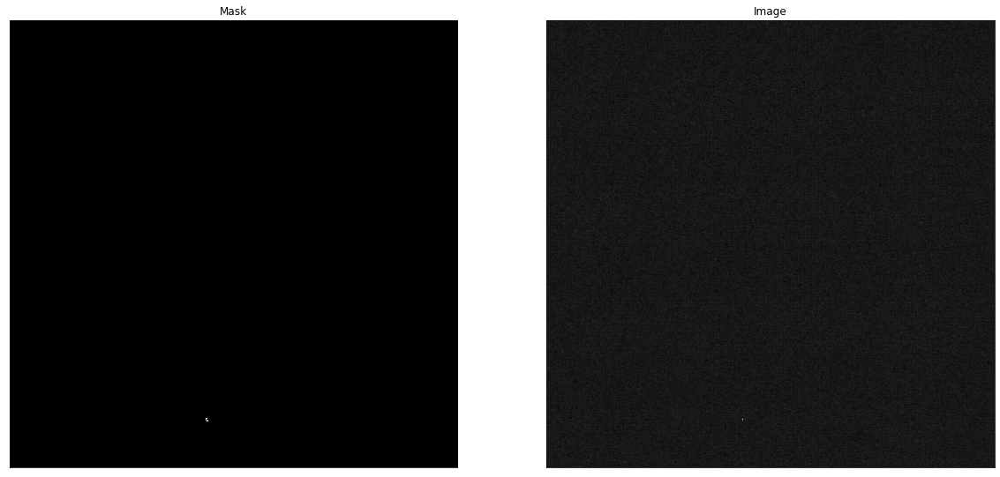

Index 1
INFO: Iteration 1: Found 8 cosmic-ray pixels, Total: 8 [unknown]


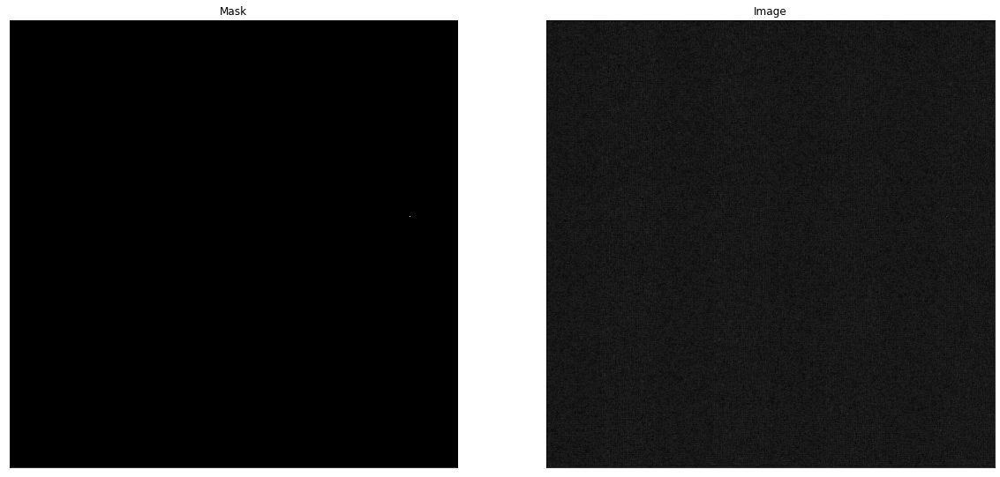

Index 2
INFO: Iteration 1: Found 160 cosmic-ray pixels, Total: 160 [unknown]


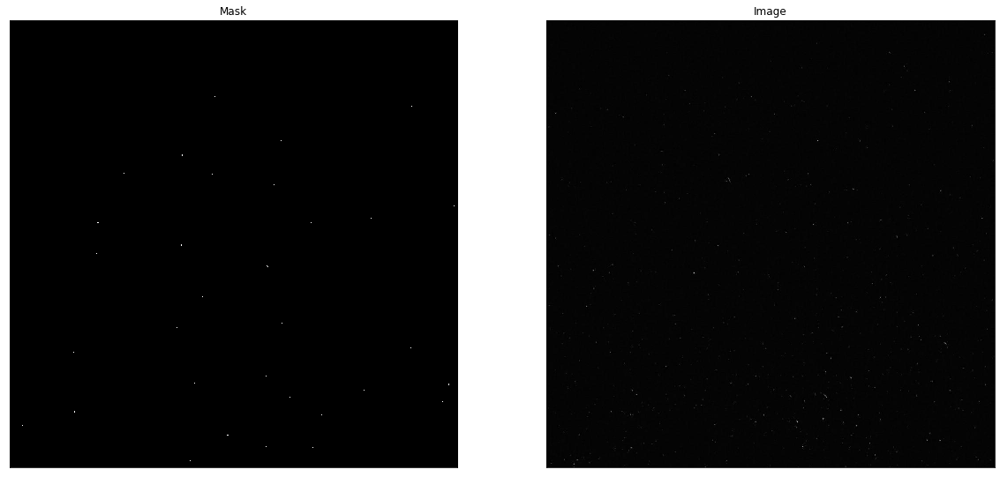

Index 3
INFO: Iteration 1: Found 155 cosmic-ray pixels, Total: 155 [unknown]


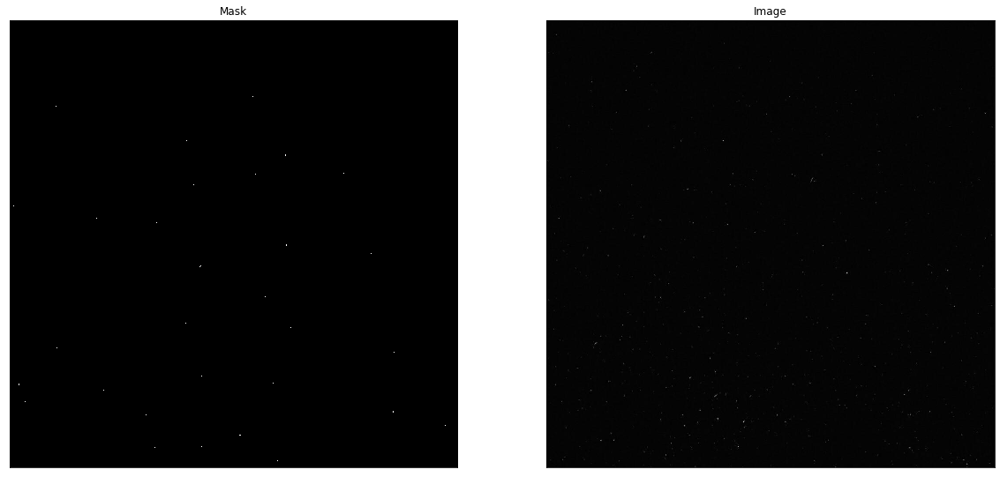

Index 4
INFO: Iteration 1: Found 150 cosmic-ray pixels, Total: 150 [unknown]


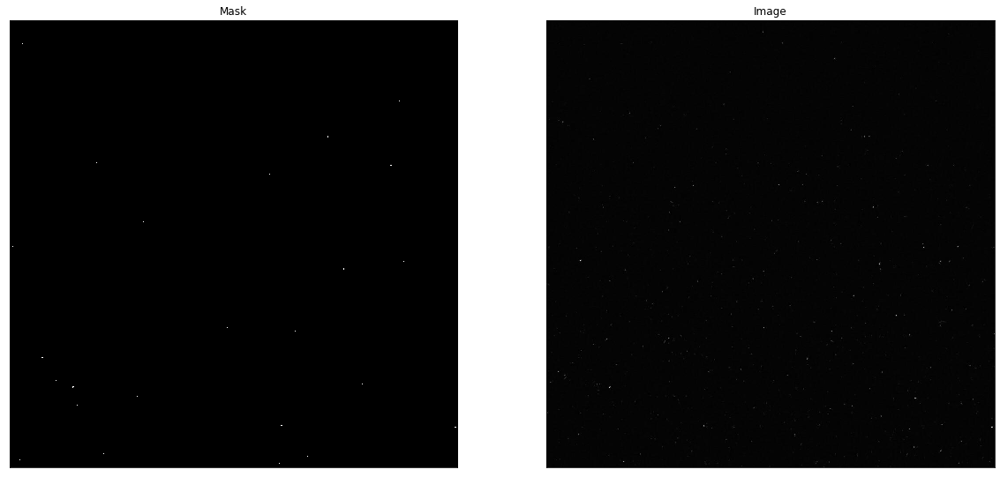

Index 5
INFO: Iteration 1: Found 193 cosmic-ray pixels, Total: 193 [unknown]


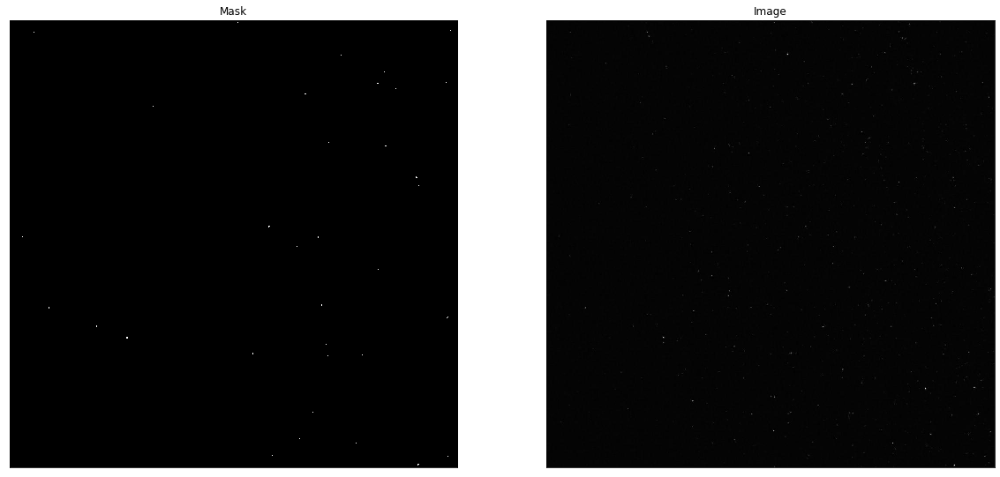

Index 6
INFO: Iteration 1: Found 57 cosmic-ray pixels, Total: 57 [unknown]


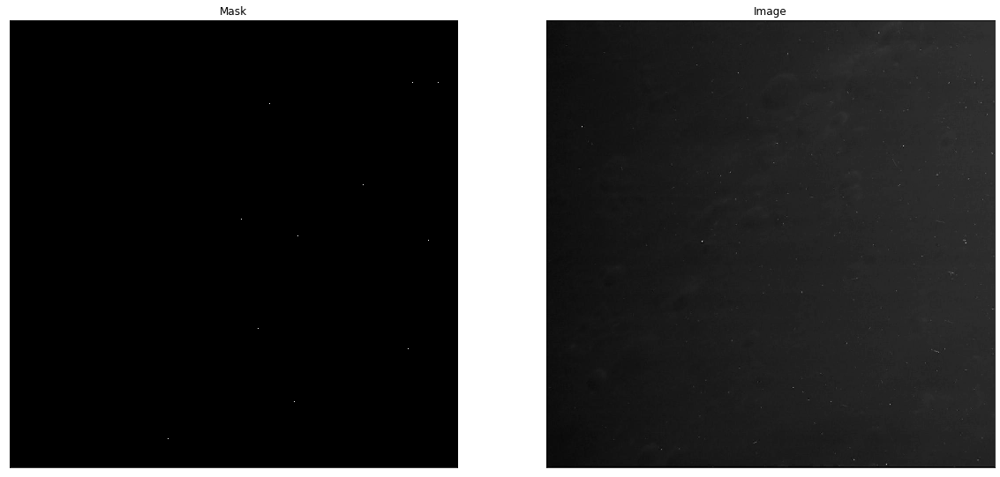

Index 7
INFO: Iteration 1: Found 74 cosmic-ray pixels, Total: 74 [unknown]


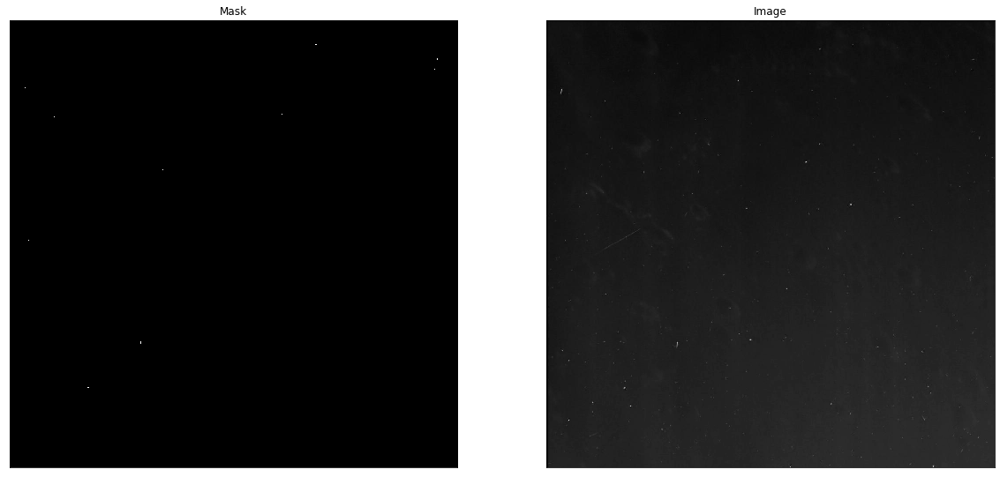

Index 8
INFO: Iteration 1: Found 74 cosmic-ray pixels, Total: 74 [unknown]


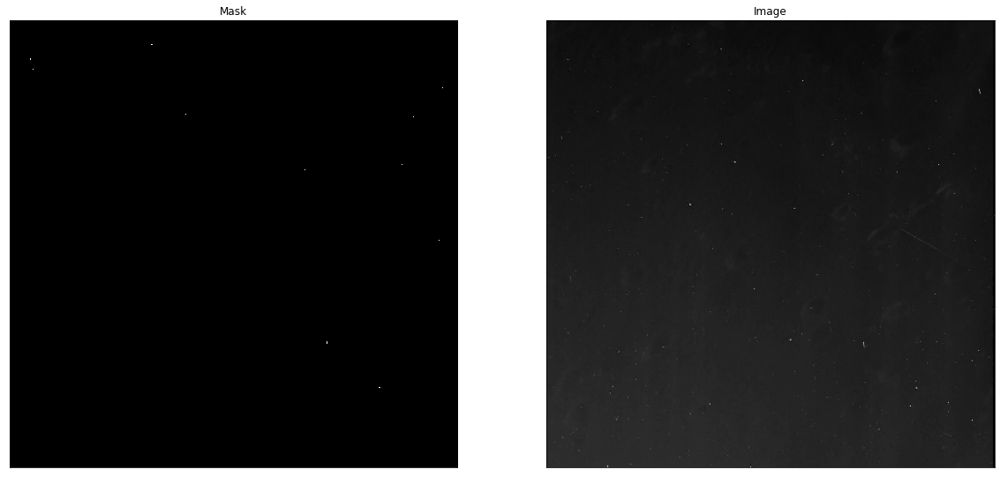

Index 9
INFO: Iteration 1: Found 75 cosmic-ray pixels, Total: 75 [unknown]


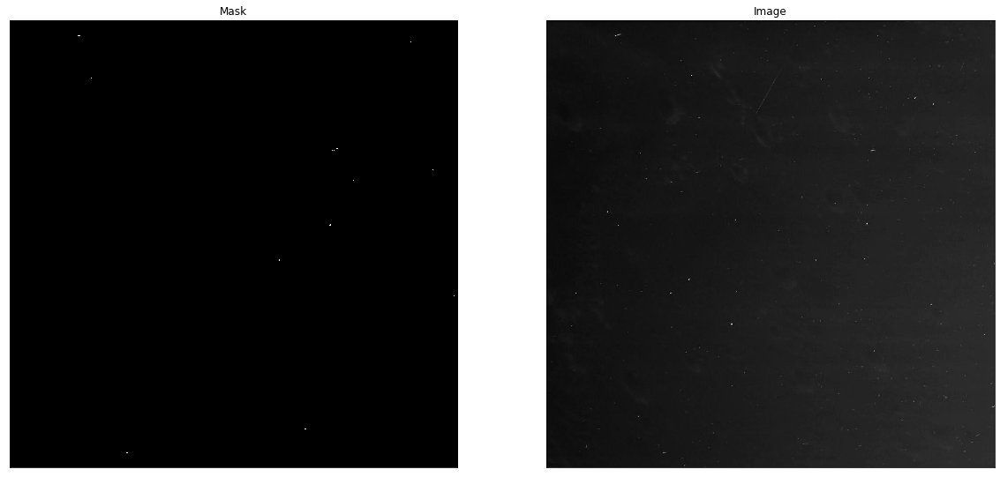

Index 10
INFO: Iteration 1: Found 64 cosmic-ray pixels, Total: 64 [unknown]


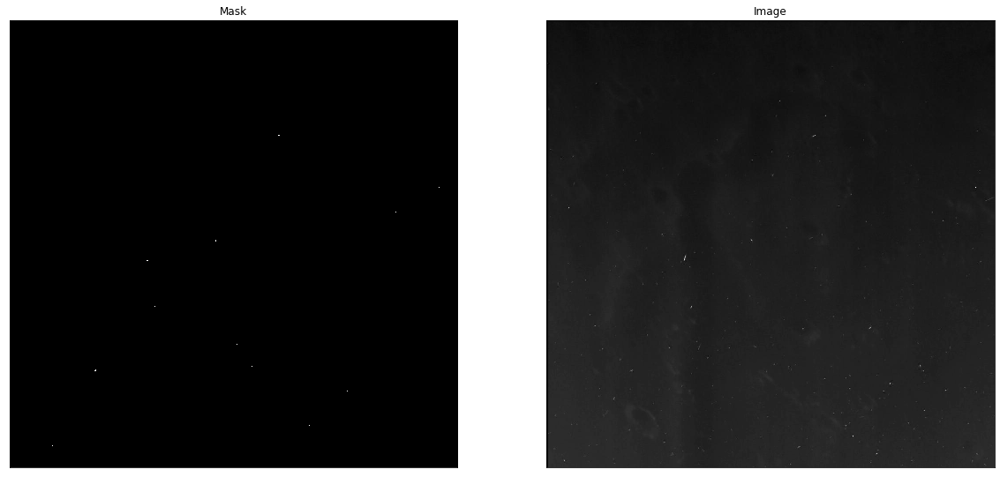

Index 11
INFO: Iteration 1: Found 74 cosmic-ray pixels, Total: 74 [unknown]


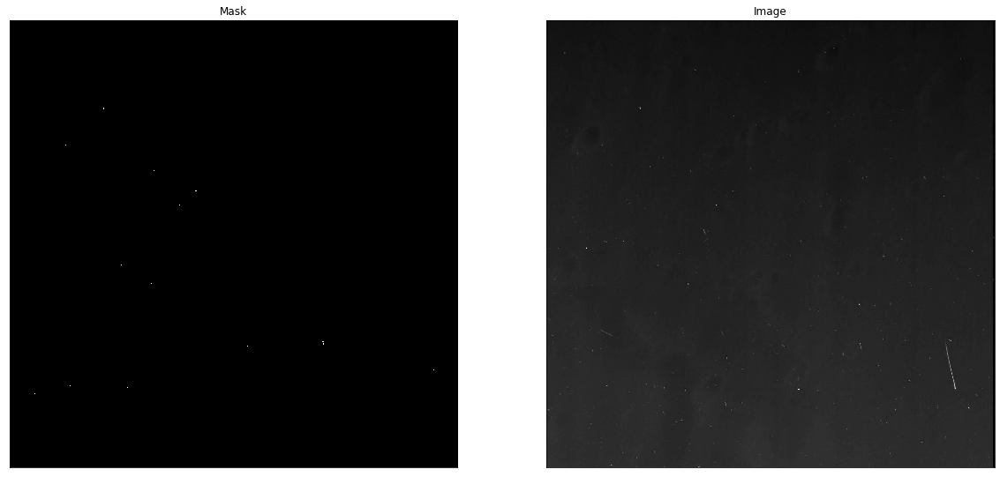

Index 12
INFO: Iteration 1: Found 50 cosmic-ray pixels, Total: 50 [unknown]


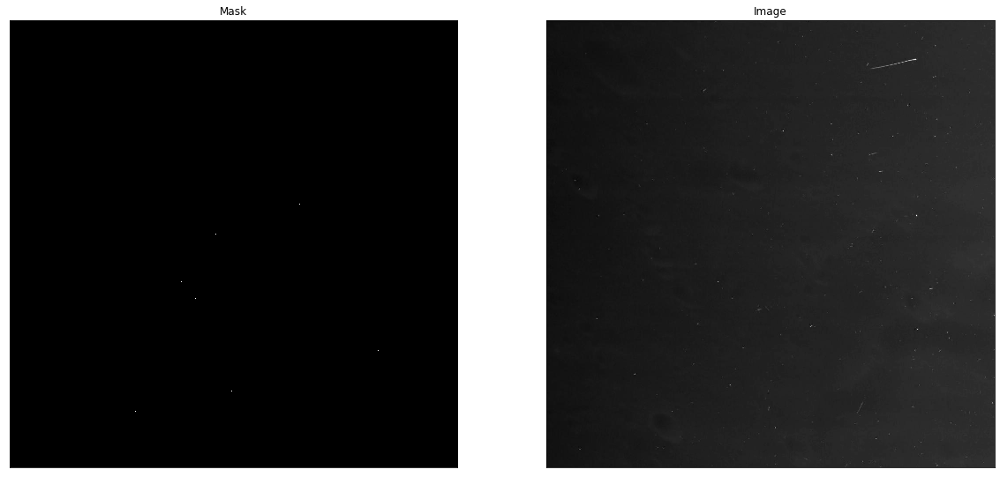

Index 13
INFO: Iteration 1: Found 131 cosmic-ray pixels, Total: 131 [unknown]


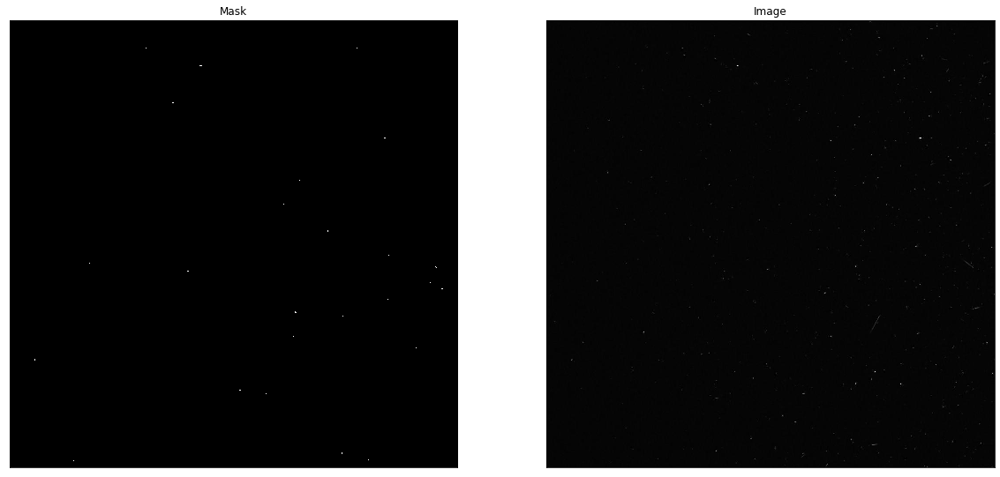

Index 14
INFO: Iteration 1: Found 165 cosmic-ray pixels, Total: 165 [unknown]


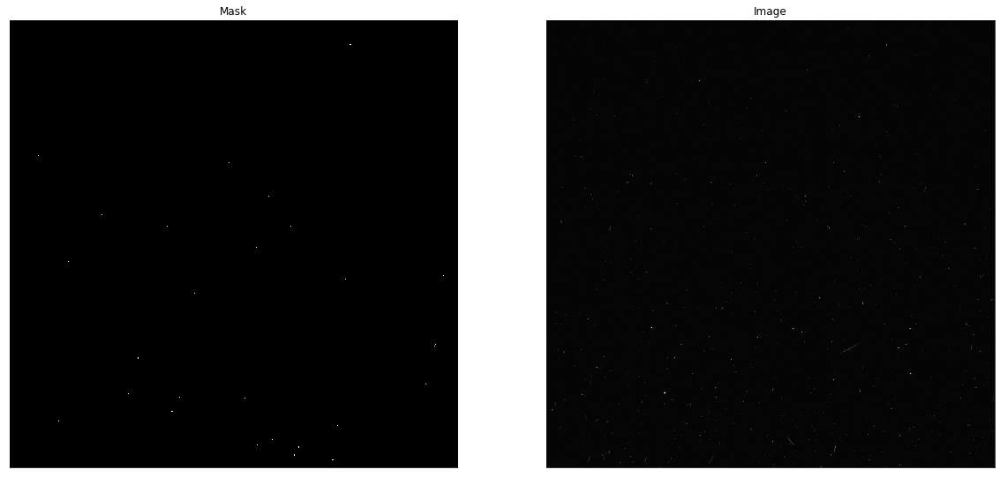

Index 15
INFO: Iteration 1: Found 138 cosmic-ray pixels, Total: 138 [unknown]


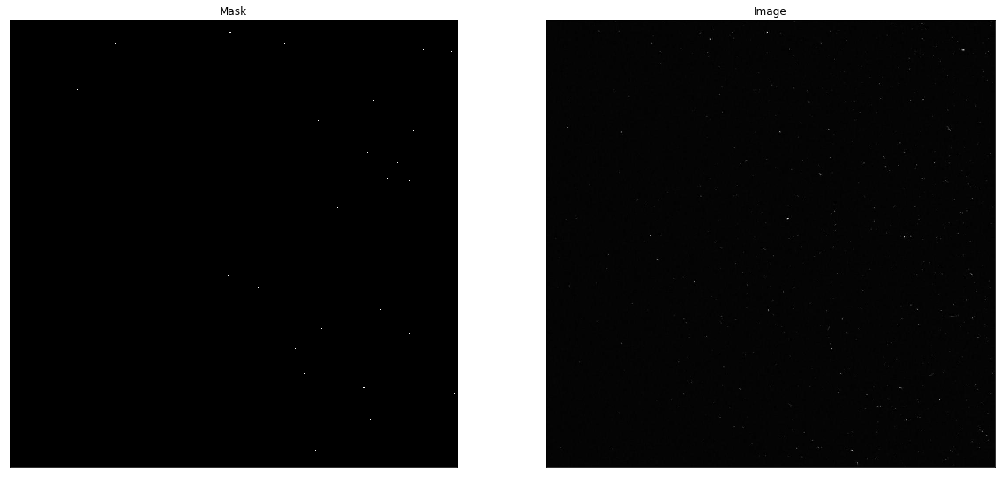

Index 16
INFO: Iteration 1: Found 190 cosmic-ray pixels, Total: 190 [unknown]


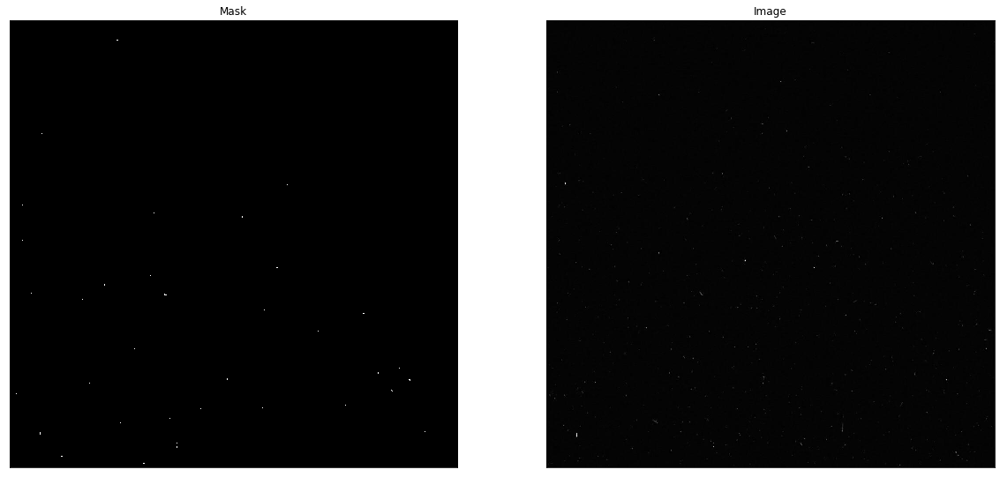

Index 17
INFO: Iteration 1: Found 218 cosmic-ray pixels, Total: 218 [unknown]


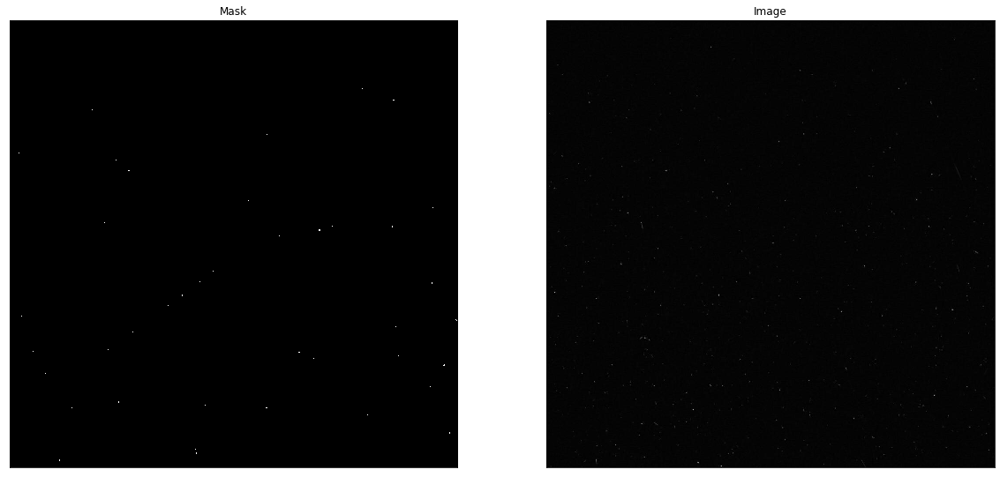

Index 18
INFO: Iteration 1: Found 186 cosmic-ray pixels, Total: 186 [unknown]


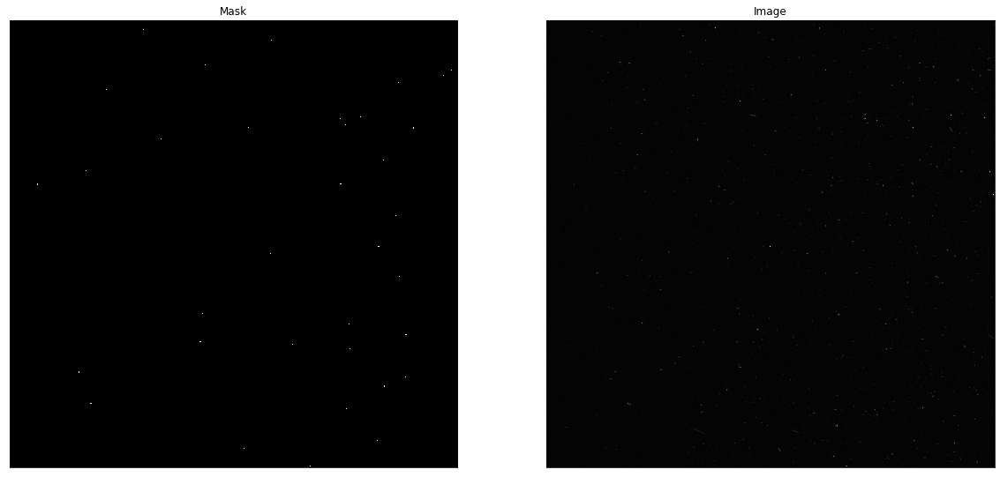

Index 19
INFO: Iteration 1: Found 244 cosmic-ray pixels, Total: 244 [unknown]


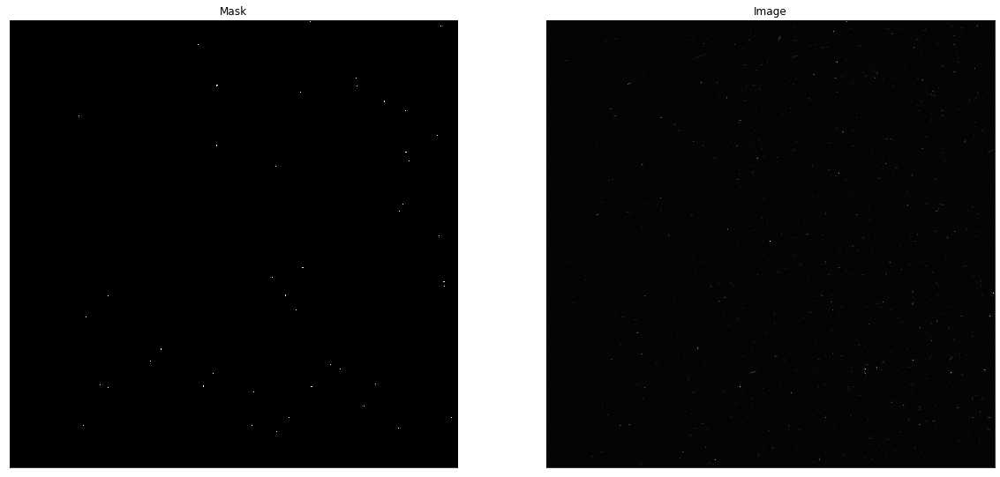

Index 20
INFO: Iteration 1: Found 113 cosmic-ray pixels, Total: 113 [unknown]


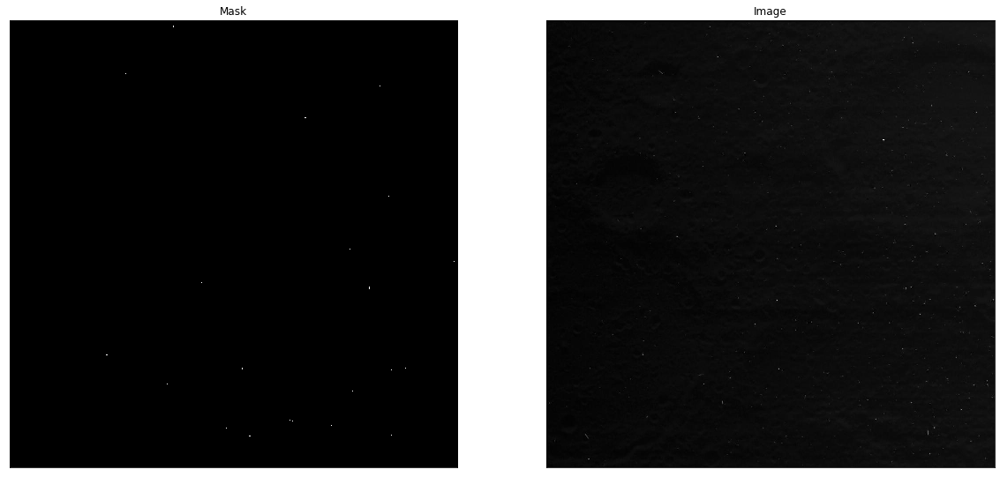

Index 21
INFO: Iteration 1: Found 123 cosmic-ray pixels, Total: 123 [unknown]


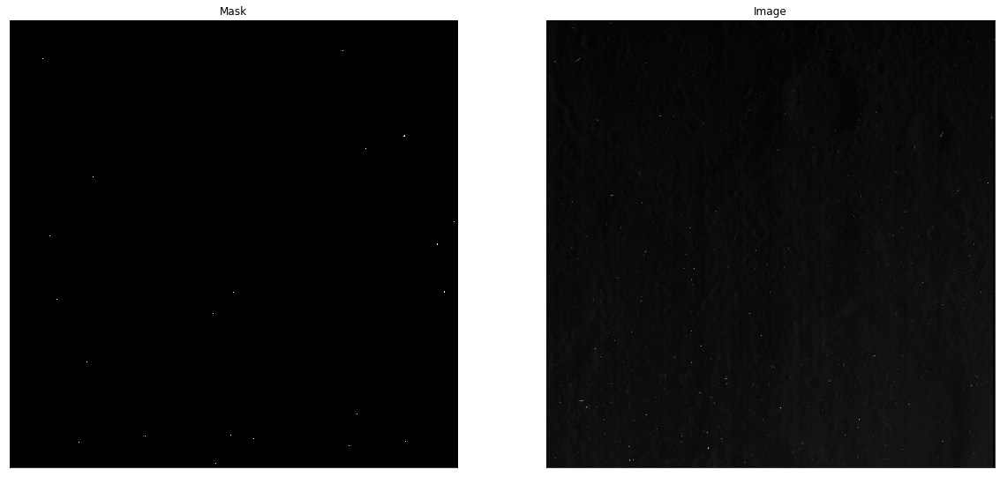

Index 22
INFO: Iteration 1: Found 125 cosmic-ray pixels, Total: 125 [unknown]


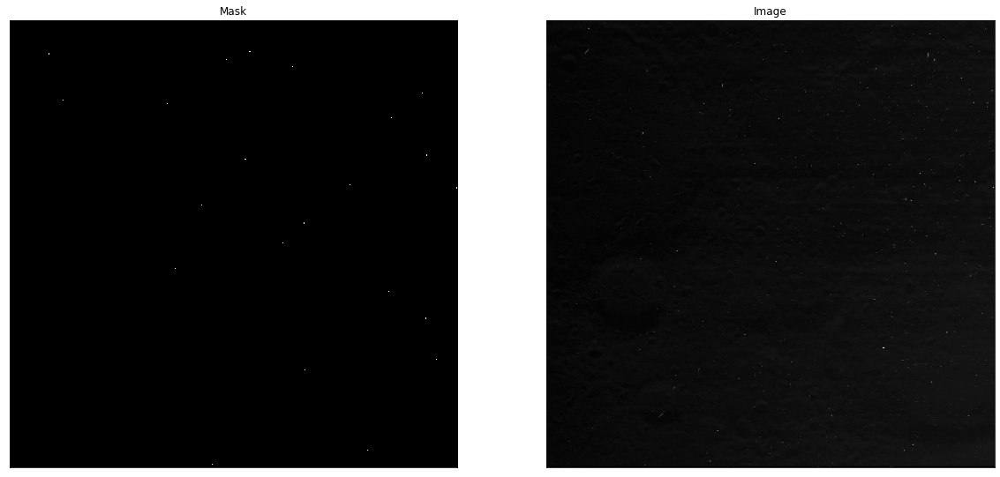

Index 23
INFO: Iteration 1: Found 78 cosmic-ray pixels, Total: 78 [unknown]


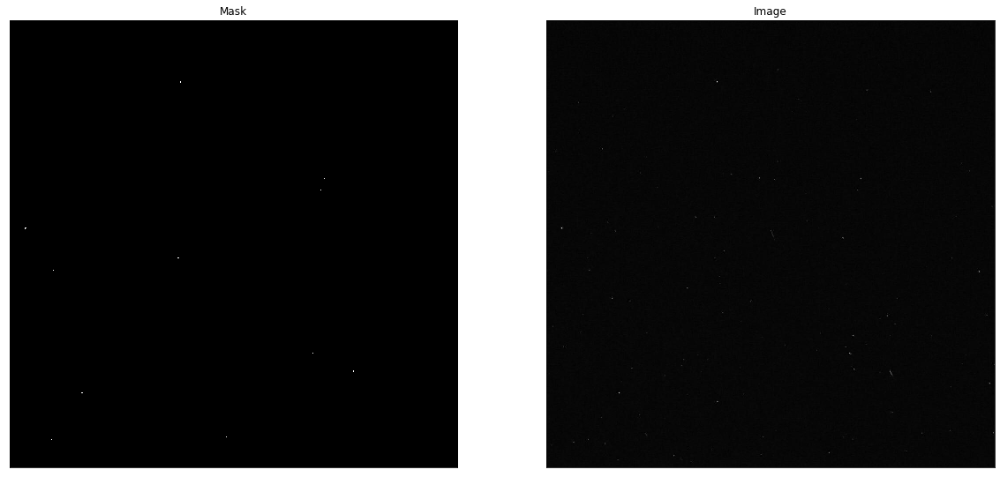

Index 24
INFO: Iteration 1: Found 88 cosmic-ray pixels, Total: 88 [unknown]


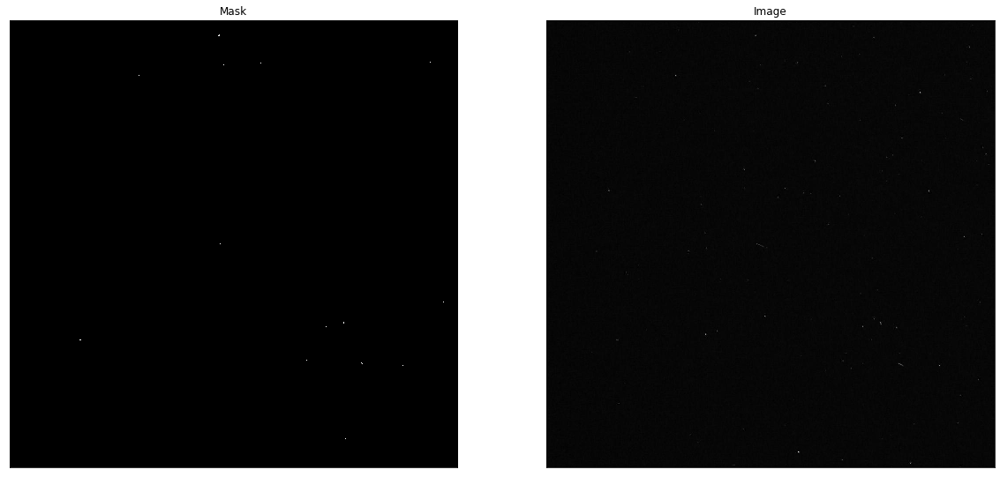

Index 25
INFO: Iteration 1: Found 79 cosmic-ray pixels, Total: 79 [unknown]


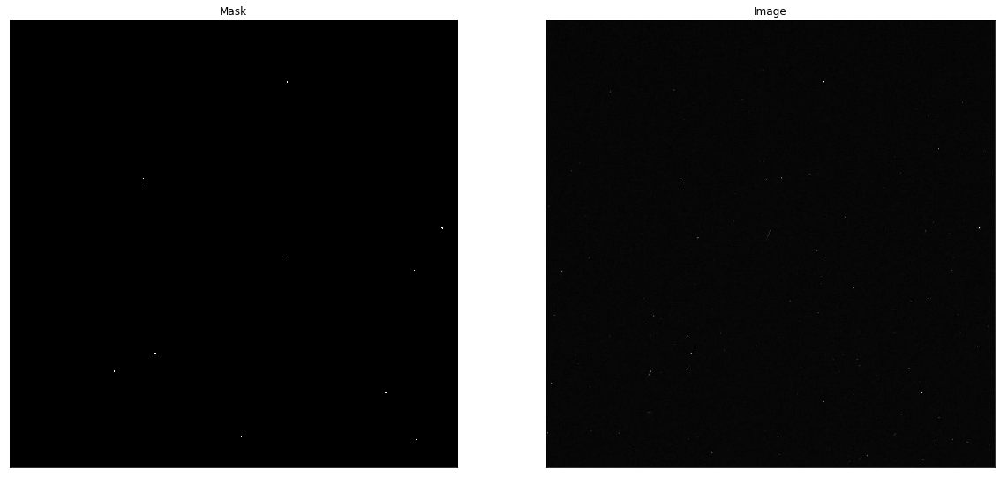

Index 26
INFO: Iteration 1: Found 53 cosmic-ray pixels, Total: 53 [unknown]


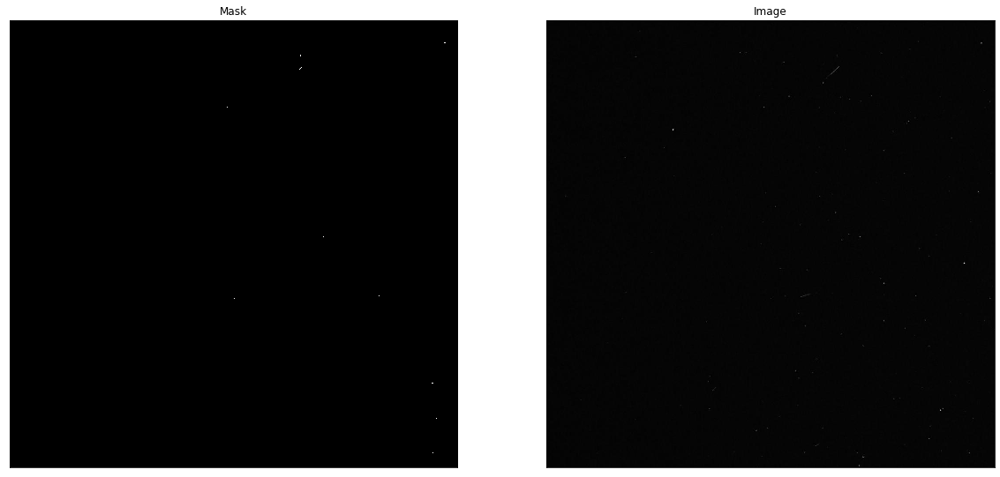

Index 27
INFO: Iteration 1: Found 54 cosmic-ray pixels, Total: 54 [unknown]


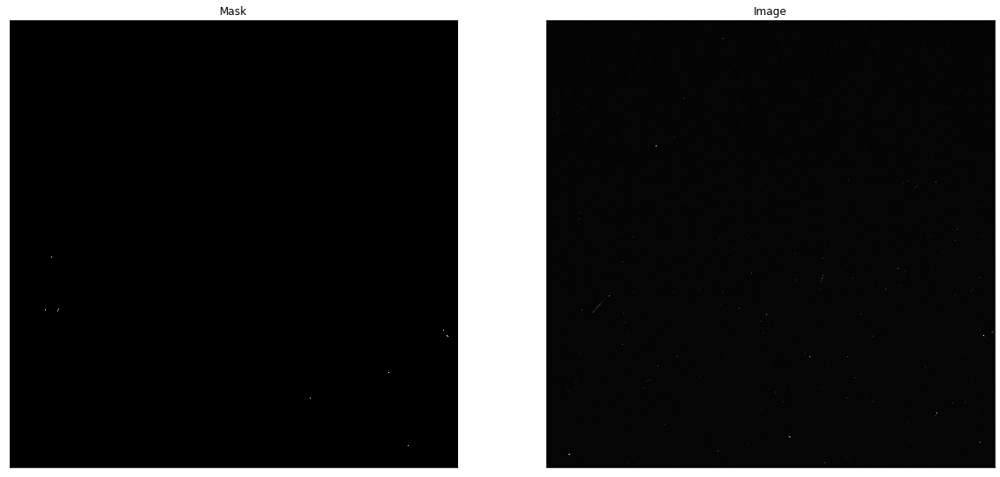

Index 28
INFO: Iteration 1: Found 54 cosmic-ray pixels, Total: 54 [unknown]


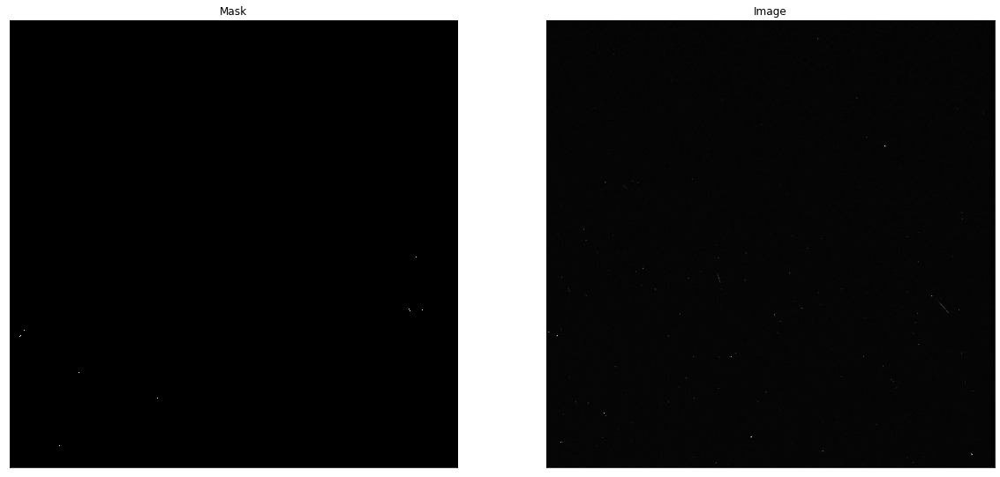

Index 29
INFO: Iteration 1: Found 84 cosmic-ray pixels, Total: 84 [unknown]


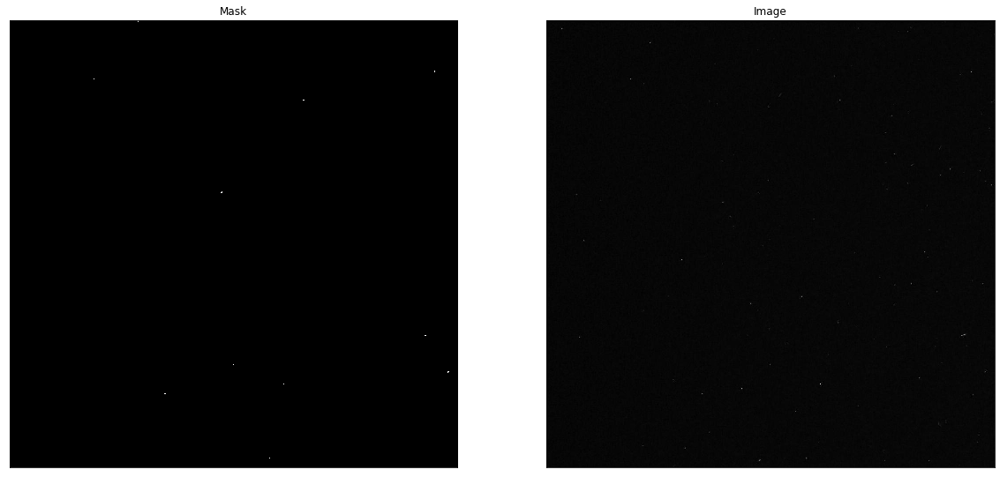

Index 30
INFO: Iteration 1: Found 87 cosmic-ray pixels, Total: 87 [unknown]


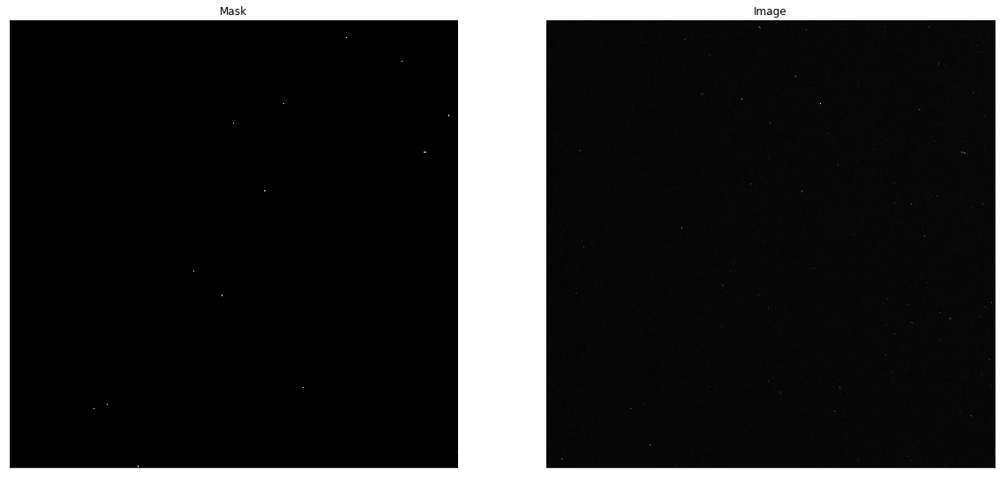

Index 31
INFO: Iteration 1: Found 84 cosmic-ray pixels, Total: 84 [unknown]


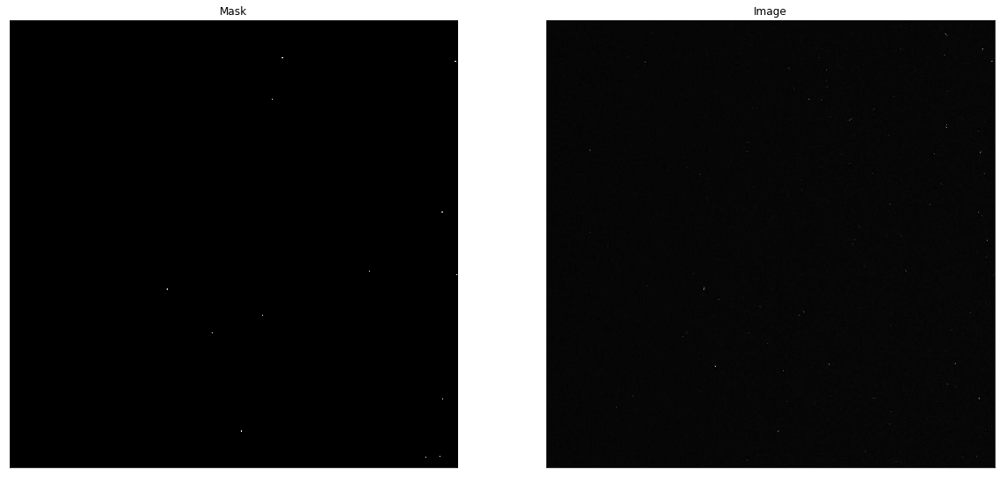

Index 32
INFO: Iteration 1: Found 44 cosmic-ray pixels, Total: 44 [unknown]


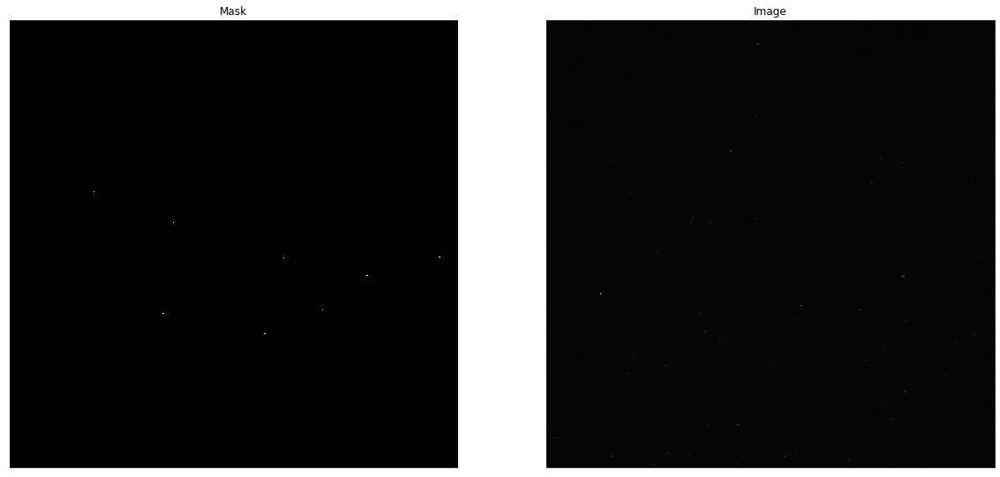

Index 33
INFO: Iteration 1: Found 19 cosmic-ray pixels, Total: 19 [unknown]


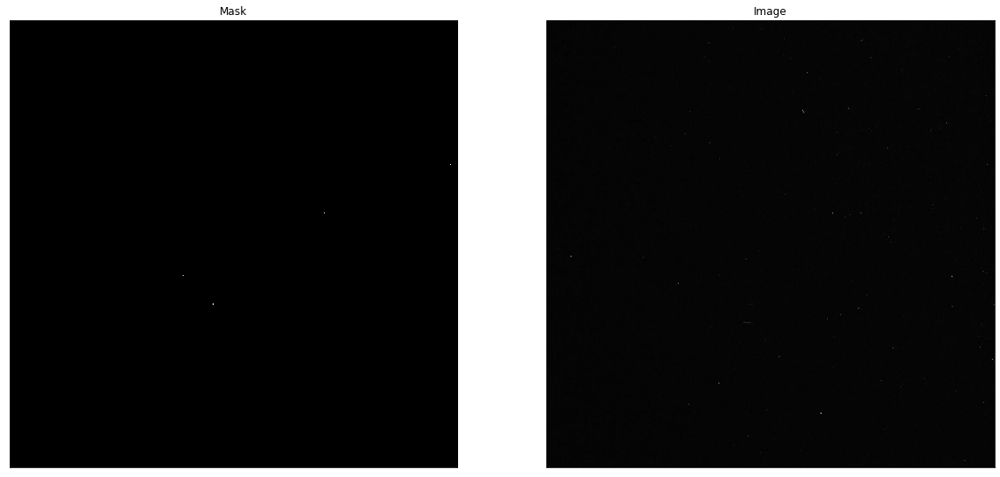

Index 34
INFO: Iteration 1: Found 28 cosmic-ray pixels, Total: 28 [unknown]


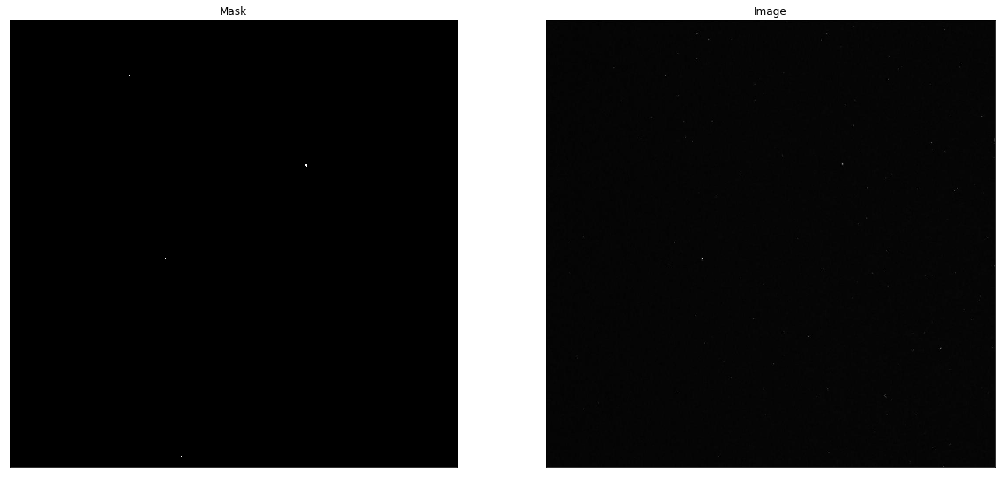

Index 35
INFO: Iteration 1: Found 42 cosmic-ray pixels, Total: 42 [unknown]


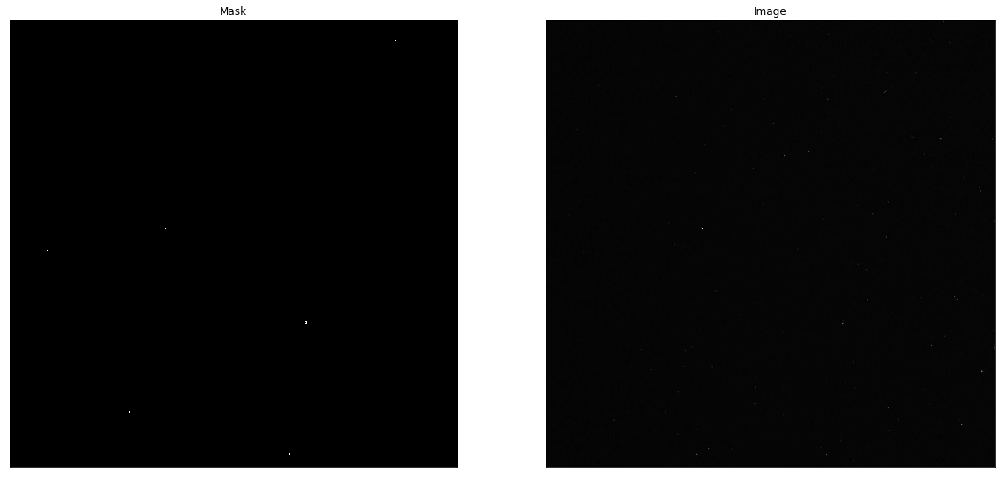

Index 36
INFO: Iteration 1: Found 39 cosmic-ray pixels, Total: 39 [unknown]


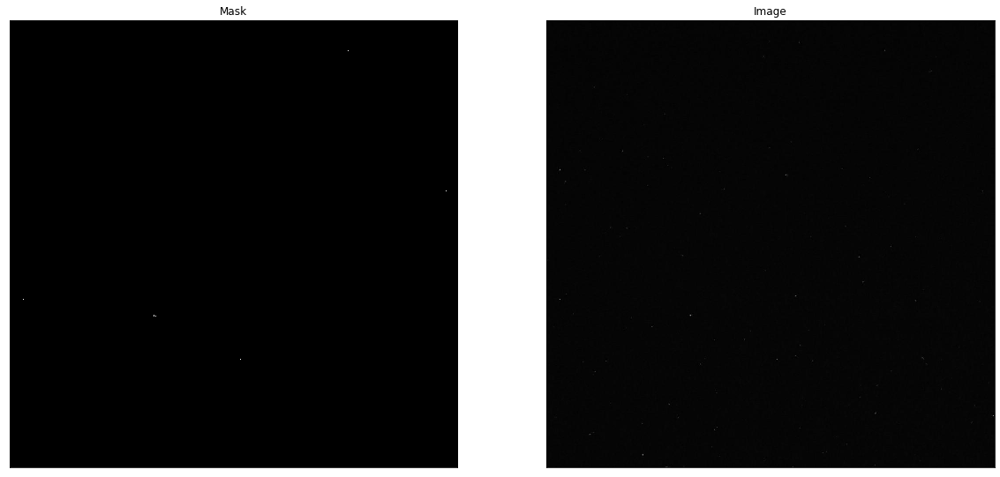

Index 37
INFO: Iteration 1: Found 82 cosmic-ray pixels, Total: 82 [unknown]


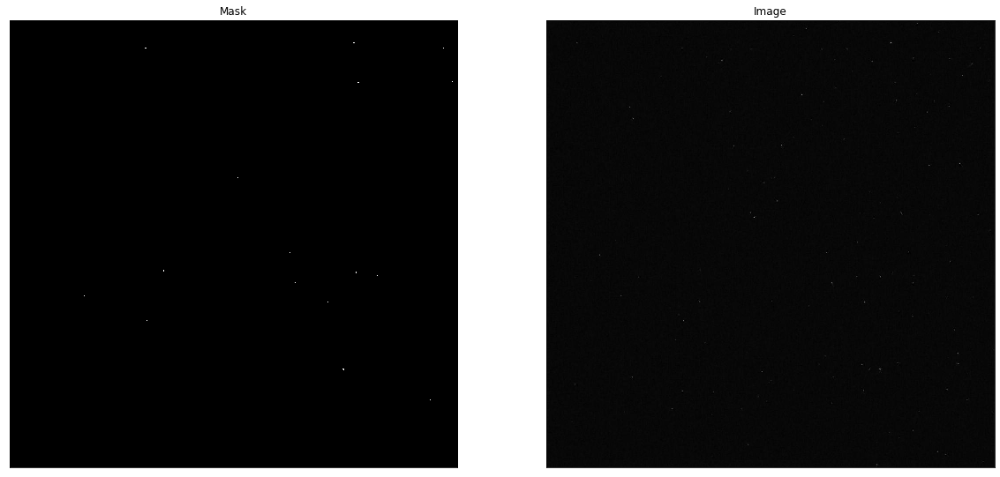

Index 38
INFO: Iteration 1: Found 84 cosmic-ray pixels, Total: 84 [unknown]


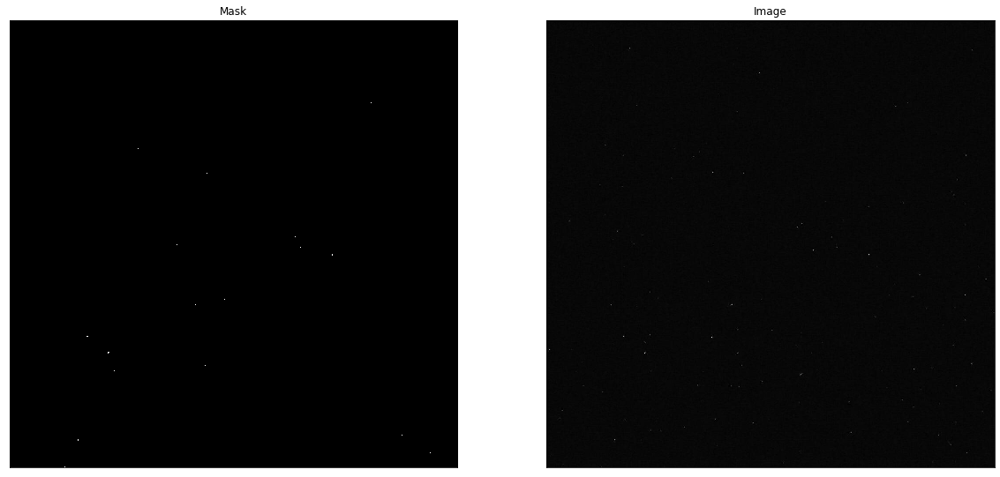

Index 39
INFO: Iteration 1: Found 30 cosmic-ray pixels, Total: 30 [unknown]


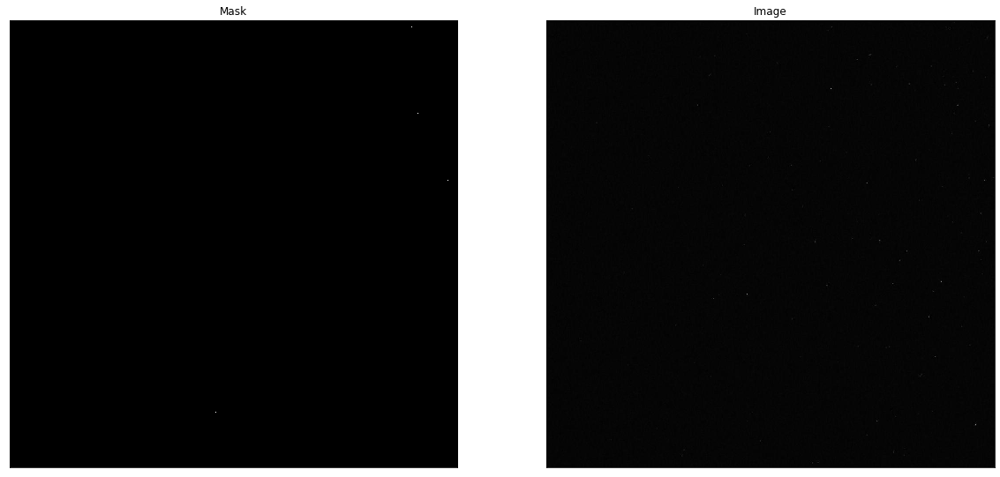

Index 40
INFO: Iteration 1: Found 27 cosmic-ray pixels, Total: 27 [unknown]


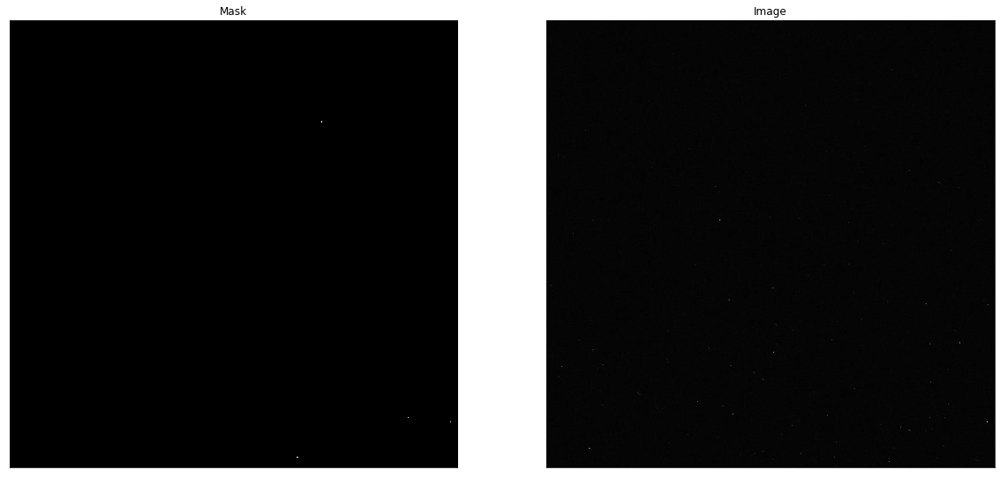

Index 41
INFO: Iteration 1: Found 58 cosmic-ray pixels, Total: 58 [unknown]


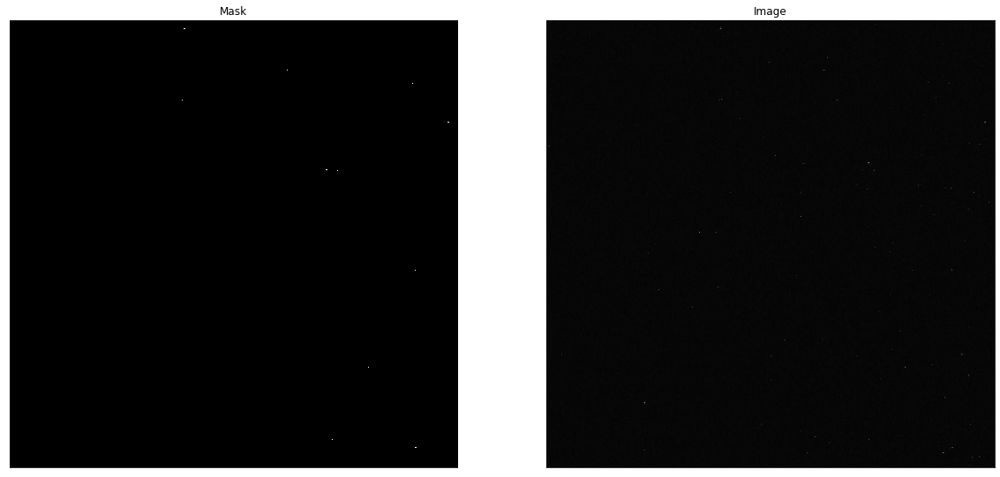

Index 42
INFO: Iteration 1: Found 59 cosmic-ray pixels, Total: 59 [unknown]


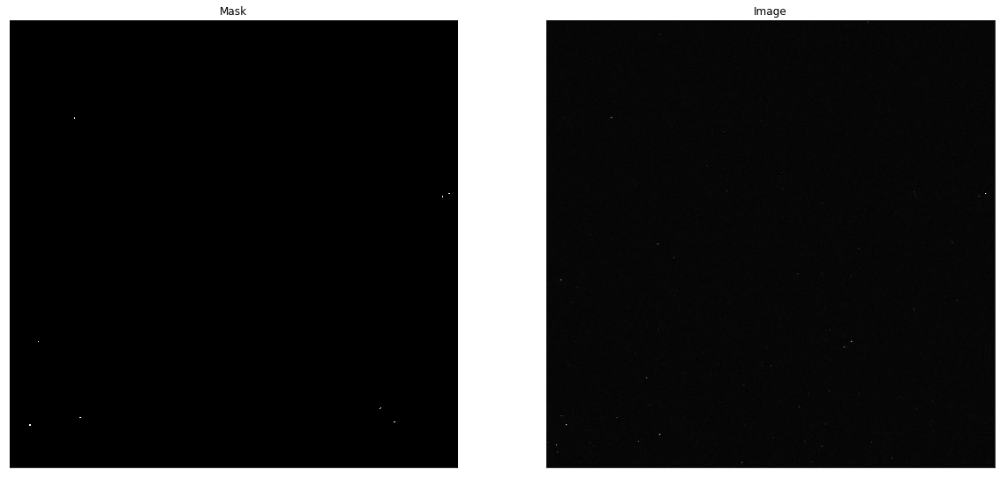

Index 43
INFO: Iteration 1: Found 59 cosmic-ray pixels, Total: 59 [unknown]


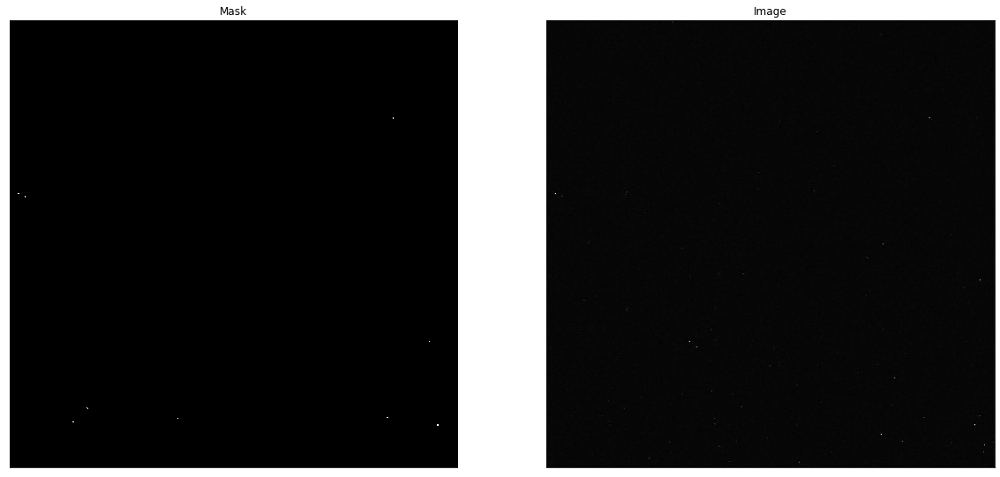

Index 44
INFO: Iteration 1: Found 70 cosmic-ray pixels, Total: 70 [unknown]


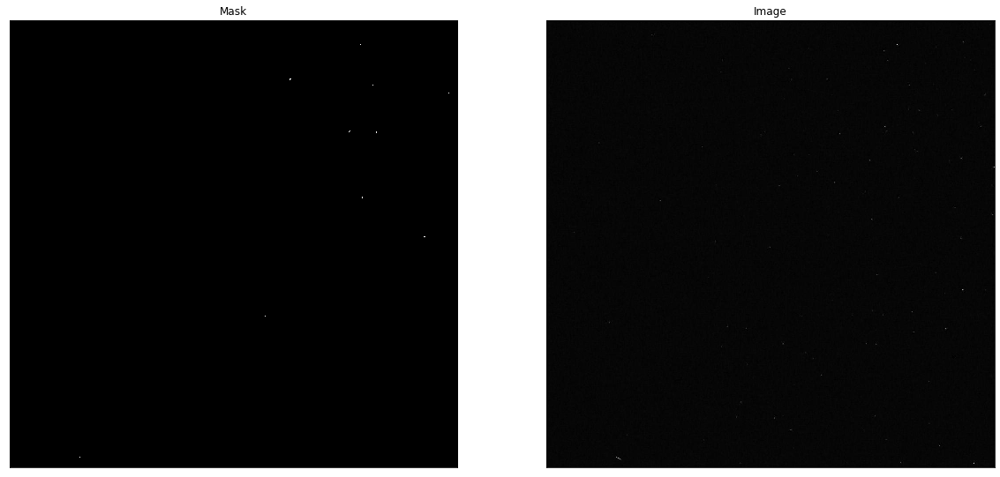

Index 45
INFO: Iteration 1: Found 87 cosmic-ray pixels, Total: 87 [unknown]


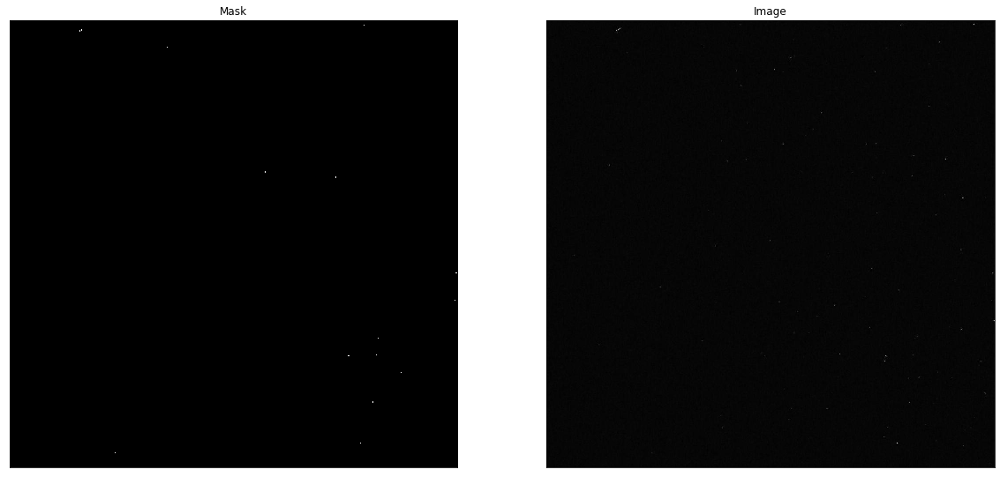

Index 46
INFO: Iteration 1: Found 83 cosmic-ray pixels, Total: 83 [unknown]


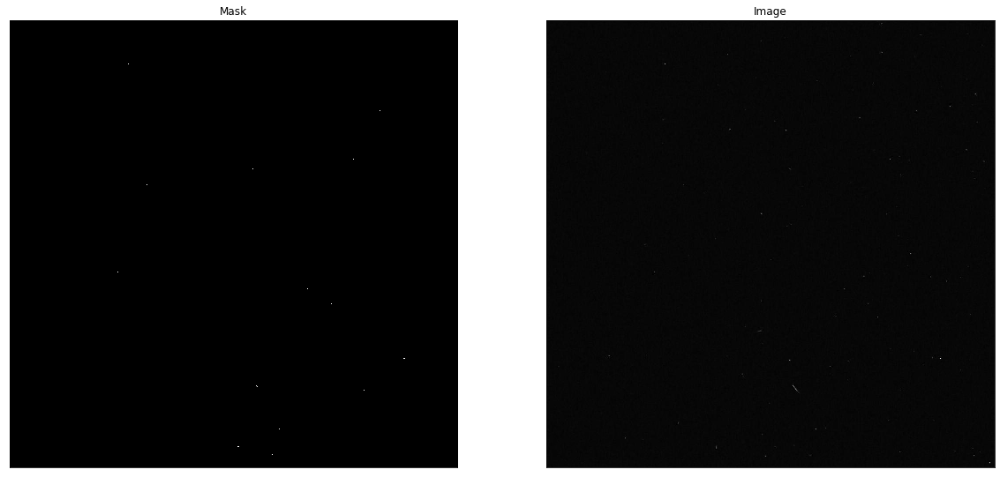

Index 47
INFO: Iteration 1: Found 87 cosmic-ray pixels, Total: 87 [unknown]


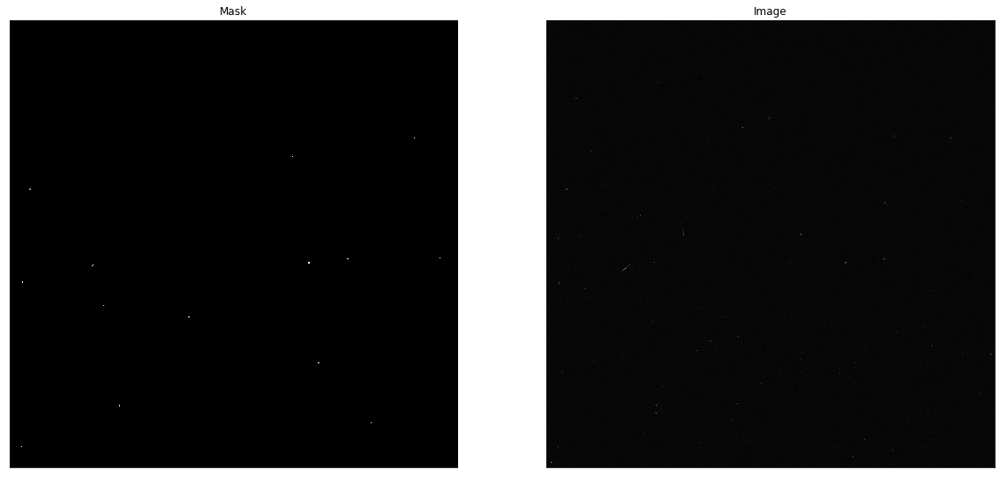

Index 48
INFO: Iteration 1: Found 66 cosmic-ray pixels, Total: 66 [unknown]


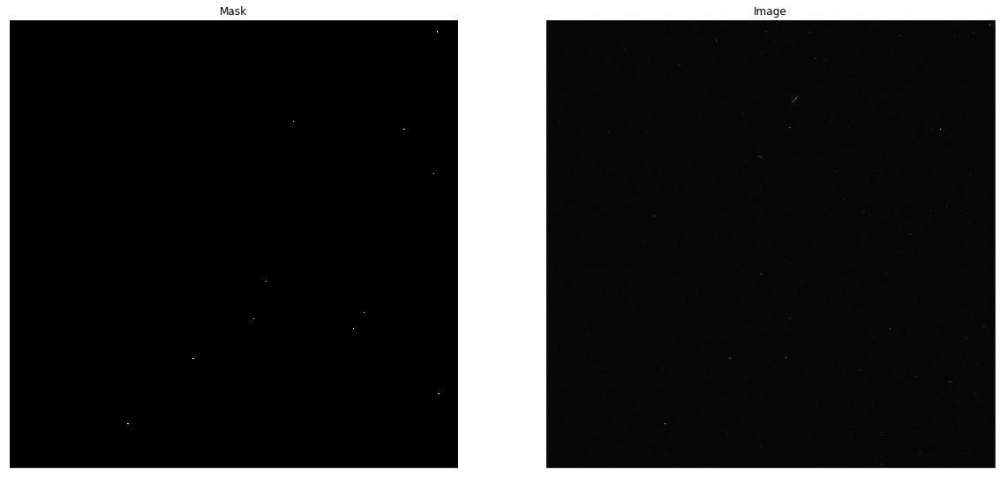

Index 49
INFO: Iteration 1: Found 18 cosmic-ray pixels, Total: 18 [unknown]


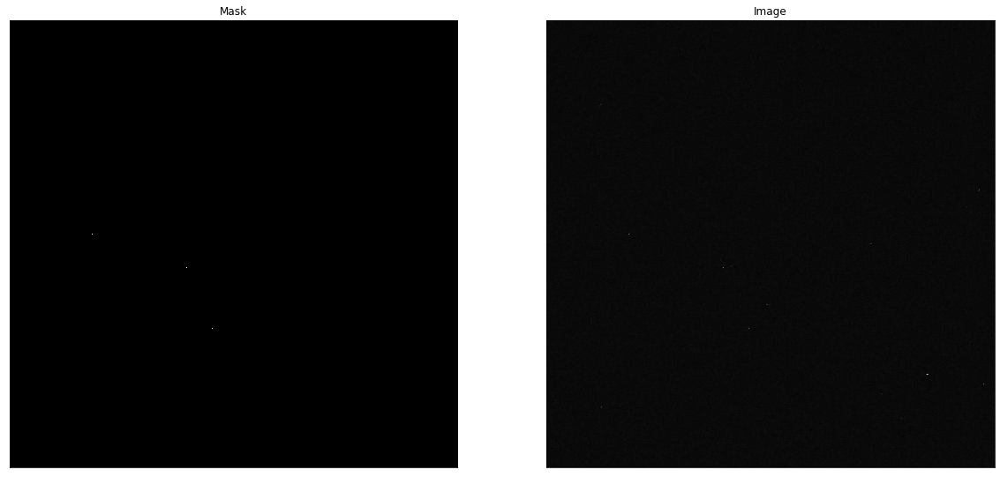

Index 50
INFO: Iteration 1: Found 18 cosmic-ray pixels, Total: 18 [unknown]


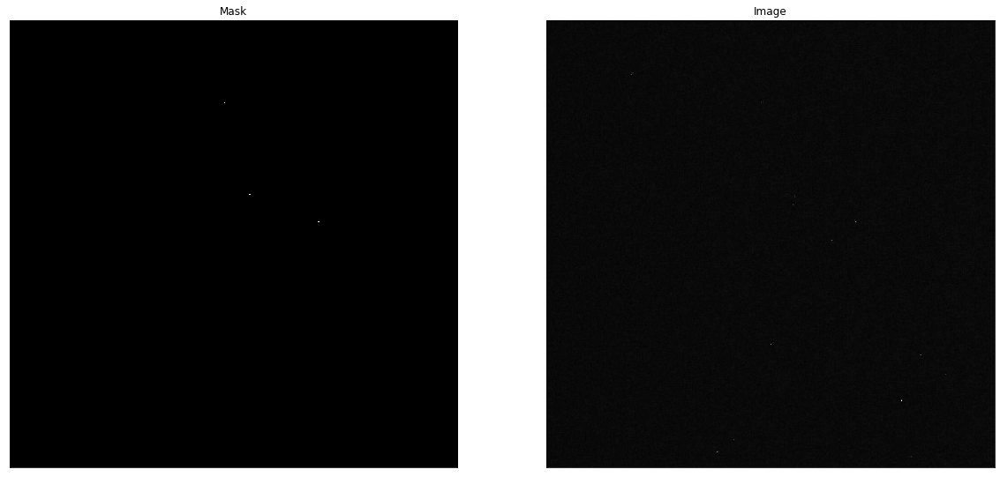

Index 51
INFO: Iteration 1: Found 18 cosmic-ray pixels, Total: 18 [unknown]


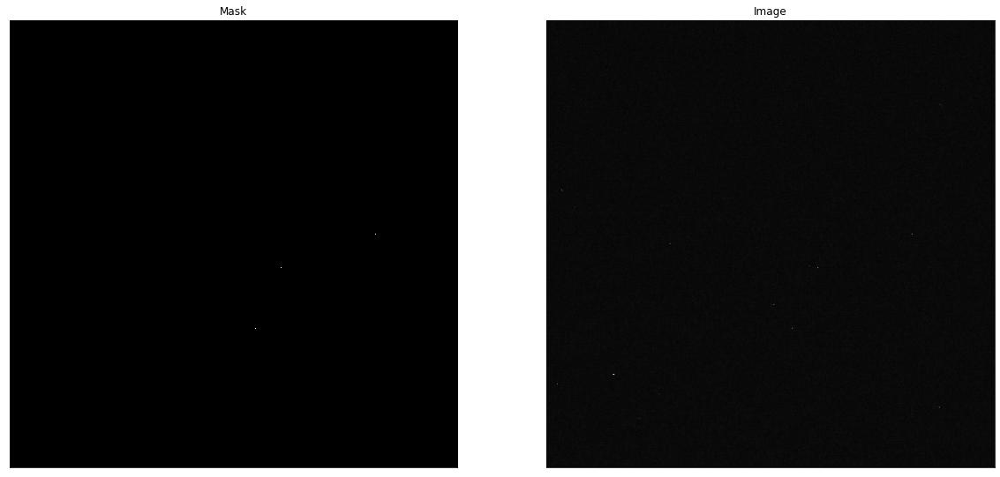

Index 52
INFO: Iteration 1: Found 32 cosmic-ray pixels, Total: 32 [unknown]


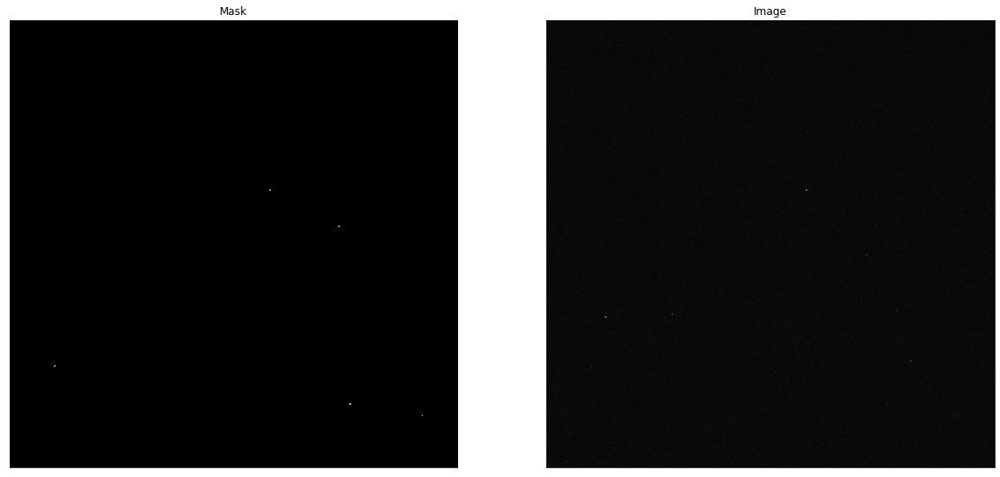

Index 53
INFO: Iteration 1: Found 34 cosmic-ray pixels, Total: 34 [unknown]


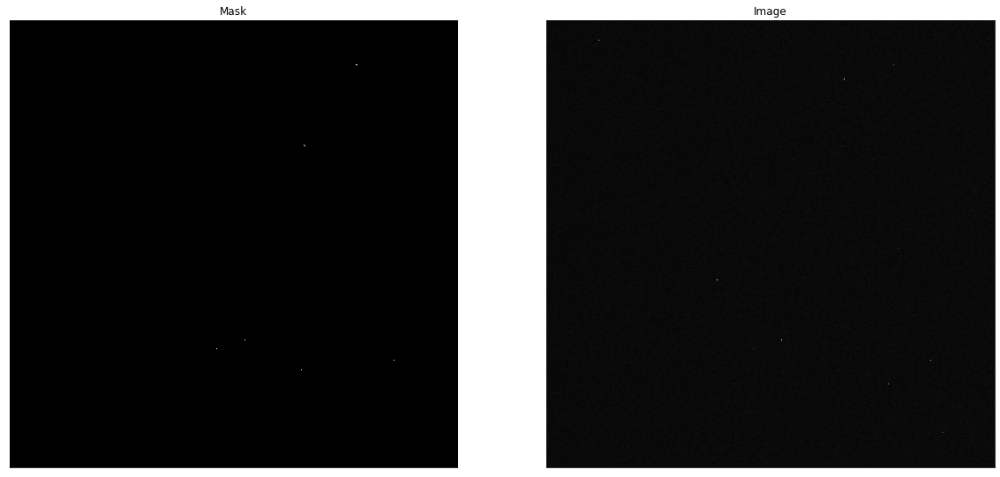

Index 54
INFO: Iteration 1: Found 17 cosmic-ray pixels, Total: 17 [unknown]


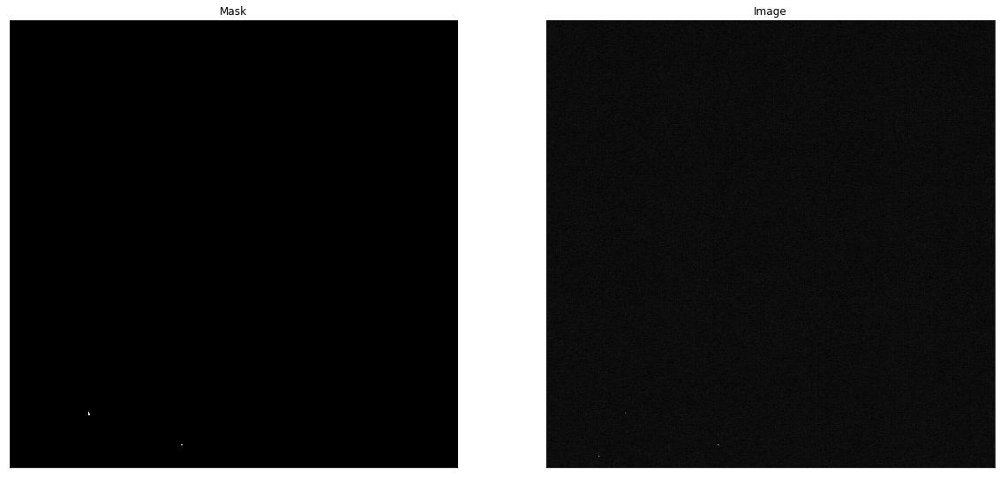

Index 55
INFO: Iteration 1: Found 6 cosmic-ray pixels, Total: 6 [unknown]


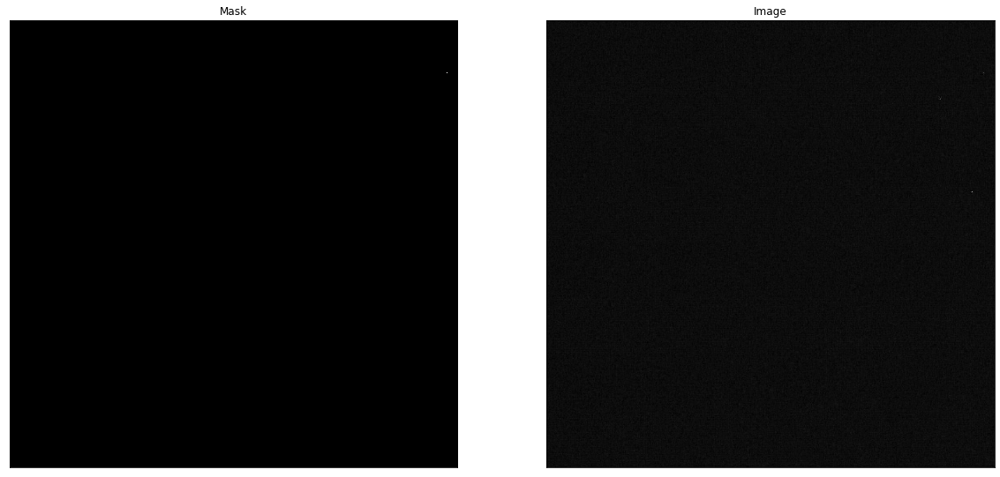

Index 56
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


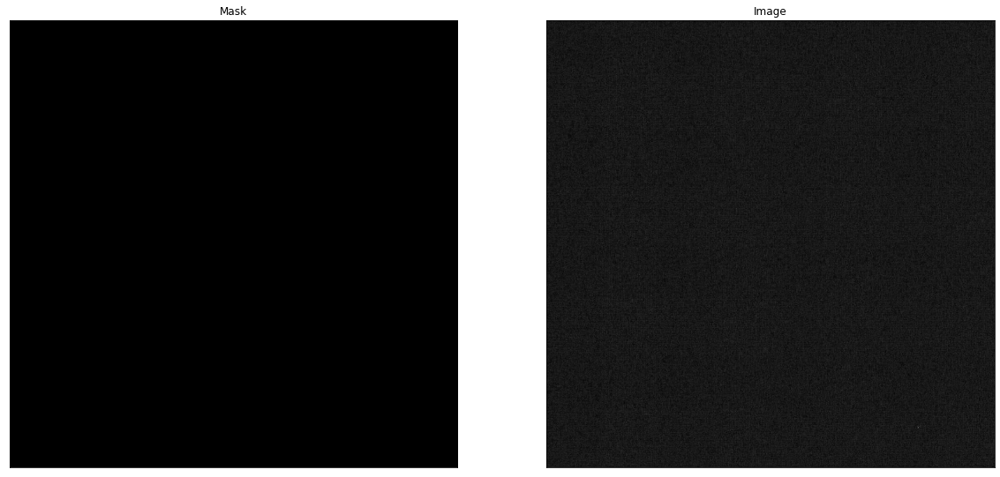

Index 57
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


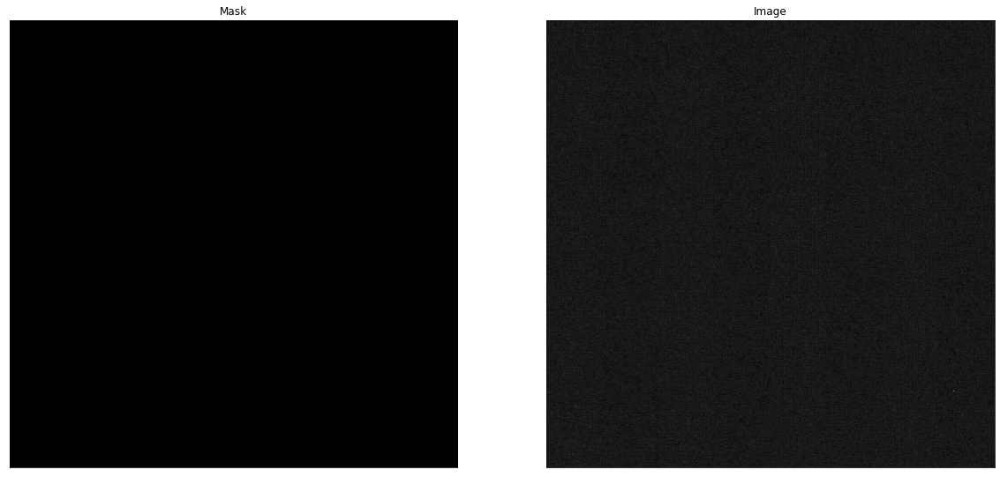

Index 58
INFO: Iteration 1: Found 13 cosmic-ray pixels, Total: 13 [unknown]


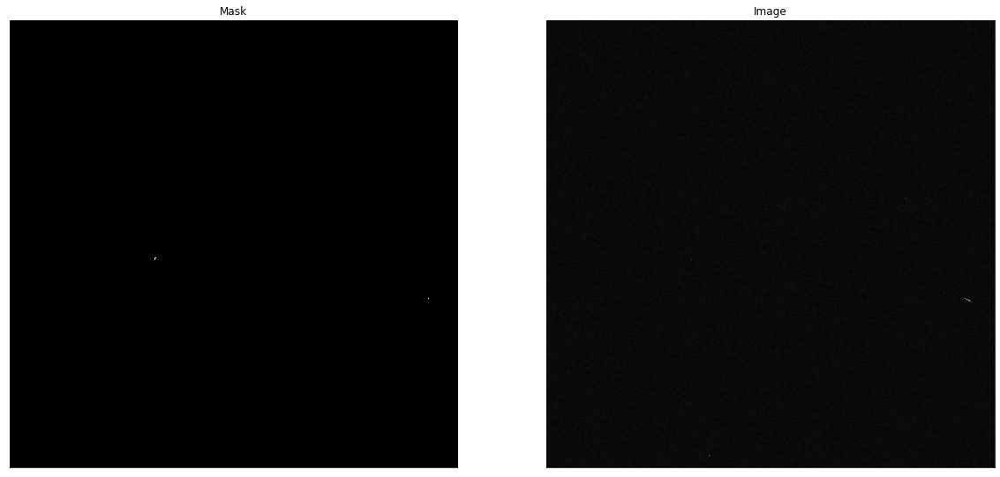

Index 59
INFO: Iteration 1: Found 10 cosmic-ray pixels, Total: 10 [unknown]


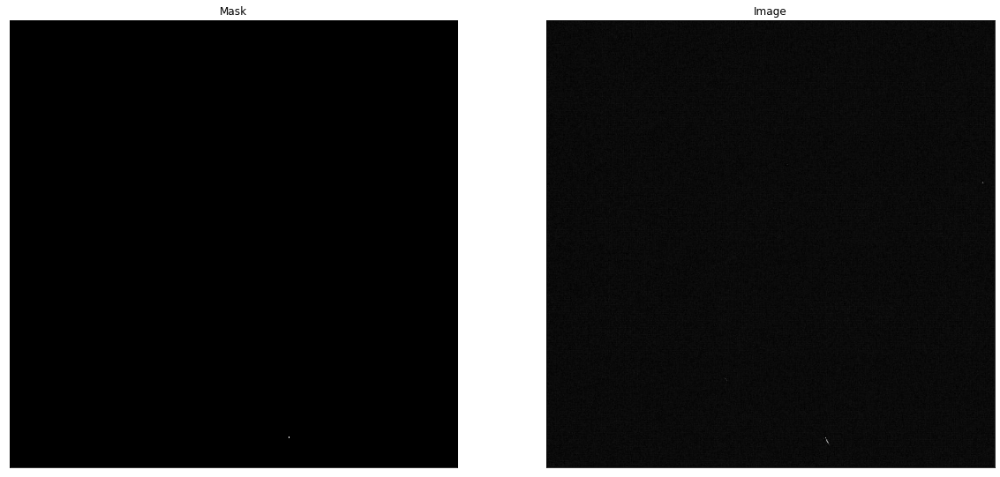

Index 60
INFO: Iteration 1: Found 17 cosmic-ray pixels, Total: 17 [unknown]


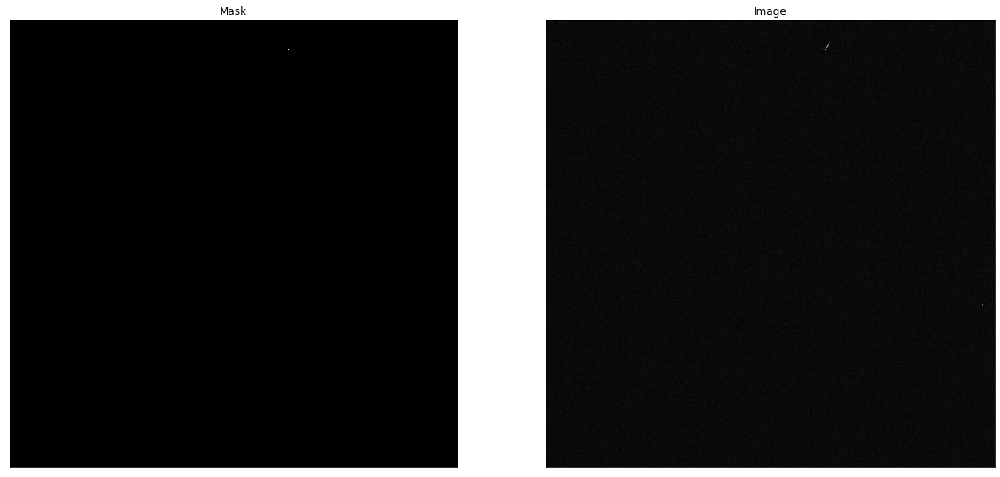

Index 61
INFO: Iteration 1: Found 6 cosmic-ray pixels, Total: 6 [unknown]


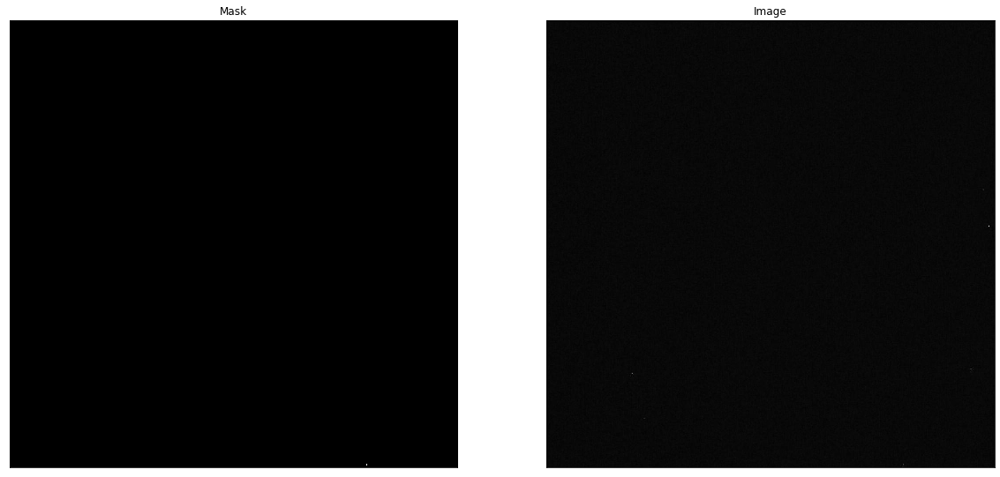

Index 62
INFO: Iteration 1: Found 16 cosmic-ray pixels, Total: 16 [unknown]


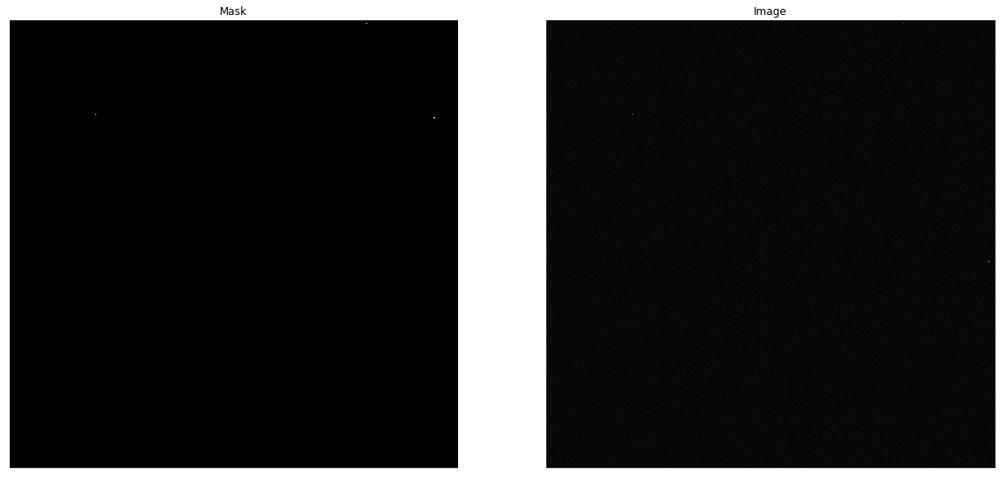

Index 63
INFO: Iteration 1: Found 116 cosmic-ray pixels, Total: 116 [unknown]


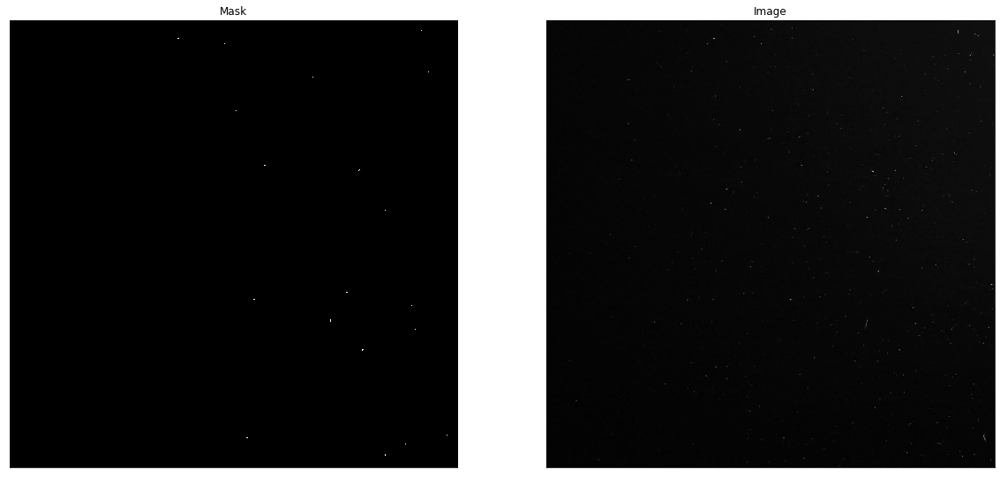

Index 64
INFO: Iteration 1: Found 90 cosmic-ray pixels, Total: 90 [unknown]


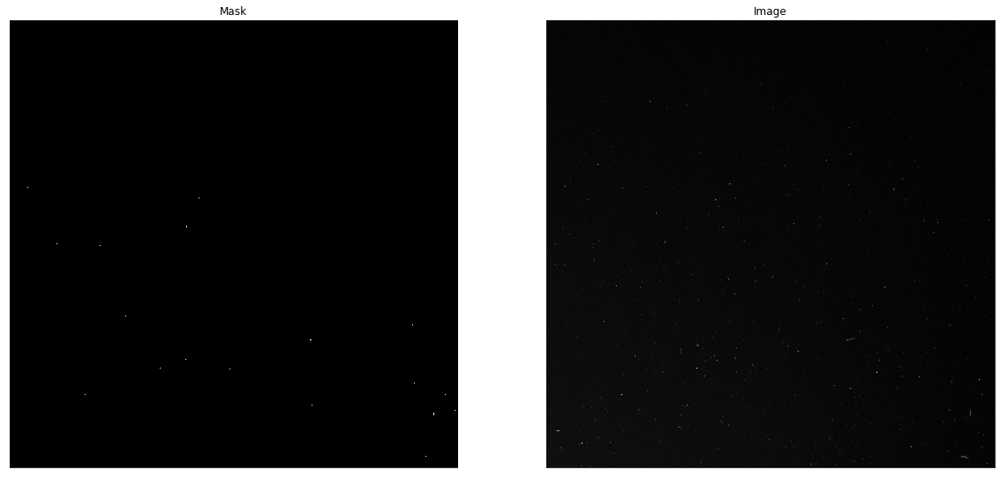

Index 65
INFO: Iteration 1: Found 135 cosmic-ray pixels, Total: 135 [unknown]


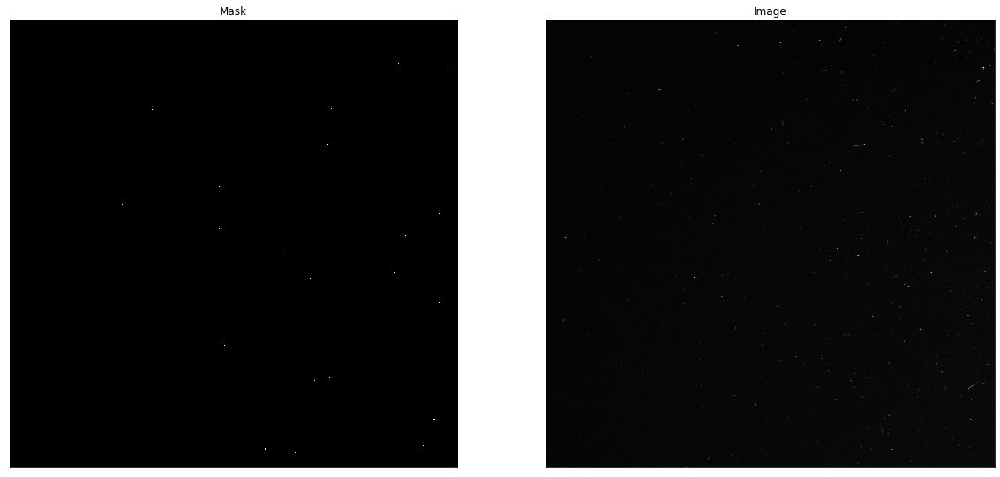

Index 66
INFO: Iteration 1: Found 128 cosmic-ray pixels, Total: 128 [unknown]


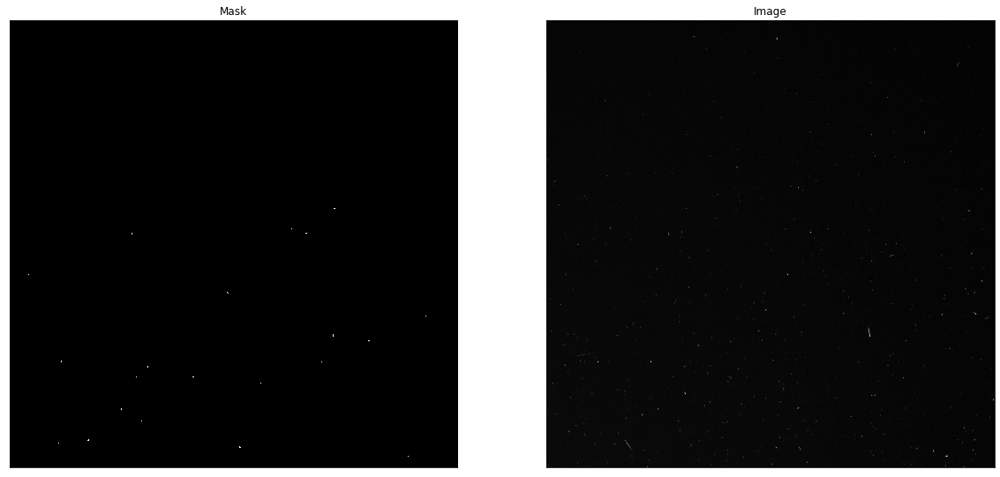

Index 67
INFO: Iteration 1: Found 123 cosmic-ray pixels, Total: 123 [unknown]


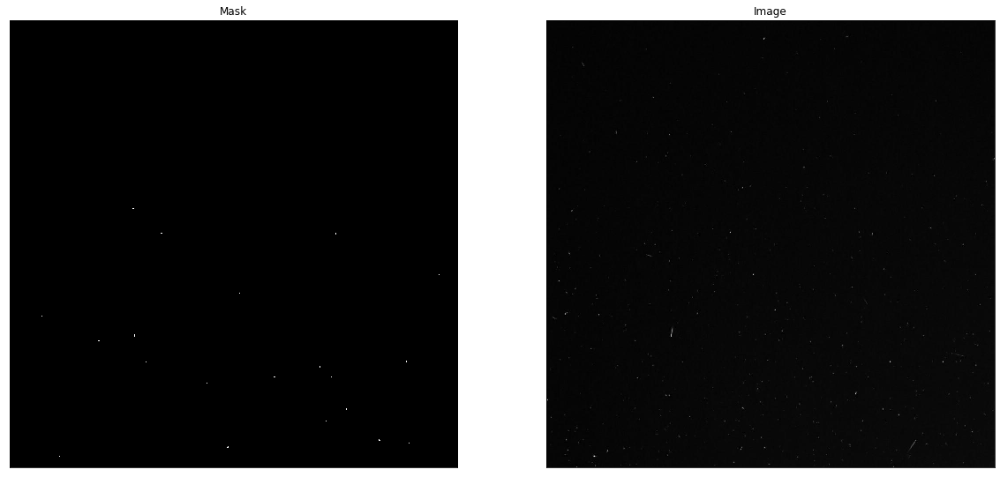

Index 68
INFO: Iteration 1: Found 98 cosmic-ray pixels, Total: 98 [unknown]


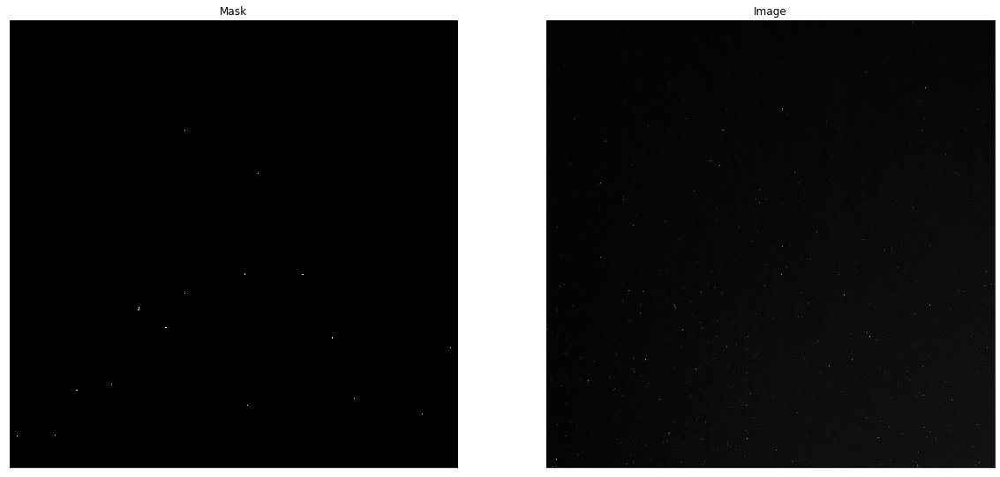

Index 69
INFO: Iteration 1: Found 174 cosmic-ray pixels, Total: 174 [unknown]


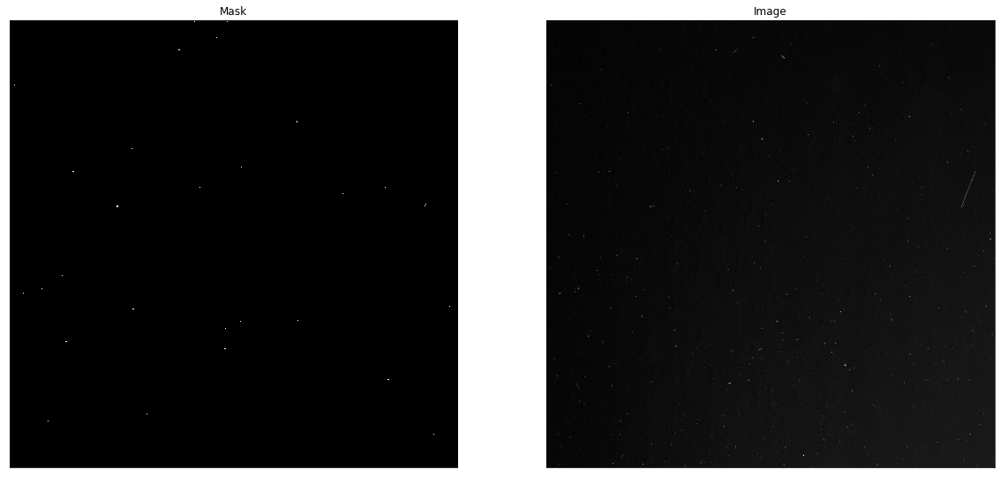

Index 70
INFO: Iteration 1: Found 140 cosmic-ray pixels, Total: 140 [unknown]


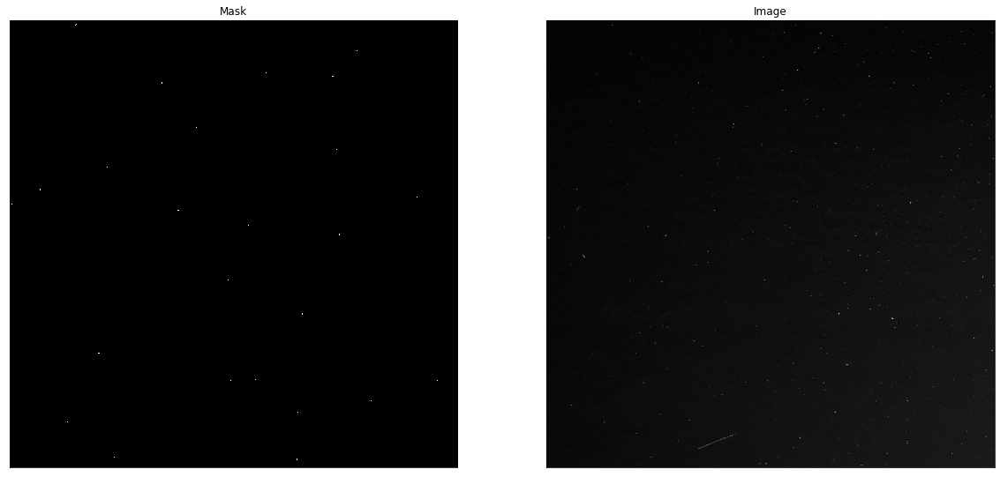

Index 71
INFO: Iteration 1: Found 174 cosmic-ray pixels, Total: 174 [unknown]


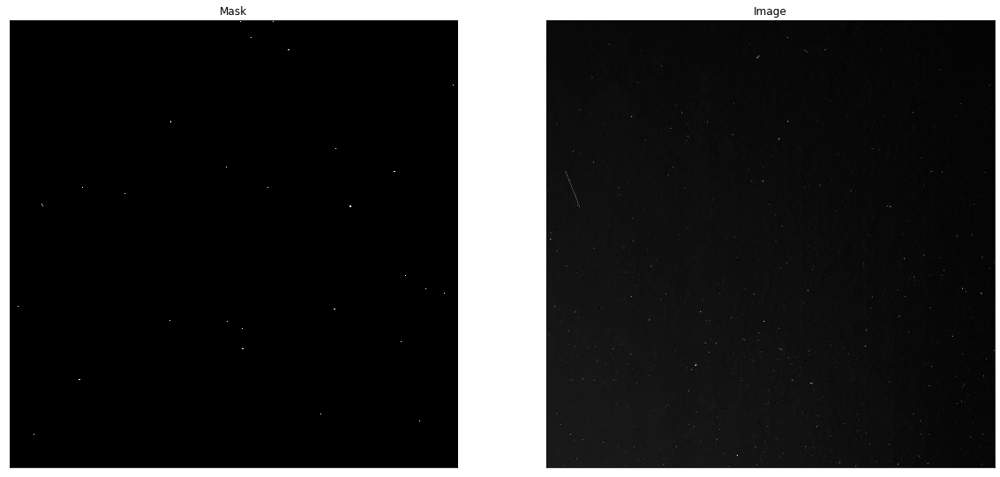

Index 72
INFO: Iteration 1: Found 117 cosmic-ray pixels, Total: 117 [unknown]


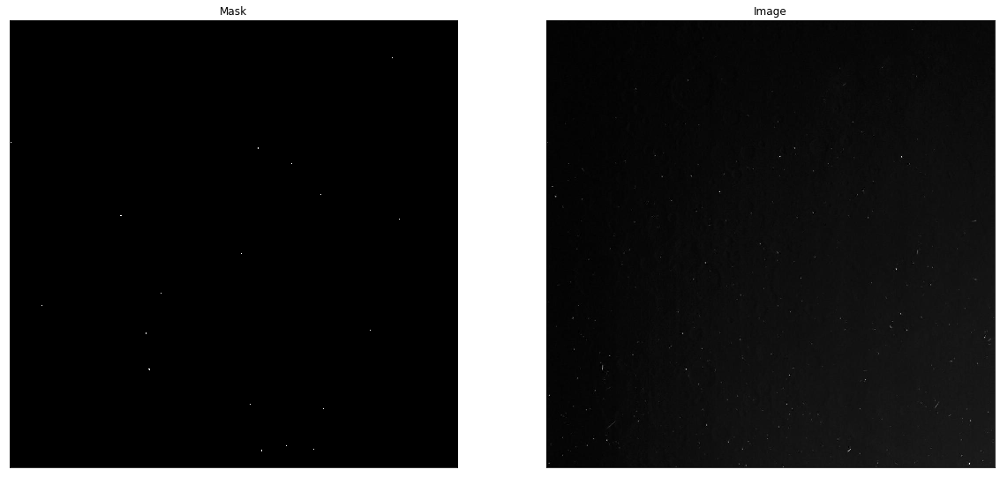

Index 73
INFO: Iteration 1: Found 149 cosmic-ray pixels, Total: 149 [unknown]


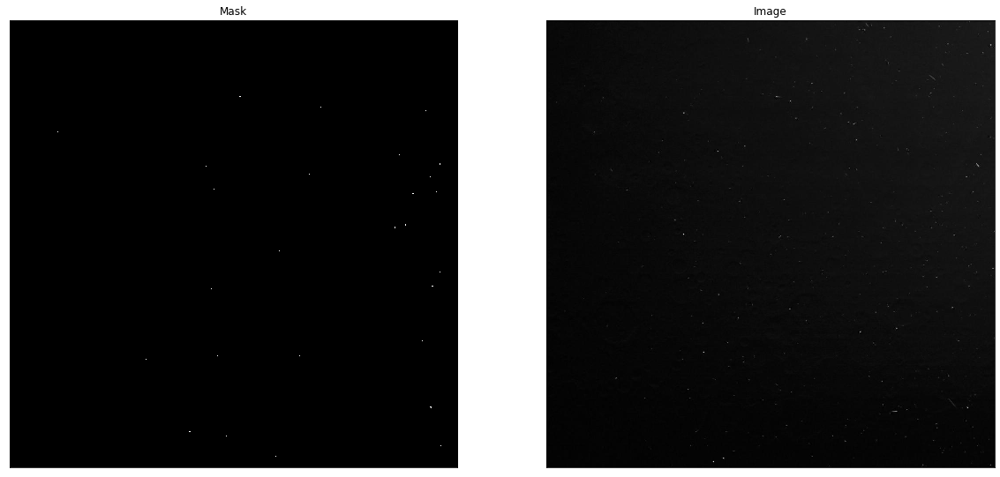

Index 74
INFO: Iteration 1: Found 115 cosmic-ray pixels, Total: 115 [unknown]


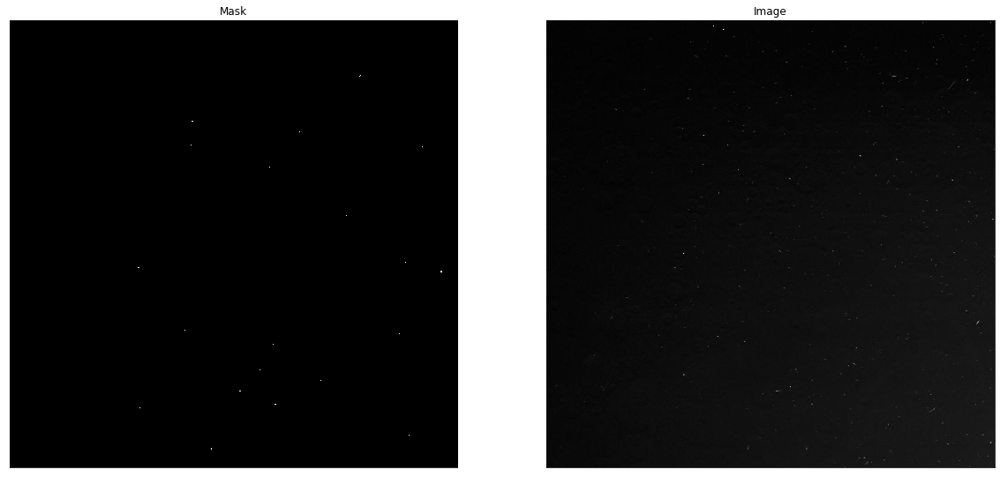

Index 75
INFO: Iteration 1: Found 137 cosmic-ray pixels, Total: 137 [unknown]


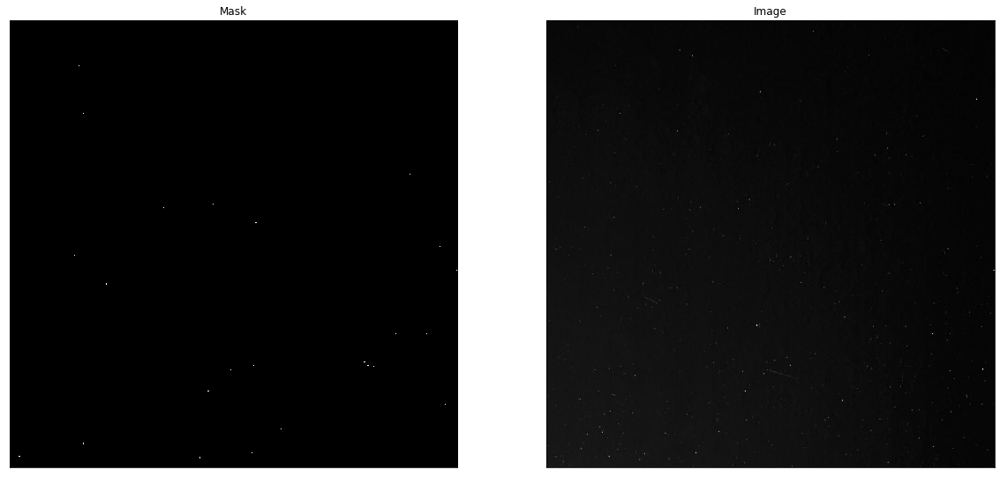

Index 76
INFO: Iteration 1: Found 137 cosmic-ray pixels, Total: 137 [unknown]


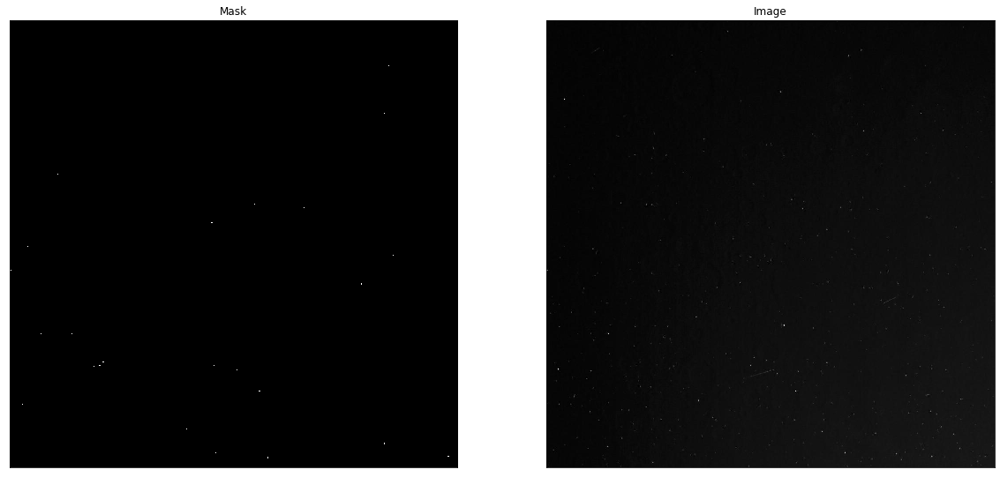

Index 77
INFO: Iteration 1: Found 108 cosmic-ray pixels, Total: 108 [unknown]


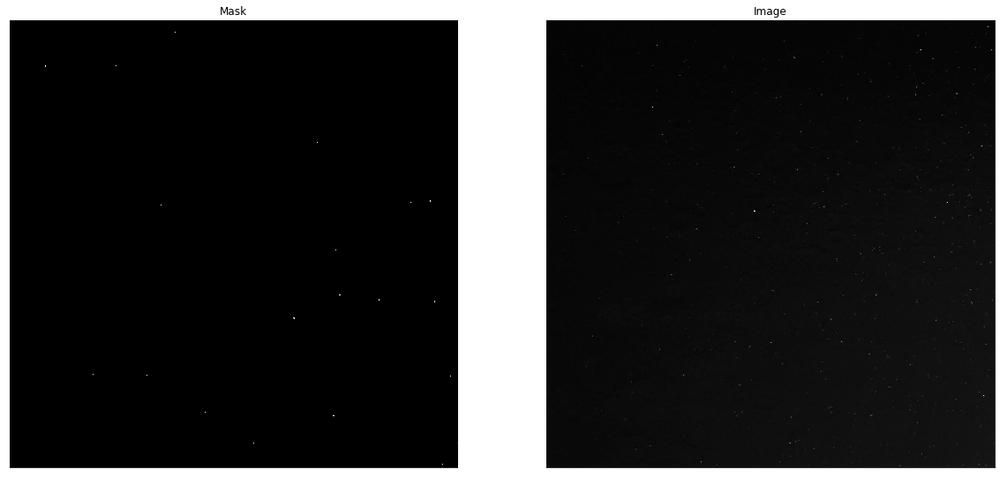

Index 78
INFO: Iteration 1: Found 114 cosmic-ray pixels, Total: 114 [unknown]


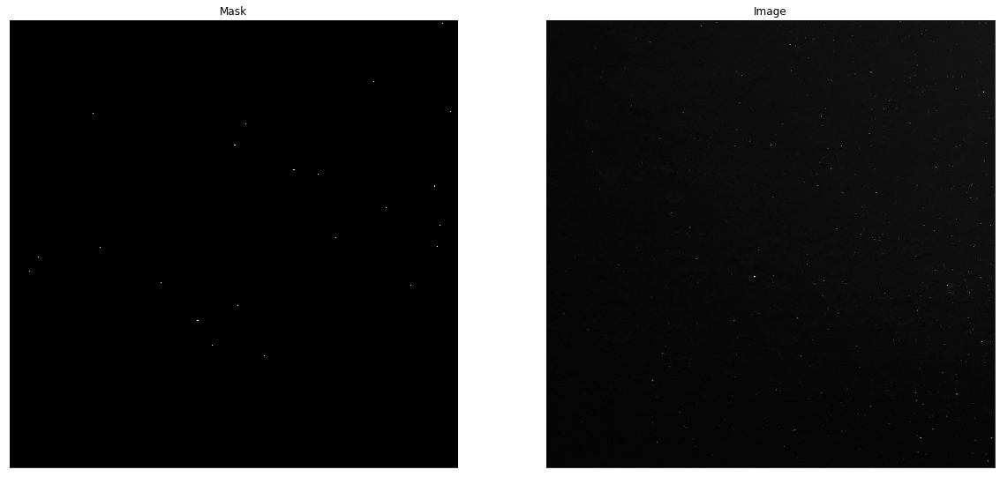

Index 79
INFO: Iteration 1: Found 115 cosmic-ray pixels, Total: 115 [unknown]


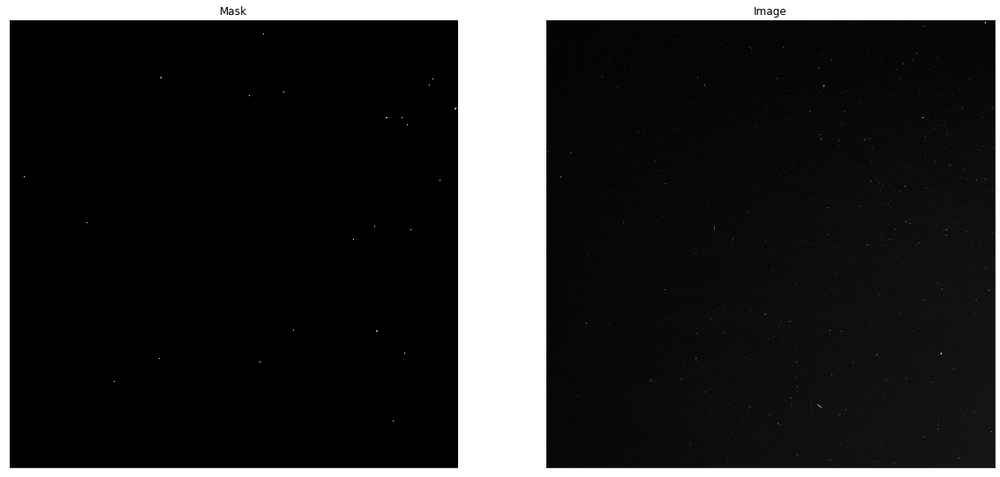

Index 80
INFO: Iteration 1: Found 97 cosmic-ray pixels, Total: 97 [unknown]


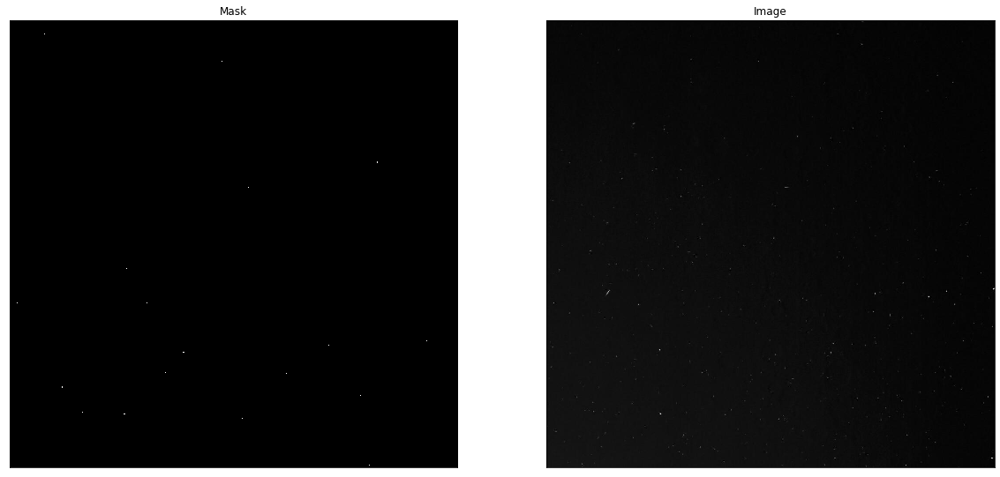

Index 81
INFO: Iteration 1: Found 97 cosmic-ray pixels, Total: 97 [unknown]


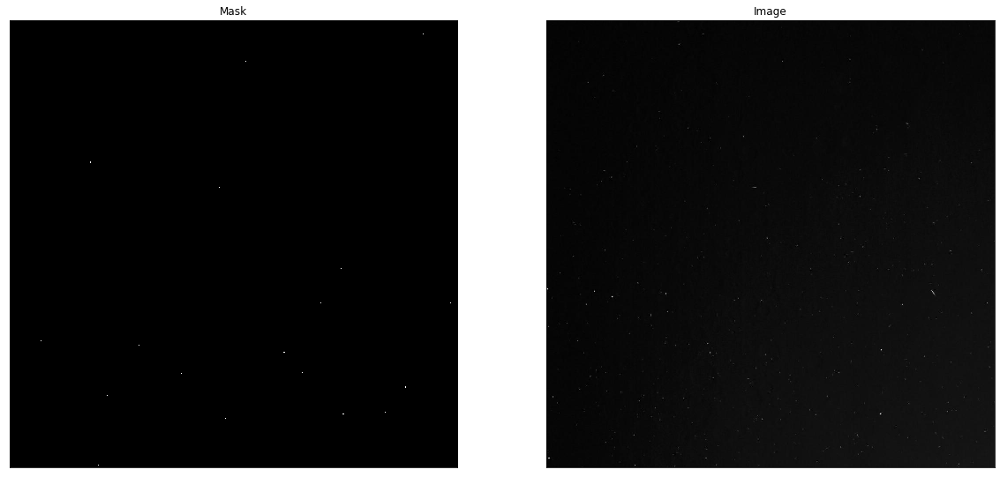

Index 82
INFO: Iteration 1: Found 138 cosmic-ray pixels, Total: 138 [unknown]


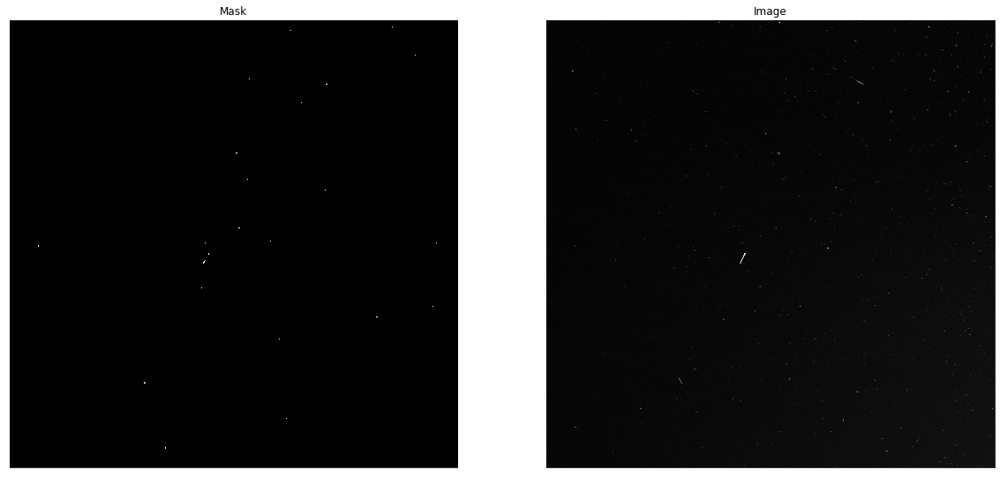

Index 83
INFO: Iteration 1: Found 176 cosmic-ray pixels, Total: 176 [unknown]


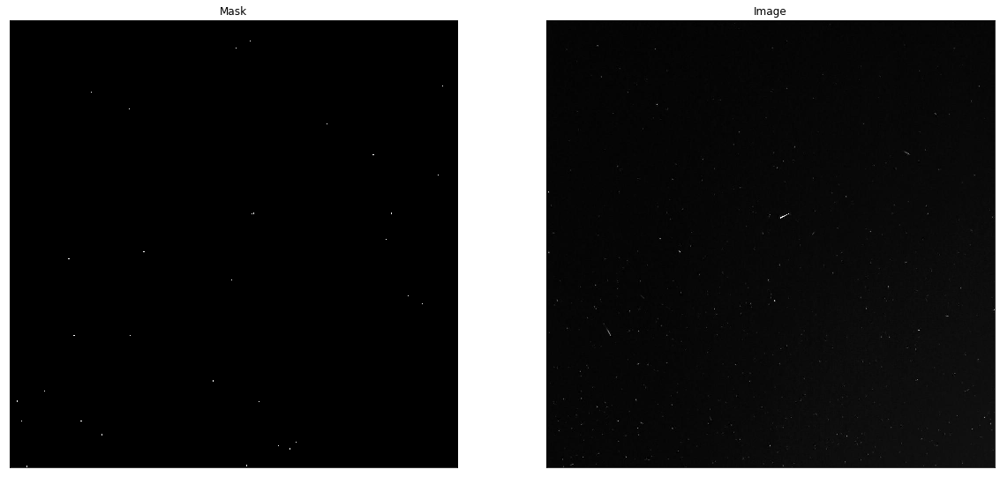

Index 84
INFO: Iteration 1: Found 130 cosmic-ray pixels, Total: 130 [unknown]


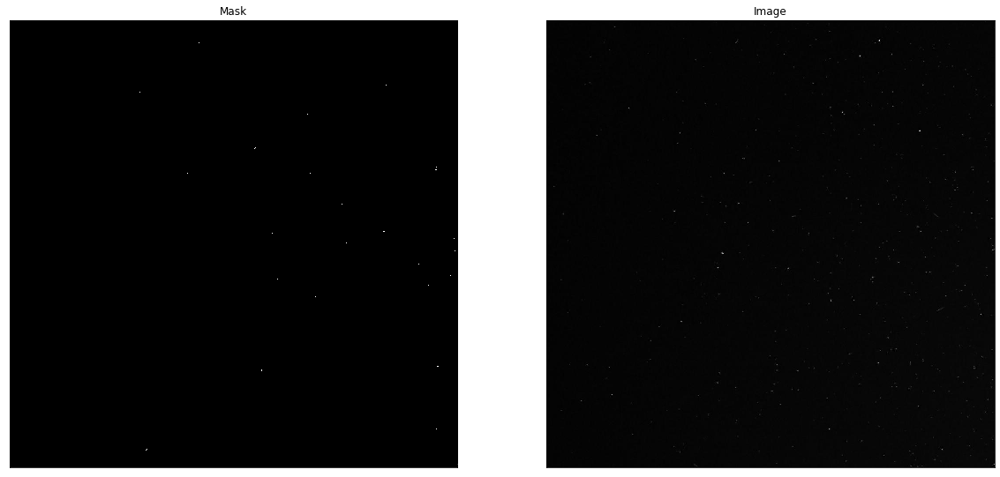

Index 85
INFO: Iteration 1: Found 193 cosmic-ray pixels, Total: 193 [unknown]


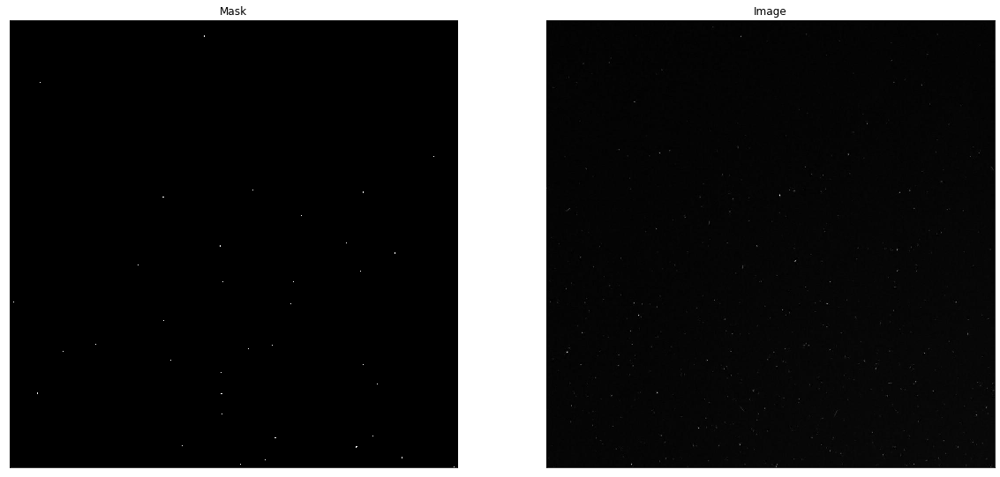

Index 86
INFO: Iteration 1: Found 193 cosmic-ray pixels, Total: 193 [unknown]


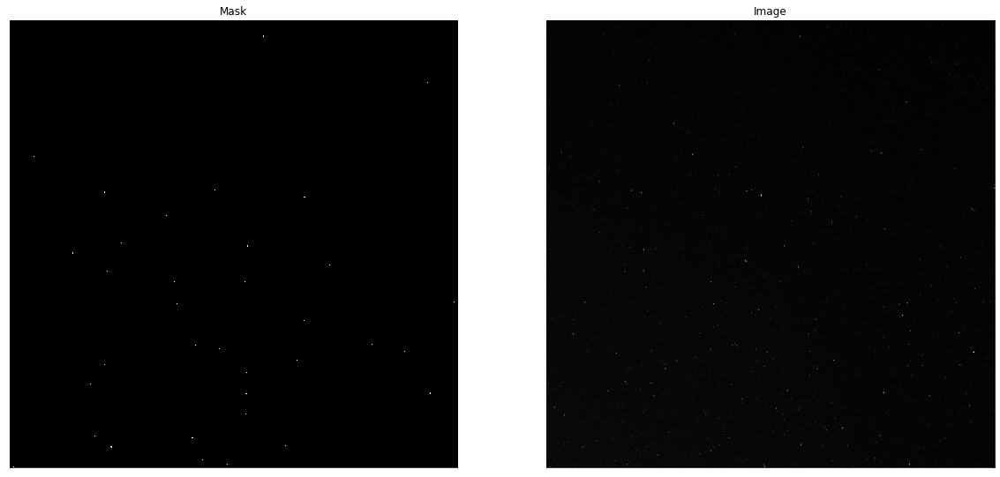

Index 87
INFO: Iteration 1: Found 181 cosmic-ray pixels, Total: 181 [unknown]


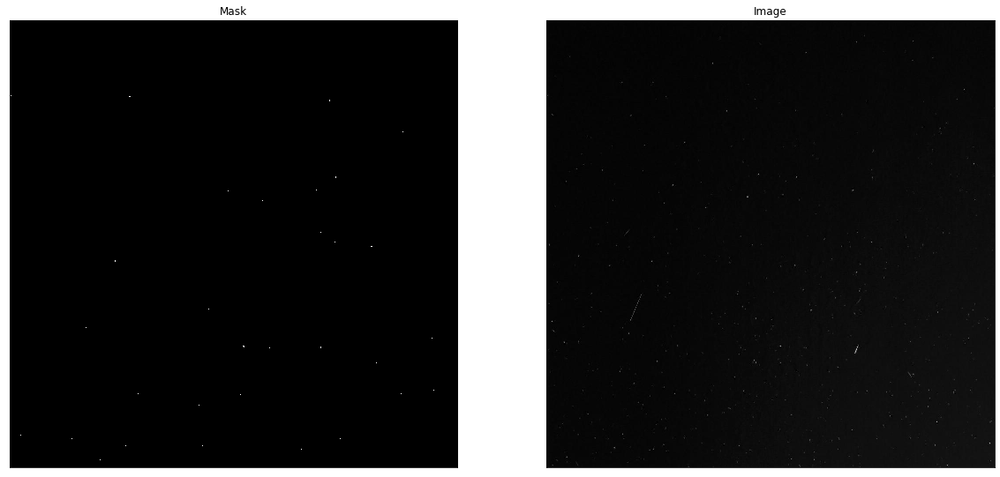

Index 88
INFO: Iteration 1: Found 165 cosmic-ray pixels, Total: 165 [unknown]


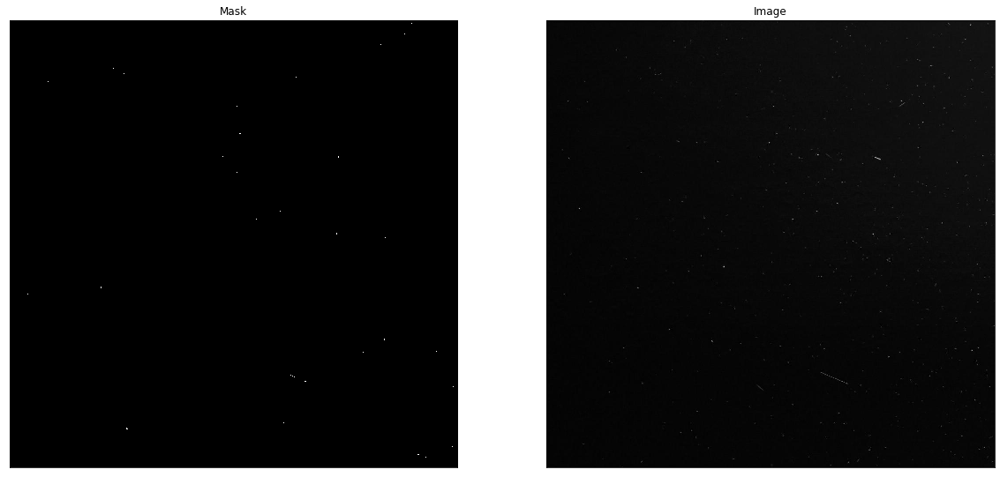

Index 89
INFO: Iteration 1: Found 181 cosmic-ray pixels, Total: 181 [unknown]


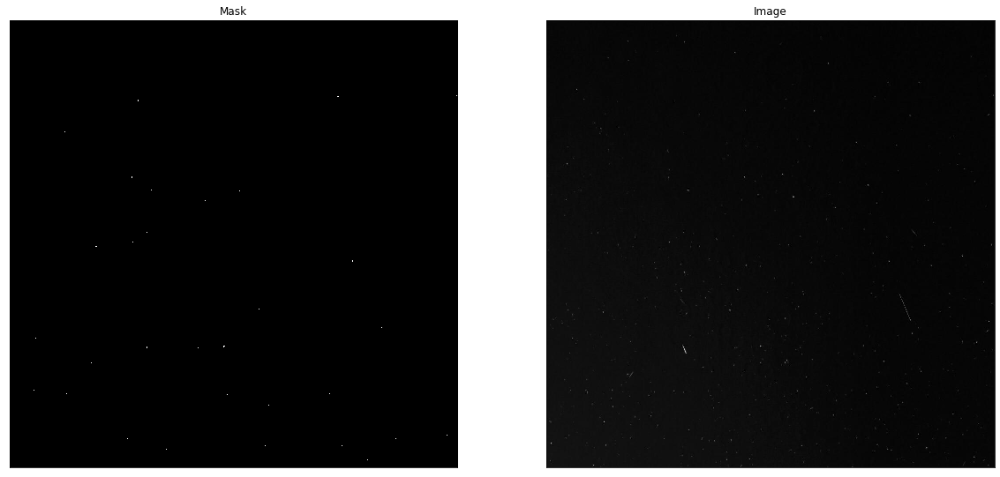

Index 90
INFO: Iteration 1: Found 100 cosmic-ray pixels, Total: 100 [unknown]


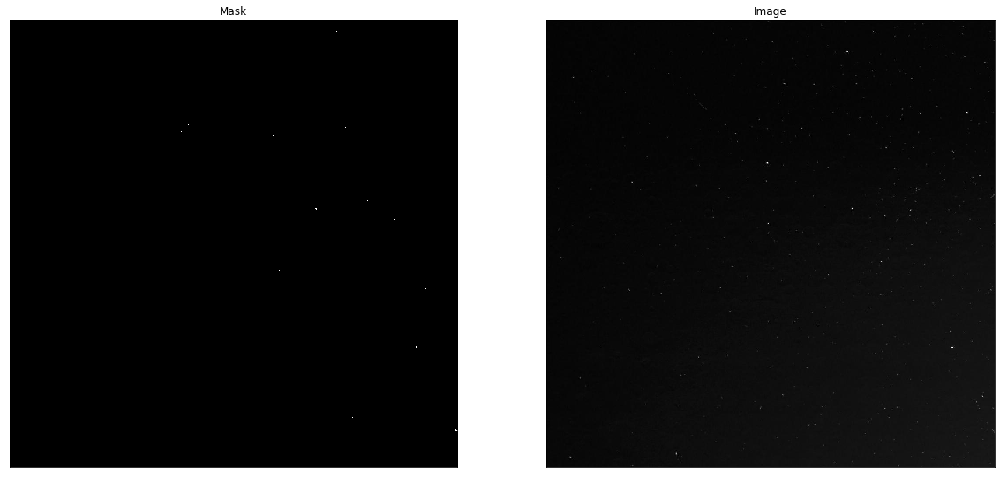

Index 91
INFO: Iteration 1: Found 105 cosmic-ray pixels, Total: 105 [unknown]


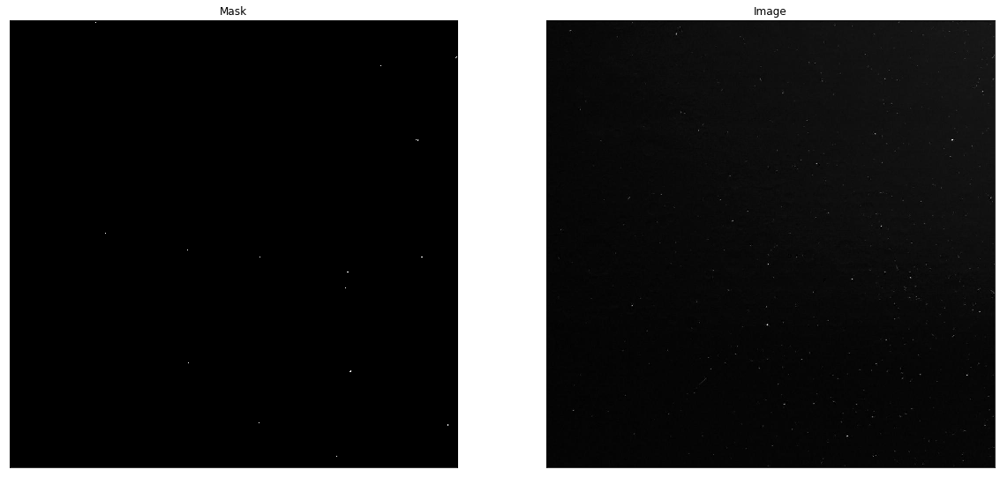

Index 92
INFO: Iteration 1: Found 114 cosmic-ray pixels, Total: 114 [unknown]


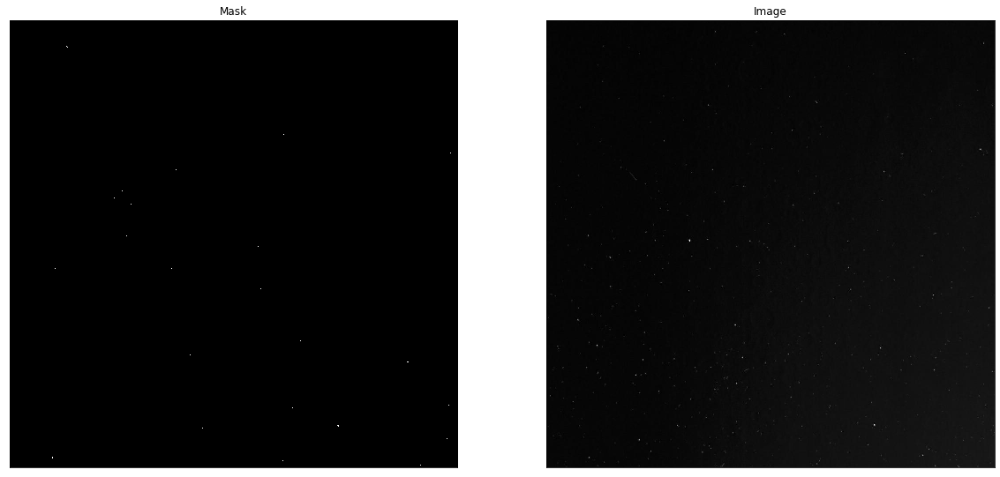

Index 93
INFO: Iteration 1: Found 86 cosmic-ray pixels, Total: 86 [unknown]


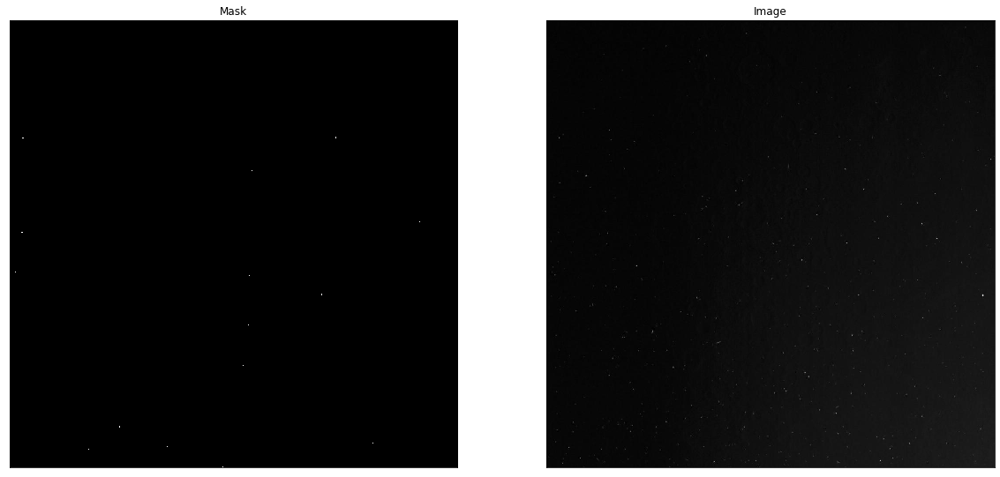

Index 94
INFO: Iteration 1: Found 102 cosmic-ray pixels, Total: 102 [unknown]


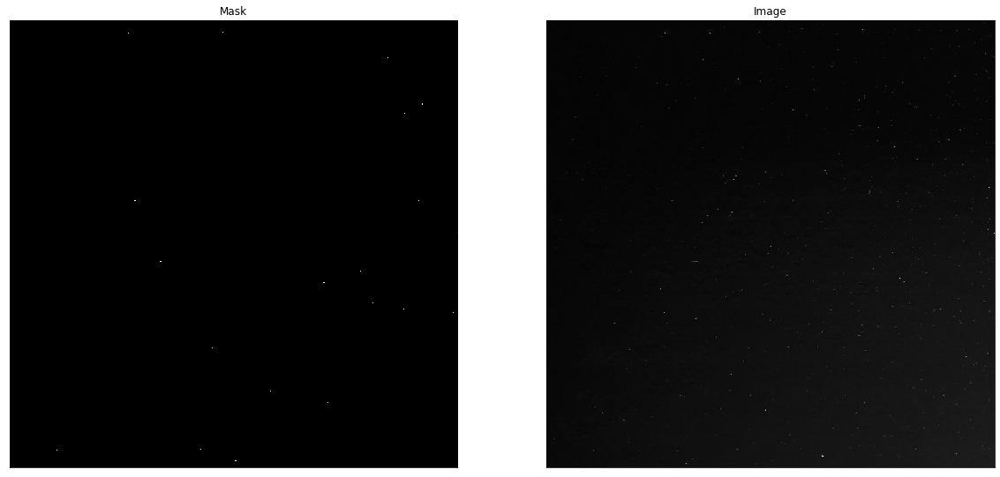

Index 95
INFO: Iteration 1: Found 147 cosmic-ray pixels, Total: 147 [unknown]


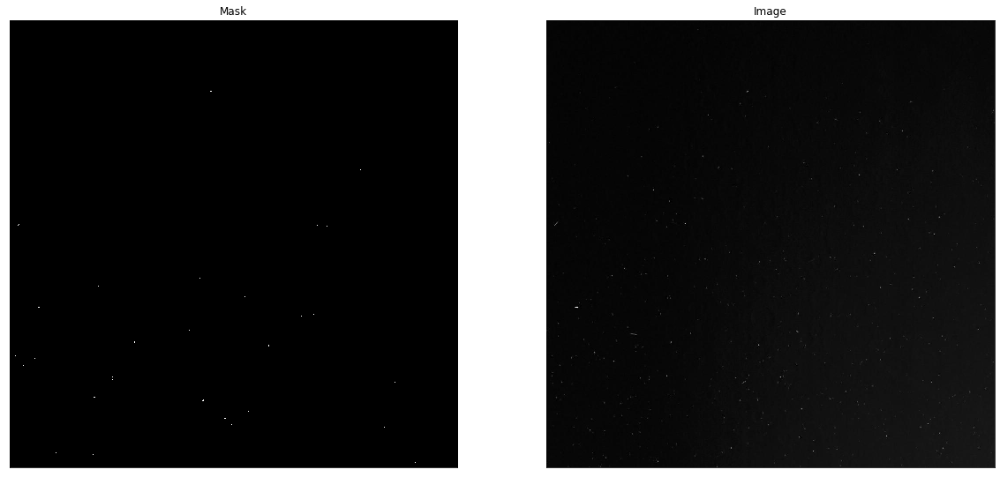

Index 96
INFO: Iteration 1: Found 119 cosmic-ray pixels, Total: 119 [unknown]


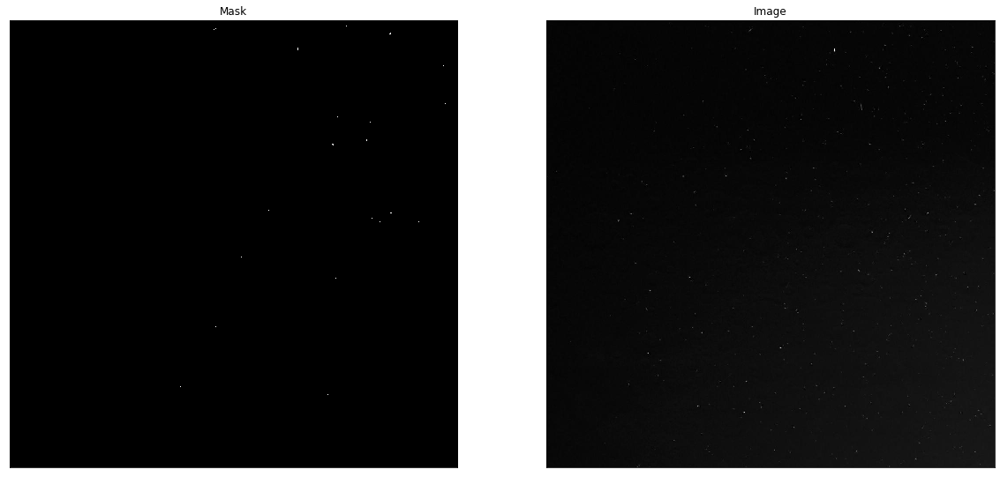

Index 97
INFO: Iteration 1: Found 134 cosmic-ray pixels, Total: 134 [unknown]


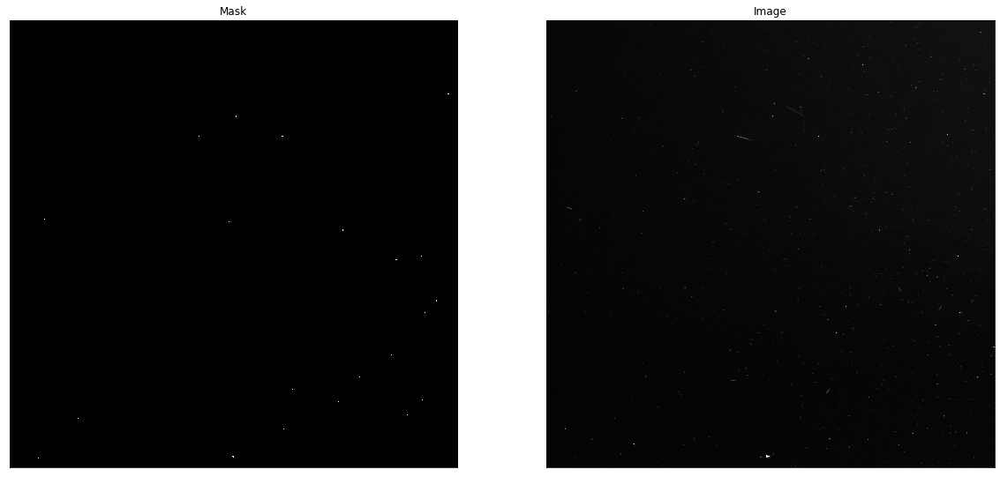

Index 98
INFO: Iteration 1: Found 157 cosmic-ray pixels, Total: 157 [unknown]


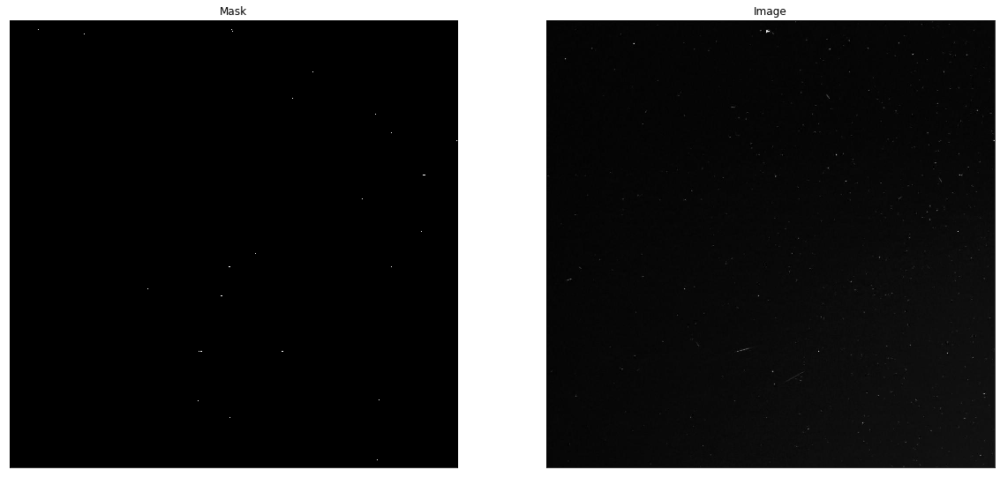

Index 99
INFO: Iteration 1: Found 152 cosmic-ray pixels, Total: 152 [unknown]


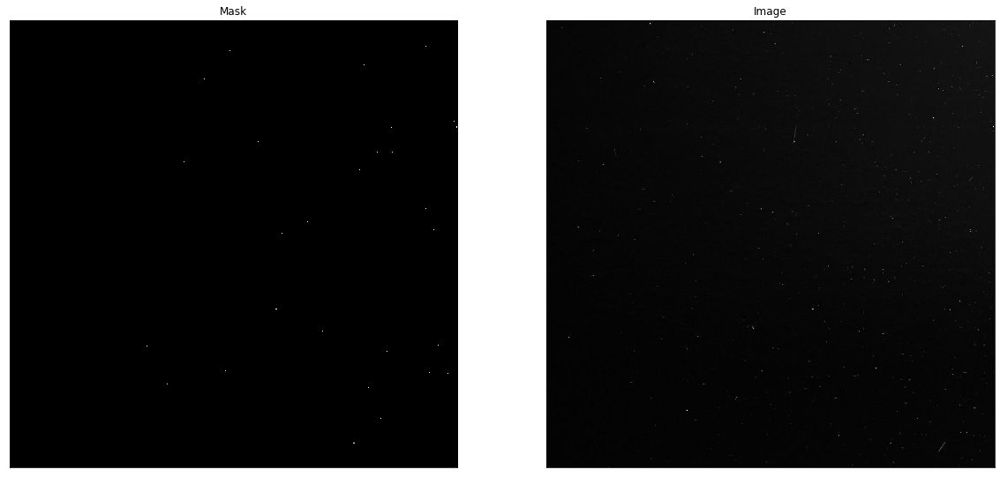

Index 100
INFO: Iteration 1: Found 199 cosmic-ray pixels, Total: 199 [unknown]


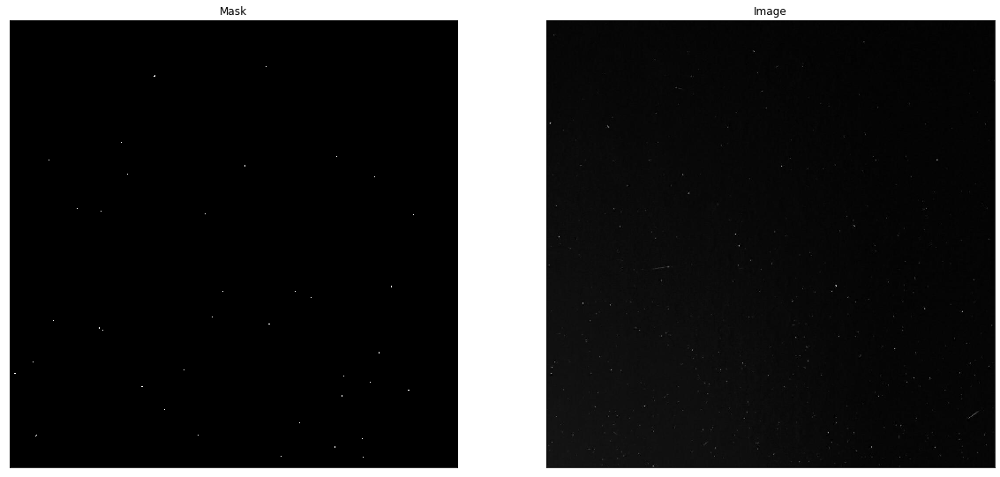

Index 101
INFO: Iteration 1: Found 175 cosmic-ray pixels, Total: 175 [unknown]


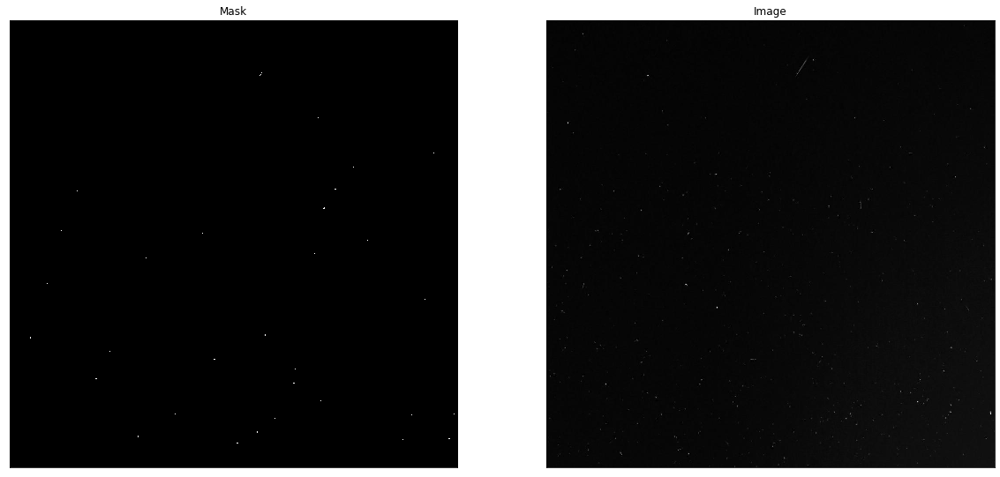

Index 102
INFO: Iteration 1: Found 164 cosmic-ray pixels, Total: 164 [unknown]


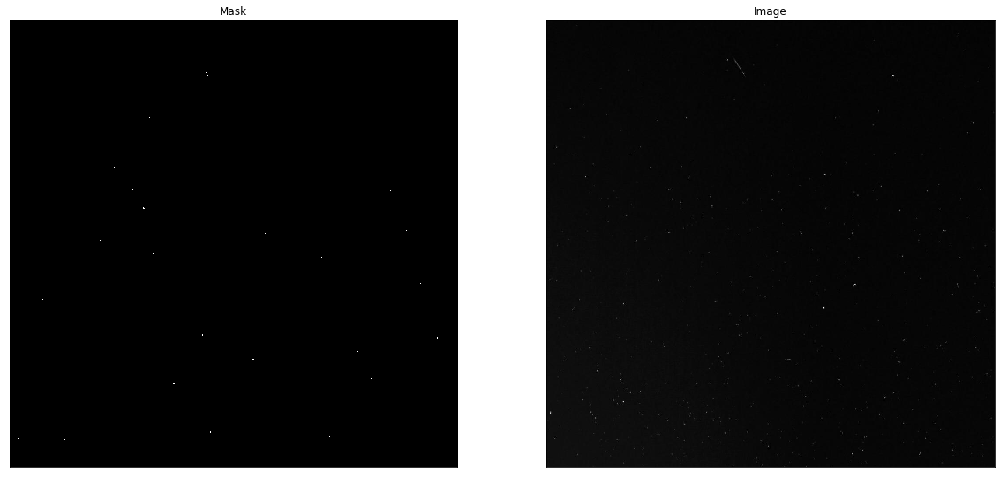

Index 103
INFO: Iteration 1: Found 124 cosmic-ray pixels, Total: 124 [unknown]


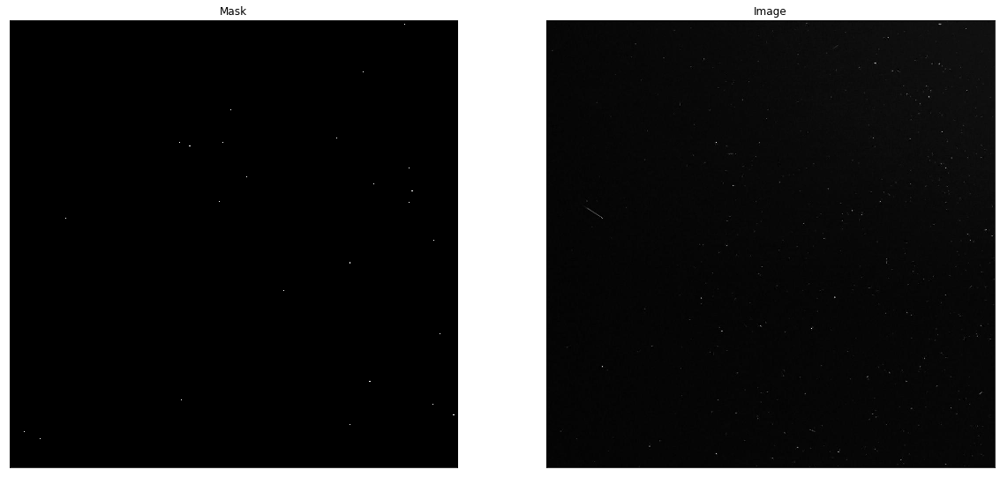

Index 104
INFO: Iteration 1: Found 129 cosmic-ray pixels, Total: 129 [unknown]


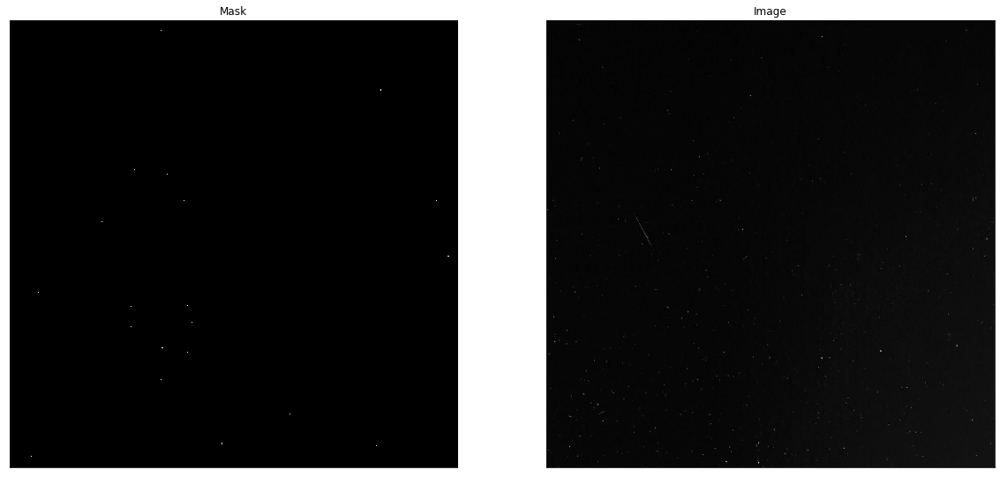

Index 105
INFO: Iteration 1: Found 164 cosmic-ray pixels, Total: 164 [unknown]


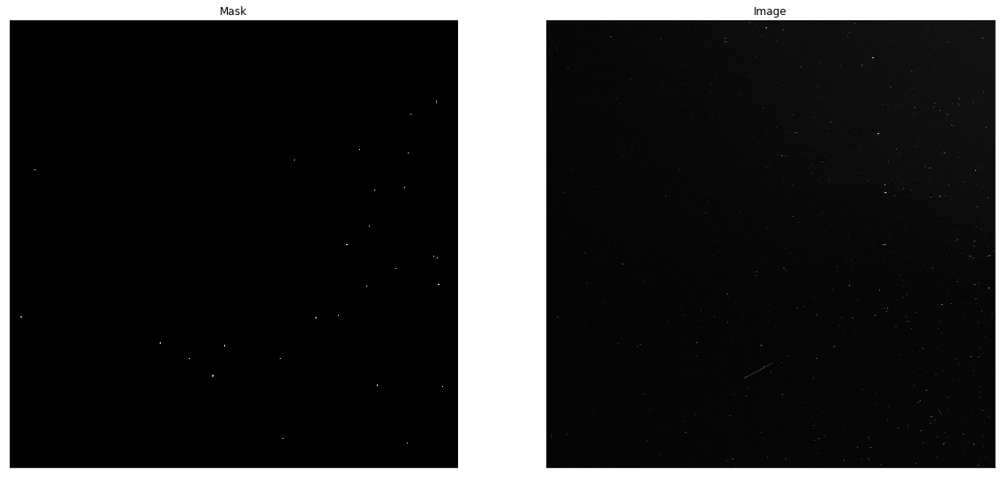

Index 106
INFO: Iteration 1: Found 129 cosmic-ray pixels, Total: 129 [unknown]


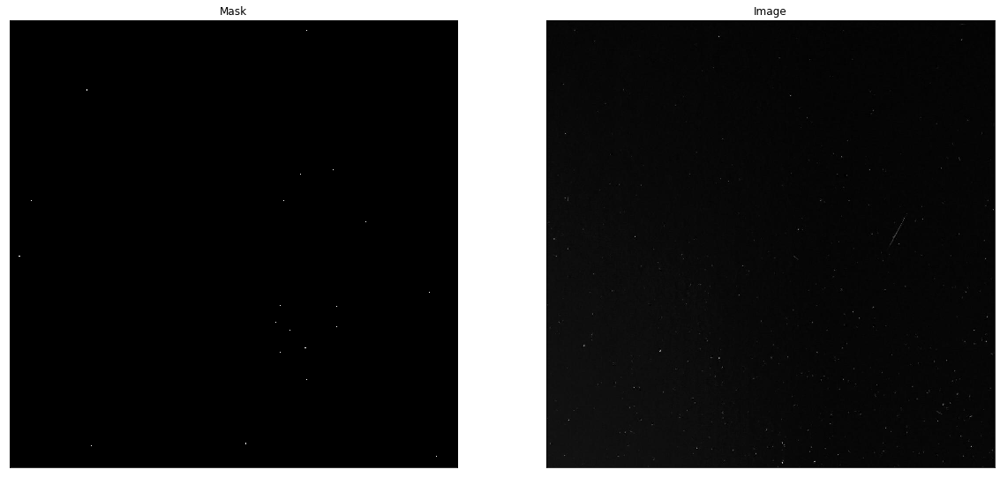

Index 107
INFO: Iteration 1: Found 161 cosmic-ray pixels, Total: 161 [unknown]


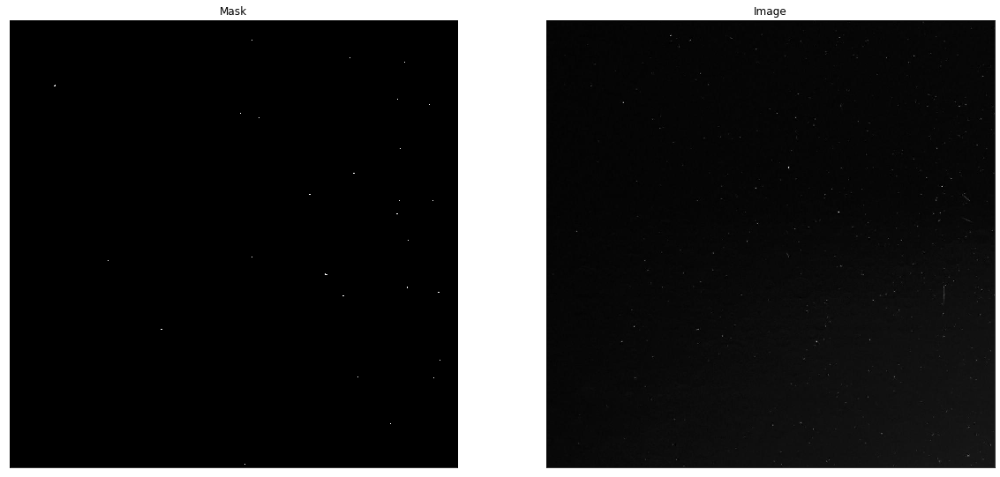

Index 108
INFO: Iteration 1: Found 135 cosmic-ray pixels, Total: 135 [unknown]


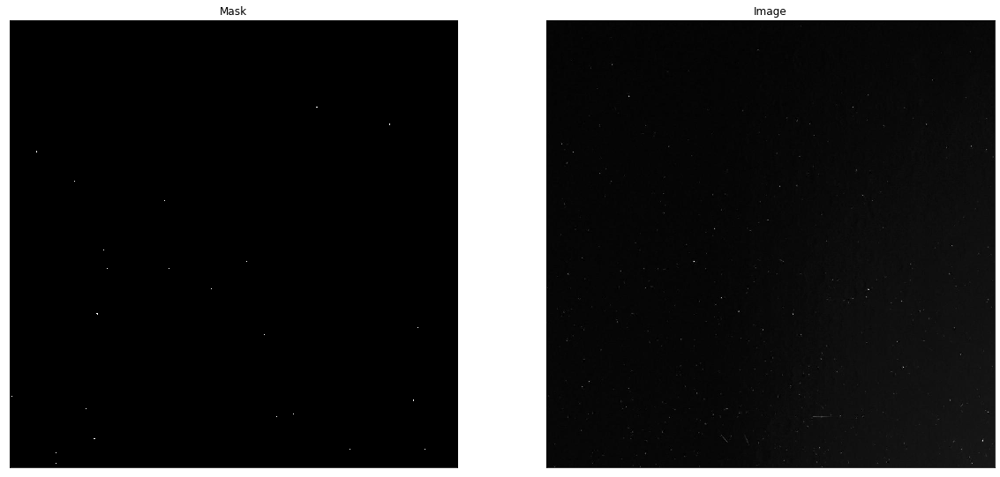

Index 109
INFO: Iteration 1: Found 84 cosmic-ray pixels, Total: 84 [unknown]


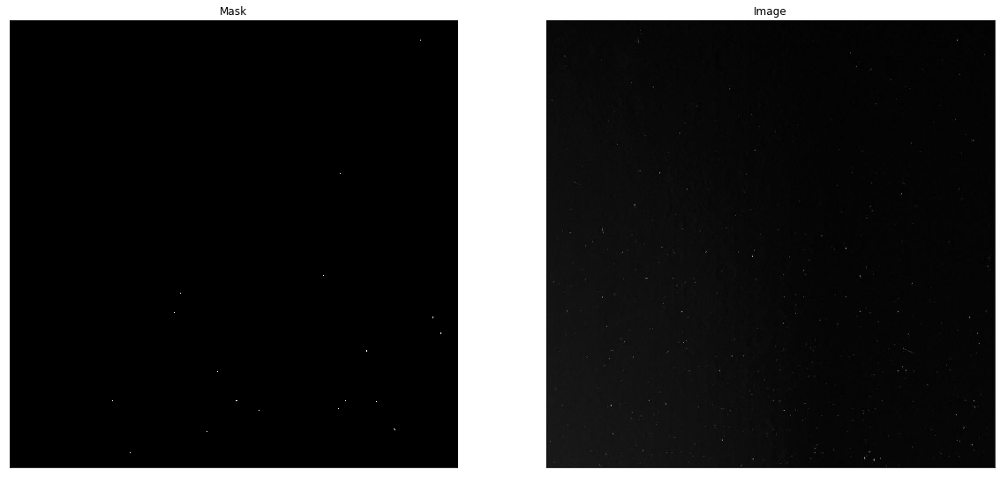

Index 110
INFO: Iteration 1: Found 112 cosmic-ray pixels, Total: 112 [unknown]


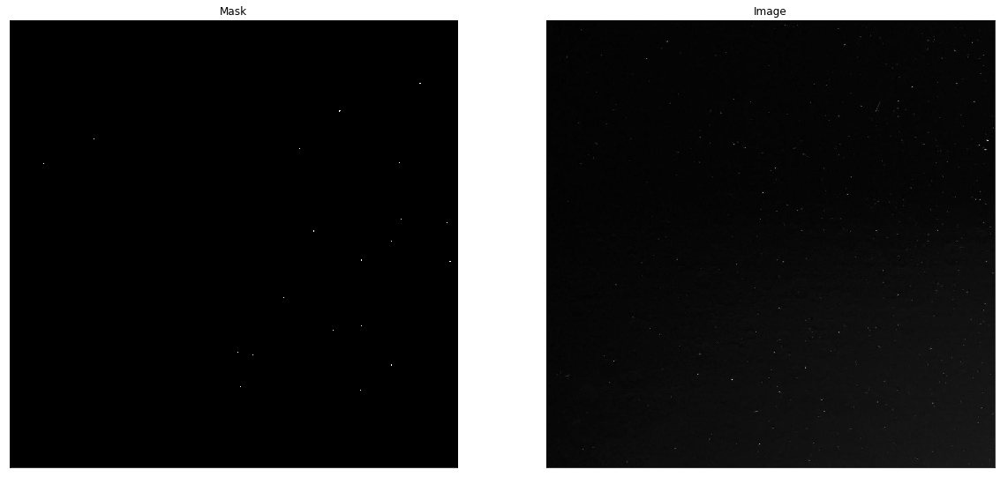

Index 111
INFO: Iteration 1: Found 76 cosmic-ray pixels, Total: 76 [unknown]


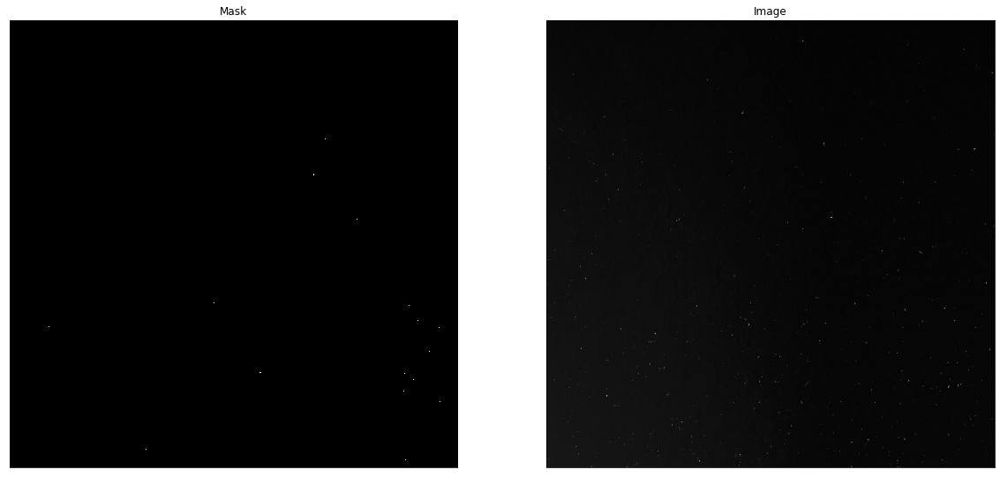

Index 112
INFO: Iteration 1: Found 76 cosmic-ray pixels, Total: 76 [unknown]


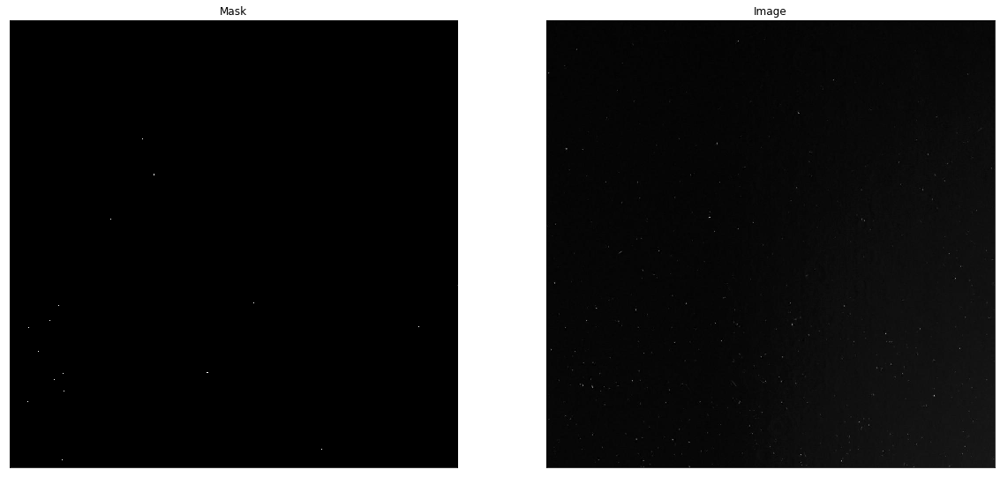

Index 113
INFO: Iteration 1: Found 511 cosmic-ray pixels, Total: 511 [unknown]


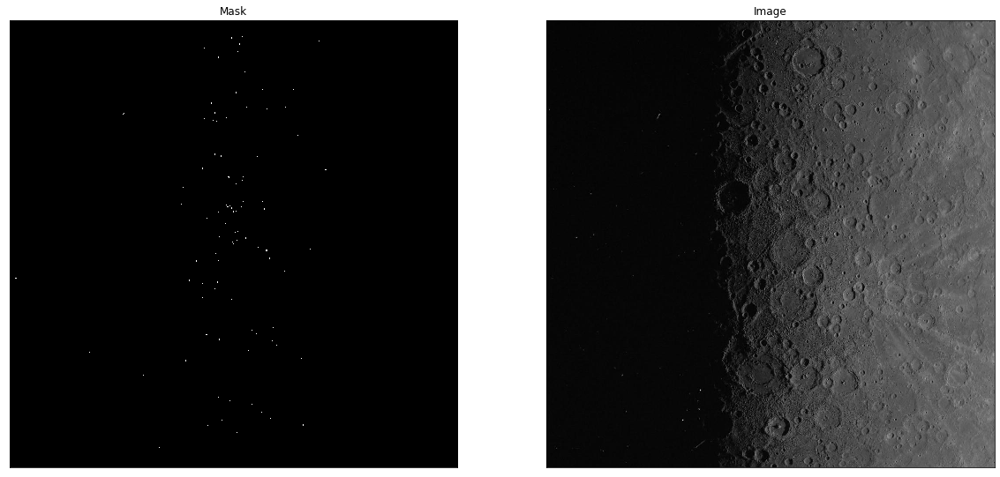

Index 114
INFO: Iteration 1: Found 495 cosmic-ray pixels, Total: 495 [unknown]


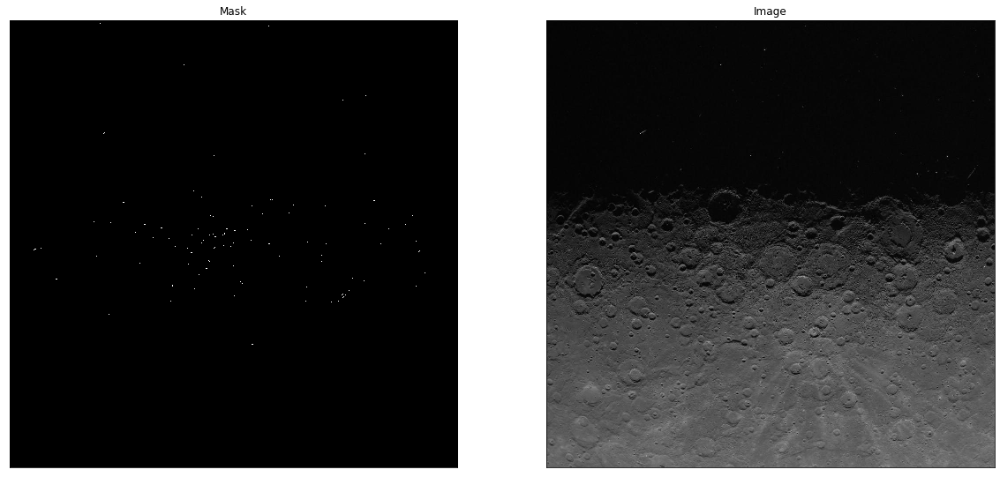

Index 115
INFO: Iteration 1: Found 7 cosmic-ray pixels, Total: 7 [unknown]


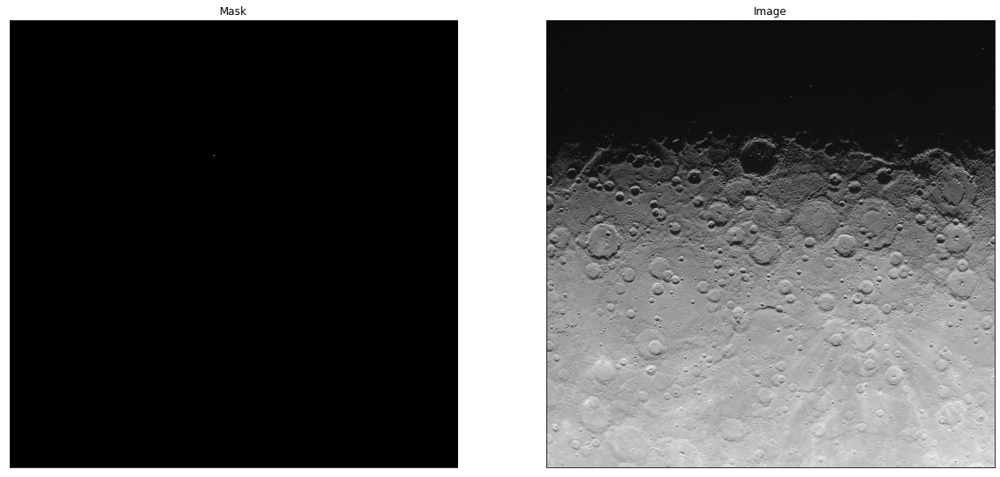

Index 116
INFO: Iteration 1: Found 19 cosmic-ray pixels, Total: 19 [unknown]


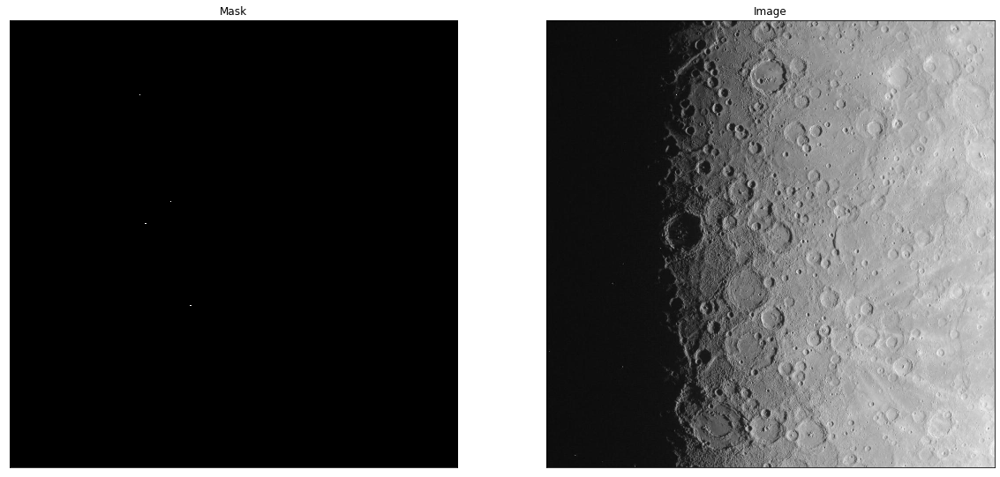

Index 117
INFO: Iteration 1: Found 19 cosmic-ray pixels, Total: 19 [unknown]


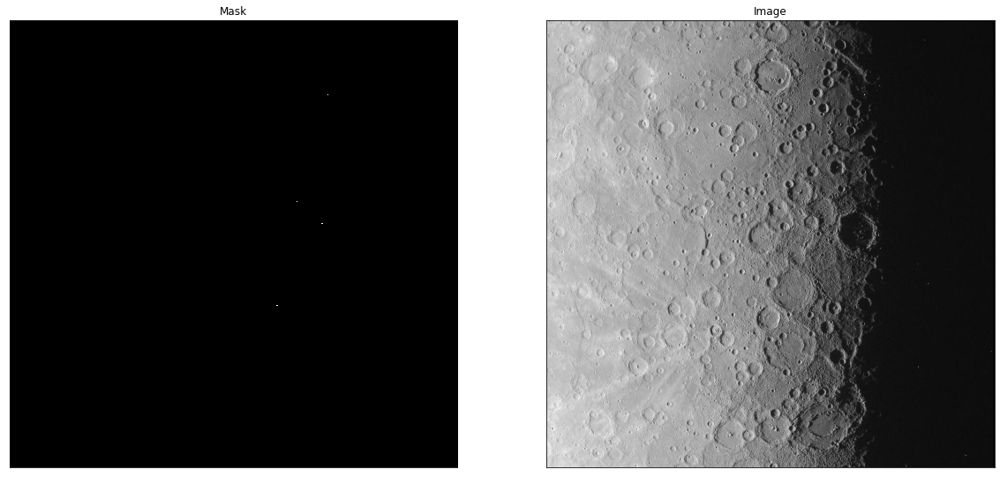

Index 118
INFO: Iteration 1: Found 944 cosmic-ray pixels, Total: 944 [unknown]


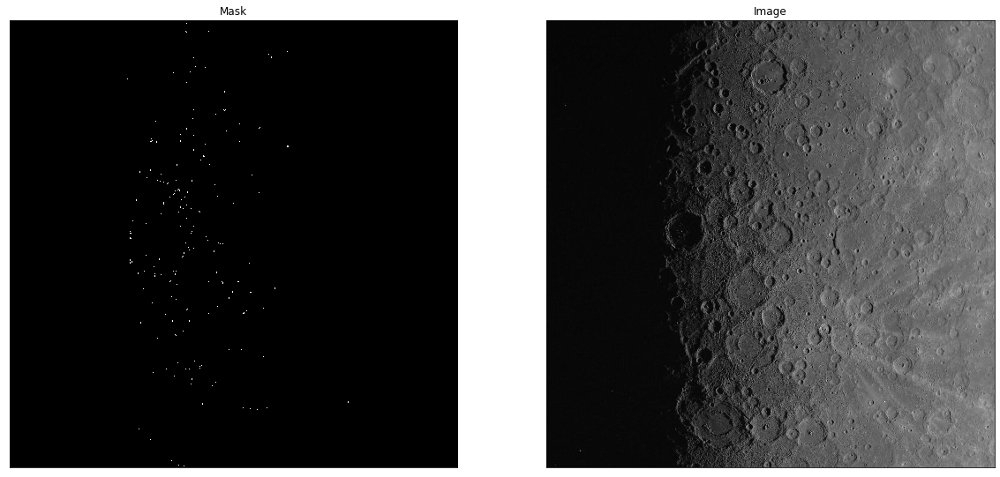

Index 119
INFO: Iteration 1: Found 794 cosmic-ray pixels, Total: 794 [unknown]


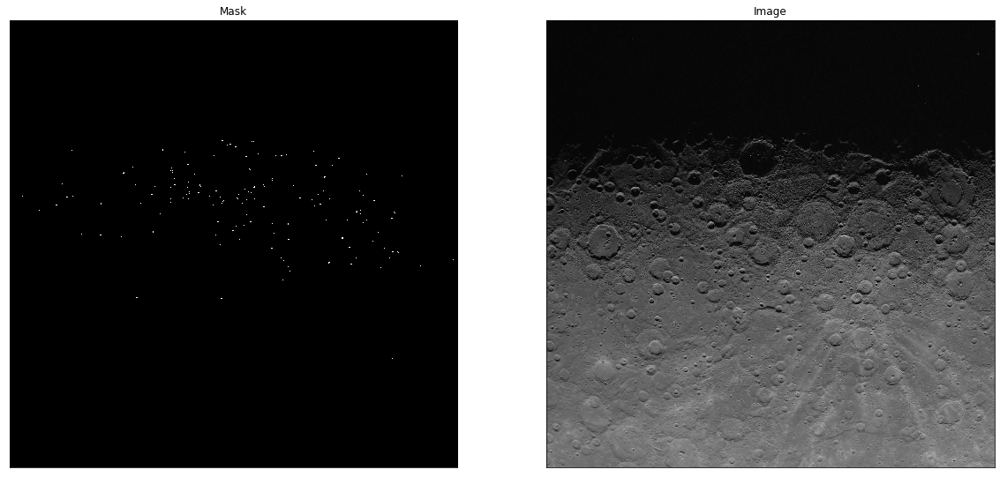

Index 120
INFO: Iteration 1: Found 1258 cosmic-ray pixels, Total: 1258 [unknown]


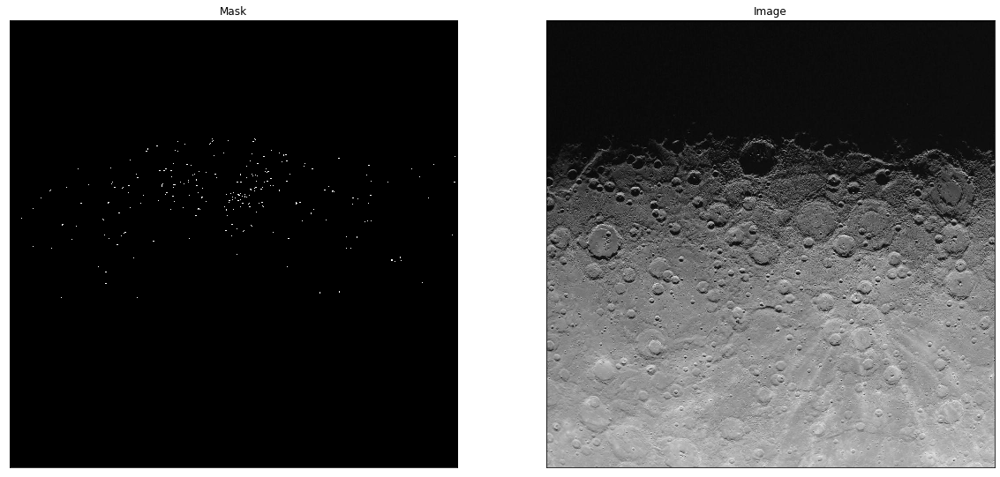

Index 121
INFO: Iteration 1: Found 1226 cosmic-ray pixels, Total: 1226 [unknown]


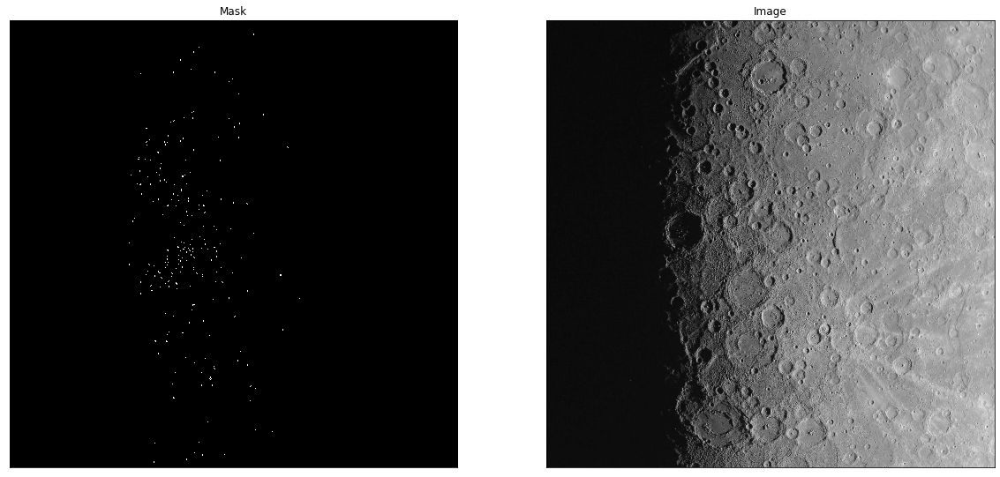

Index 122
INFO: Iteration 1: Found 1222 cosmic-ray pixels, Total: 1222 [unknown]


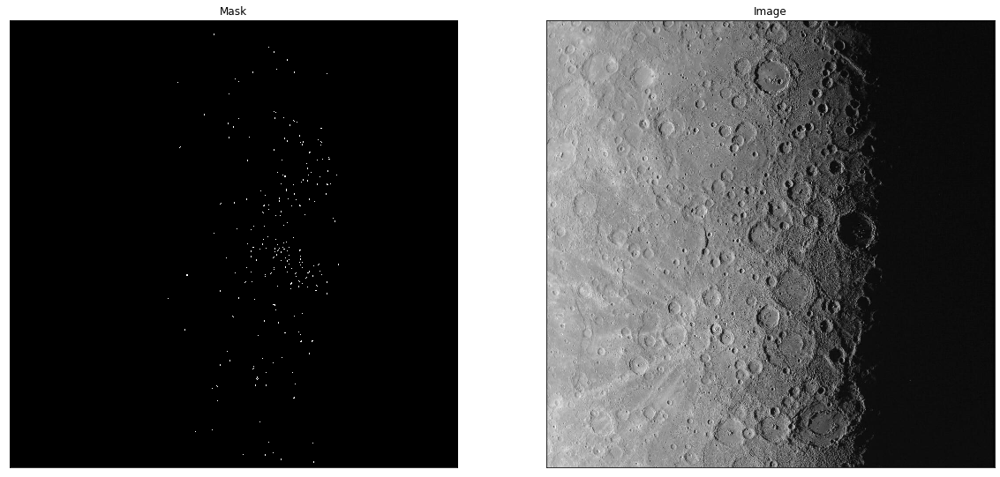

Index 123
INFO: Iteration 1: Found 297 cosmic-ray pixels, Total: 297 [unknown]


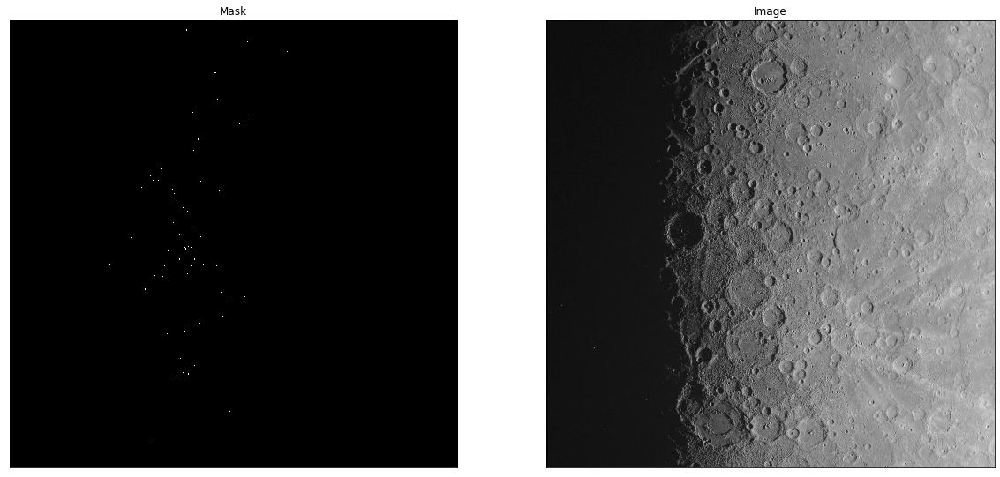

In [ ]:
test_lacosmic('Positives')

##### Negative Data
- The image on the left is the cosmic ray mask predicted by the La-cosmic algorithm (white pixels represent location of cosmic rays, while black pixels represent bakground)
- The original negative image is shown on right
- Predicts correctly in 17/26 cases

Index 0
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


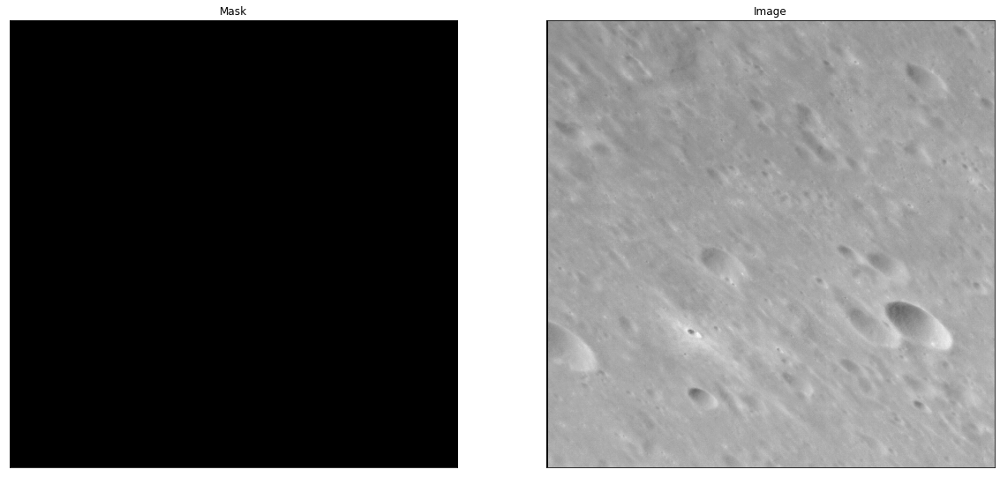

Index 1
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


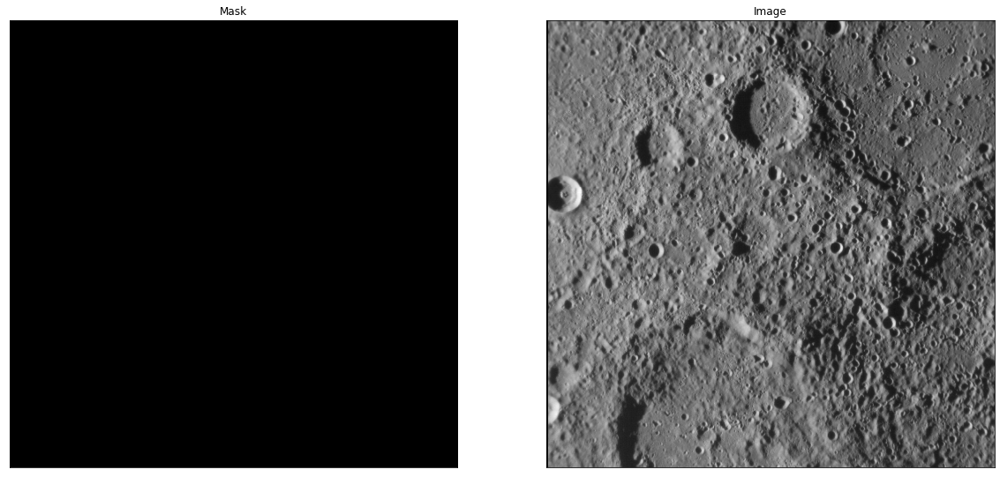

Index 2
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


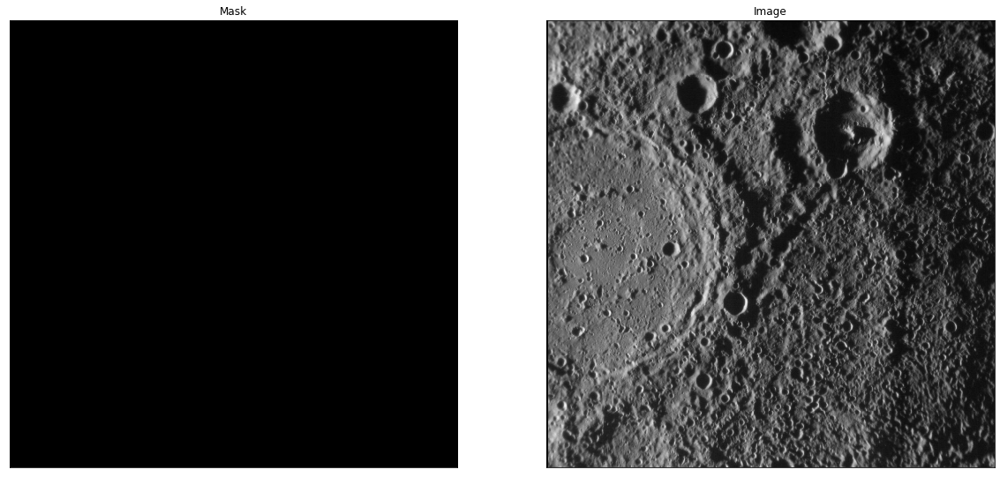

Index 3
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


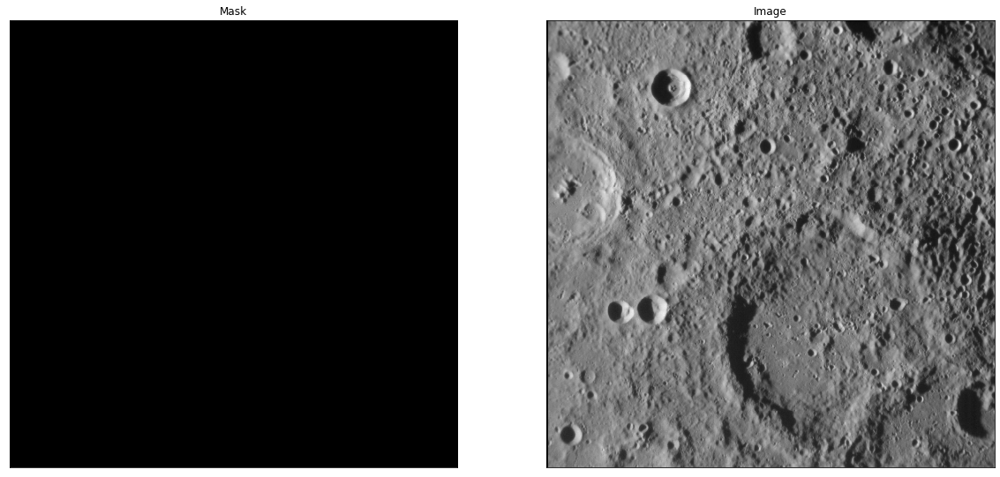

Index 4
INFO: Iteration 1: Found 49 cosmic-ray pixels, Total: 49 [unknown]


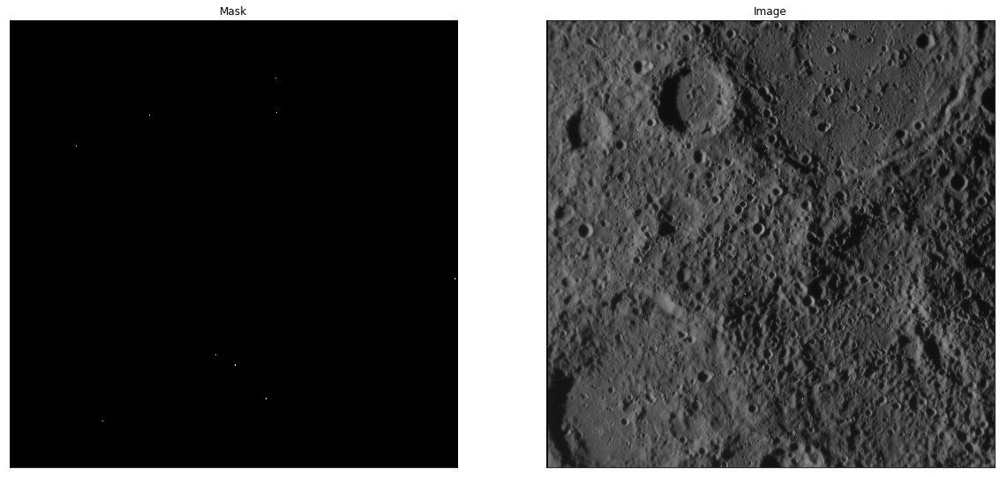

Index 5
INFO: Iteration 1: Found 6 cosmic-ray pixels, Total: 6 [unknown]


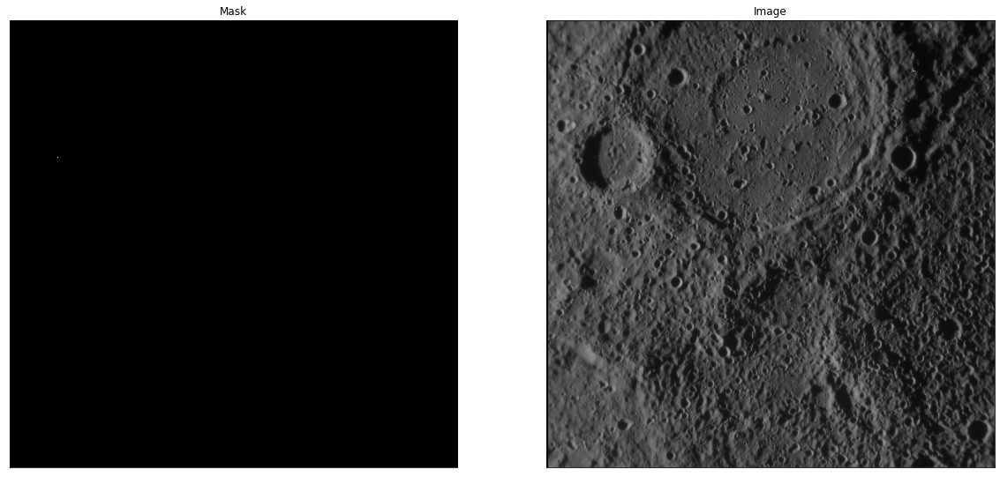

Index 6
INFO: Iteration 1: Found 6 cosmic-ray pixels, Total: 6 [unknown]


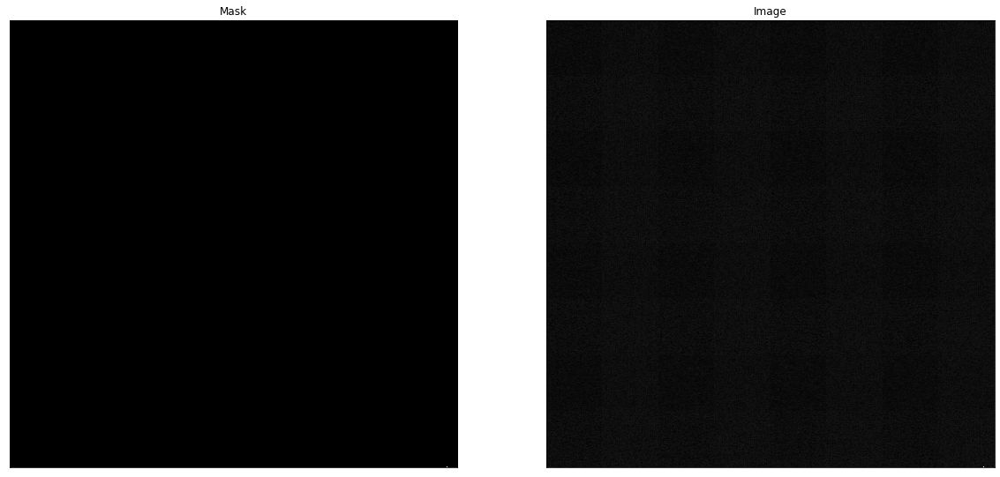

Index 7
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


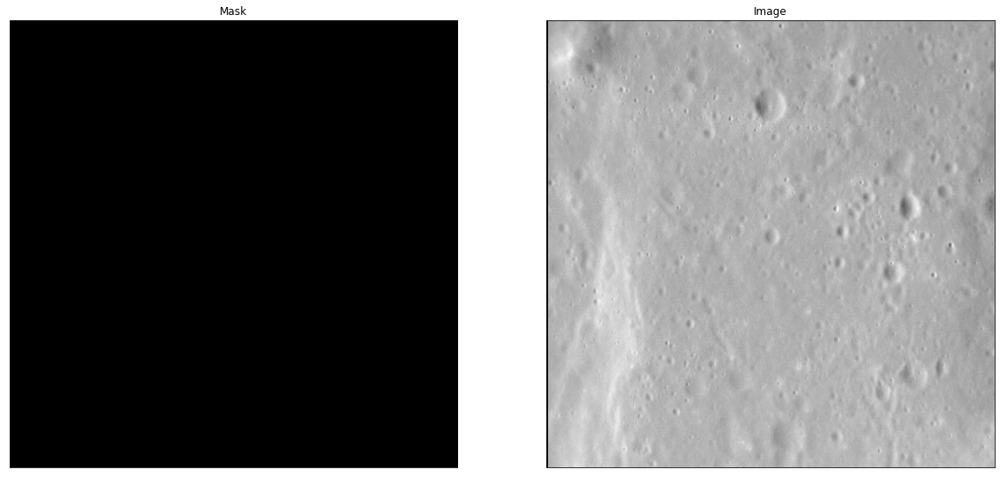

Index 8
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


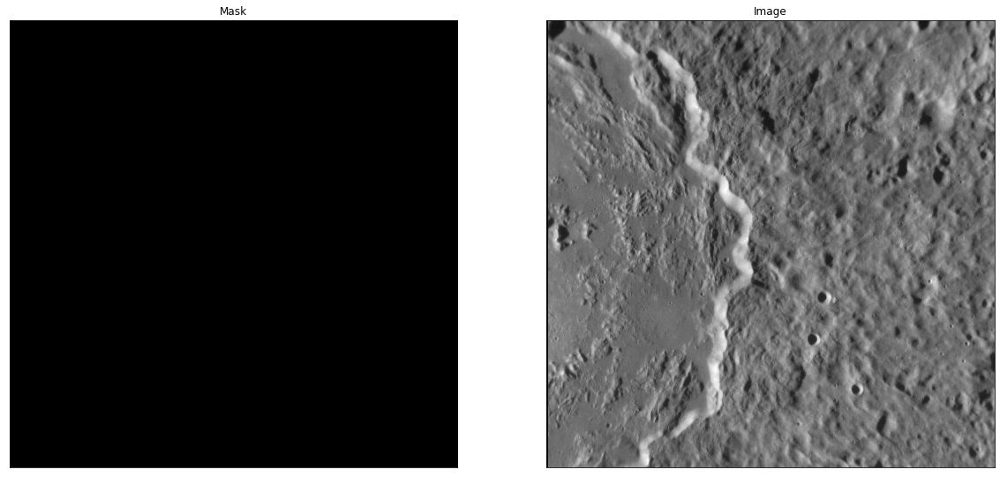

Index 9
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


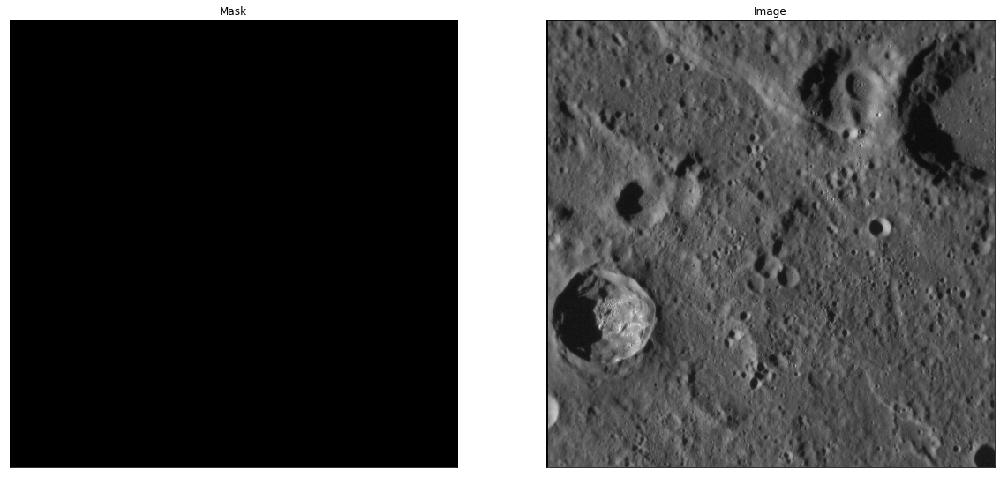

Index 10
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


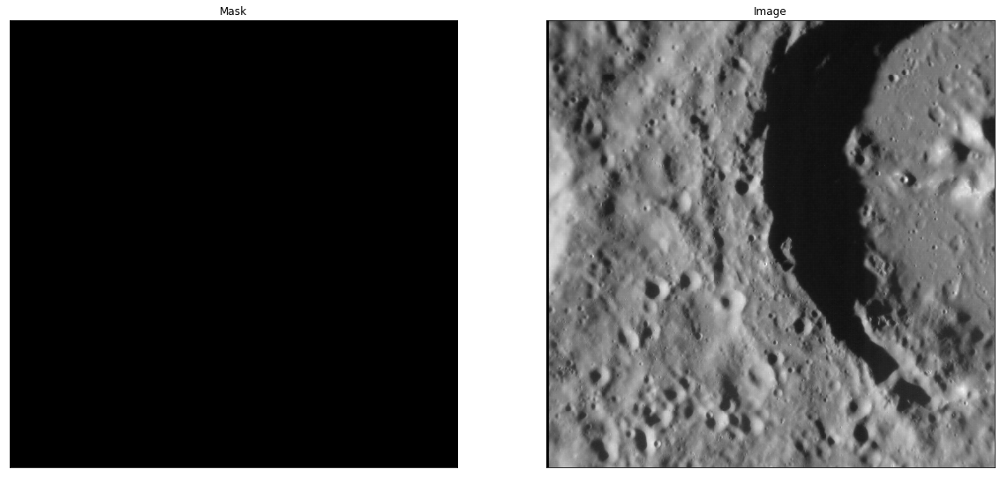

Index 11
INFO: Iteration 1: Found 5 cosmic-ray pixels, Total: 5 [unknown]


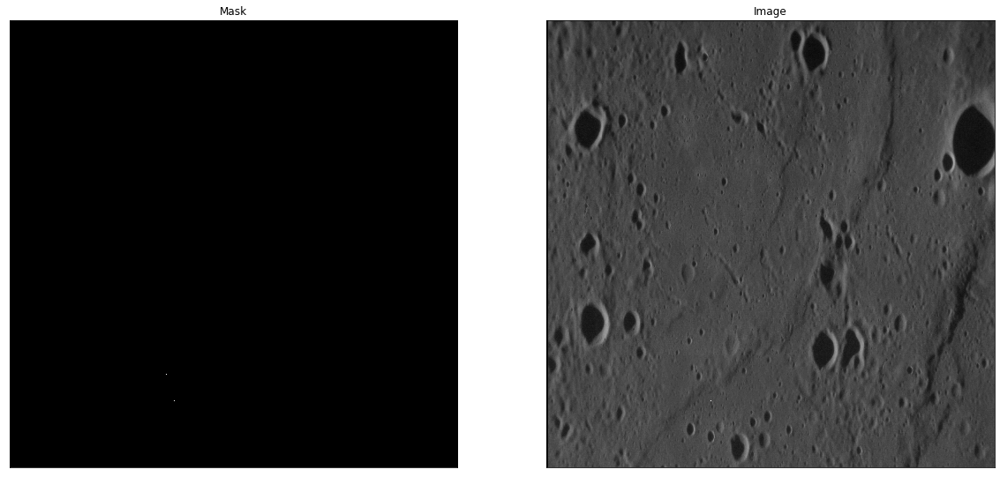

Index 12
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


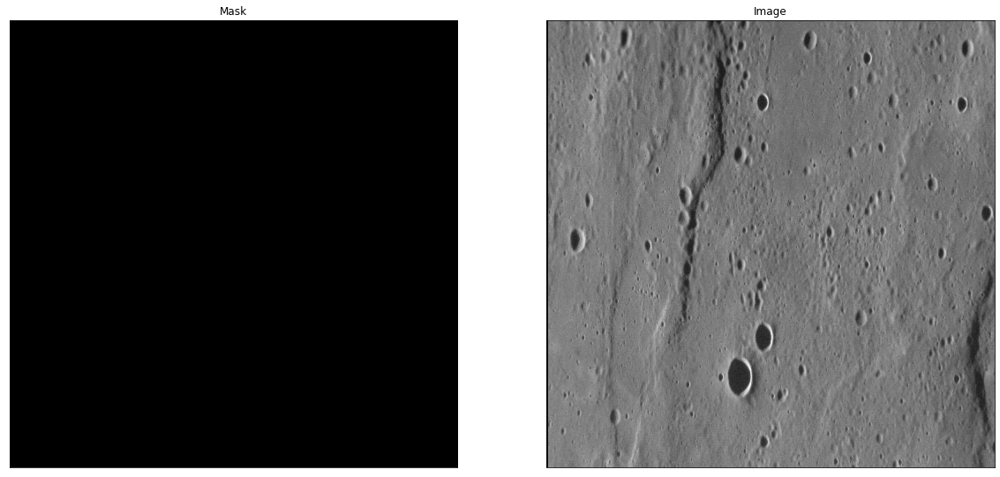

Index 13
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


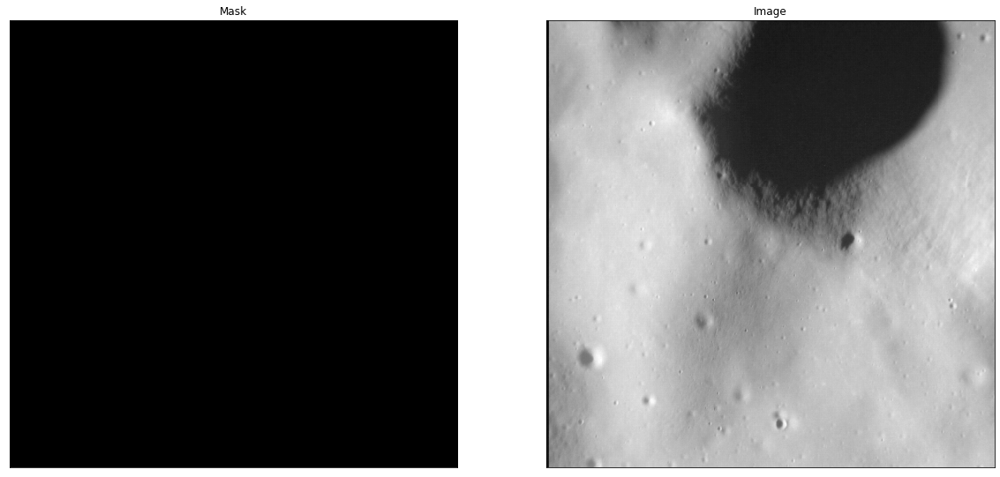

Index 14
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


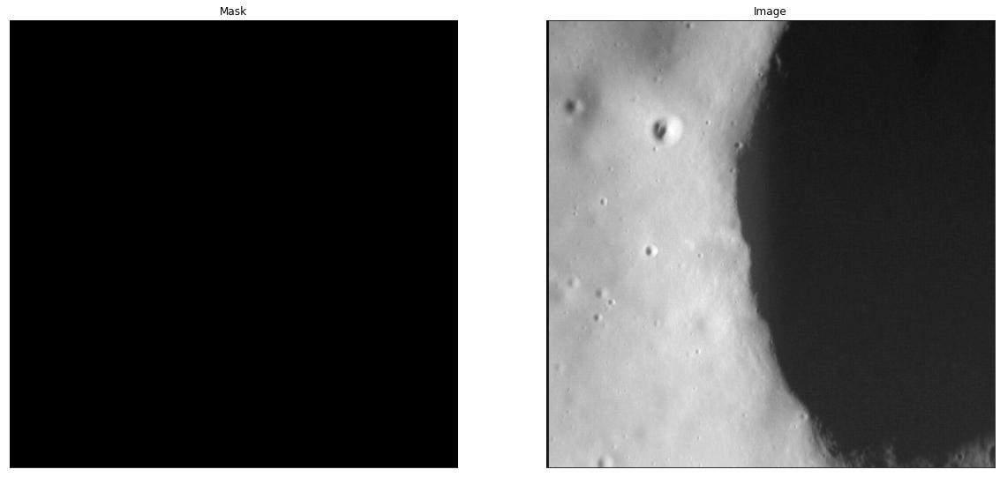

Index 15
INFO: Iteration 1: Found 9 cosmic-ray pixels, Total: 9 [unknown]


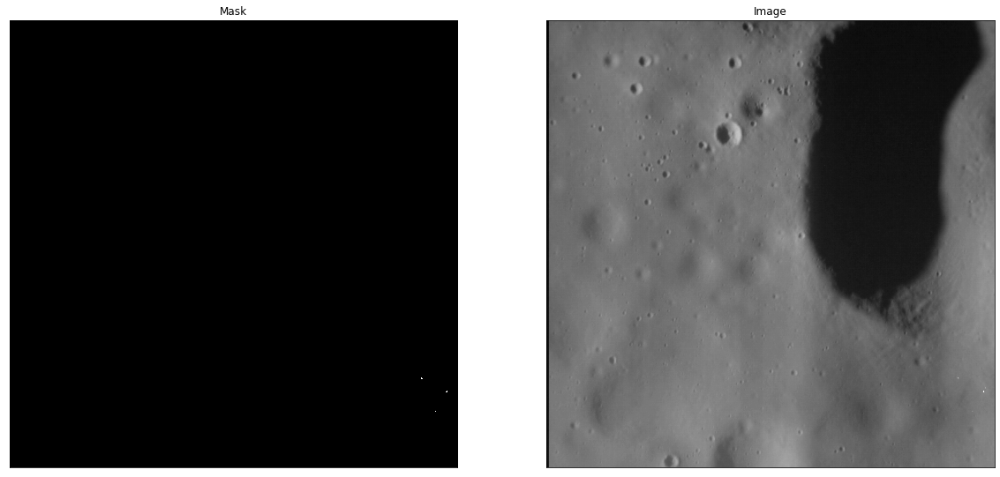

Index 16
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


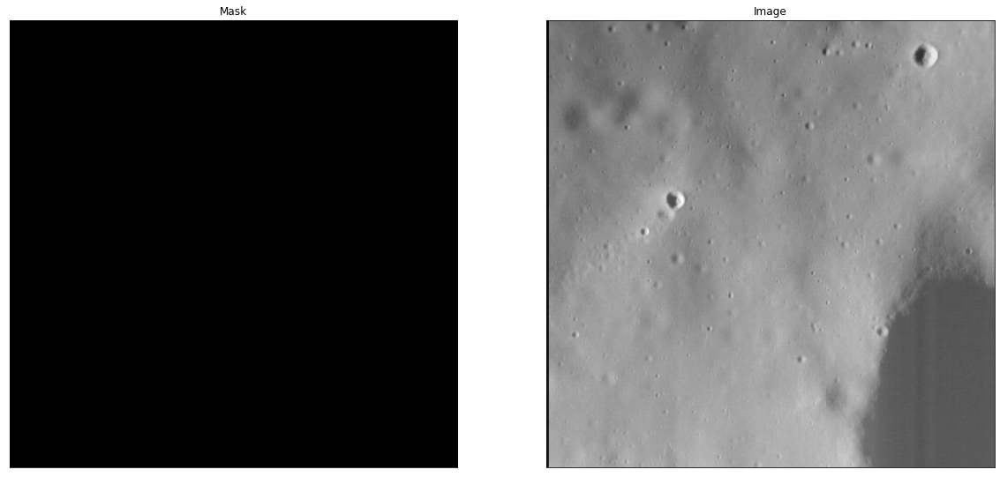

Index 17
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


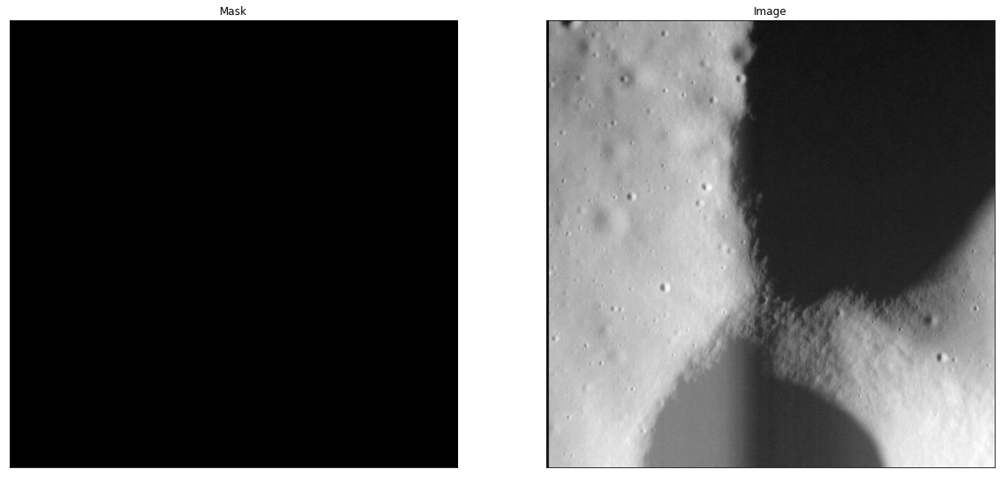

Index 18
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


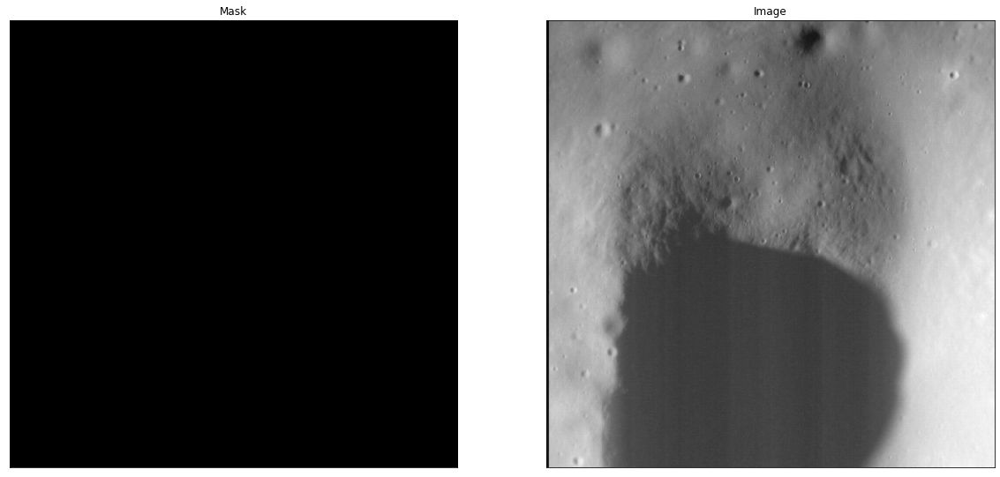

Index 19
INFO: Iteration 1: Found 6 cosmic-ray pixels, Total: 6 [unknown]


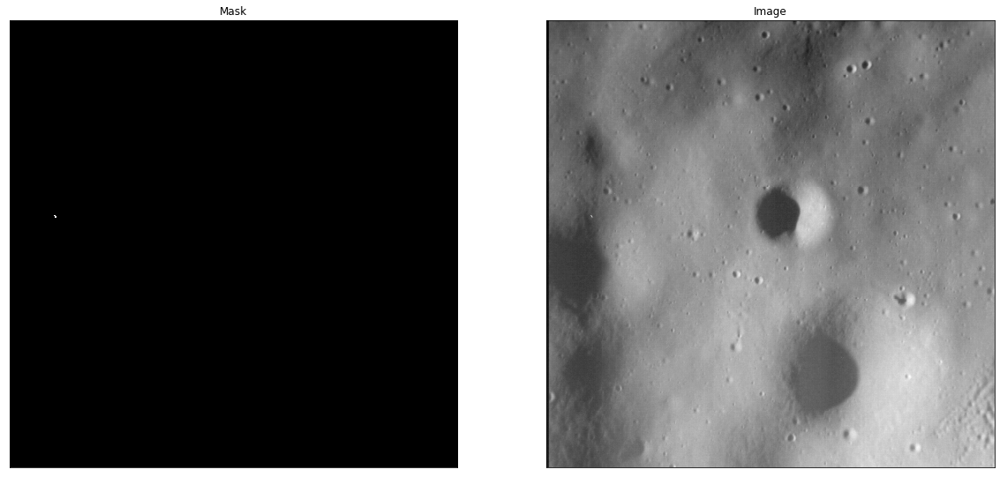

Index 20
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


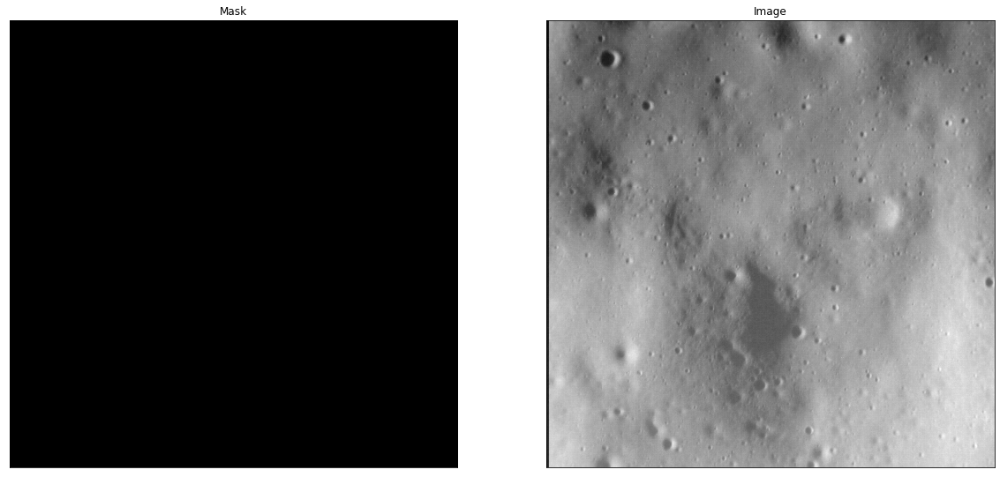

Index 21
INFO: Iteration 1: Found 3 cosmic-ray pixels, Total: 3 [unknown]


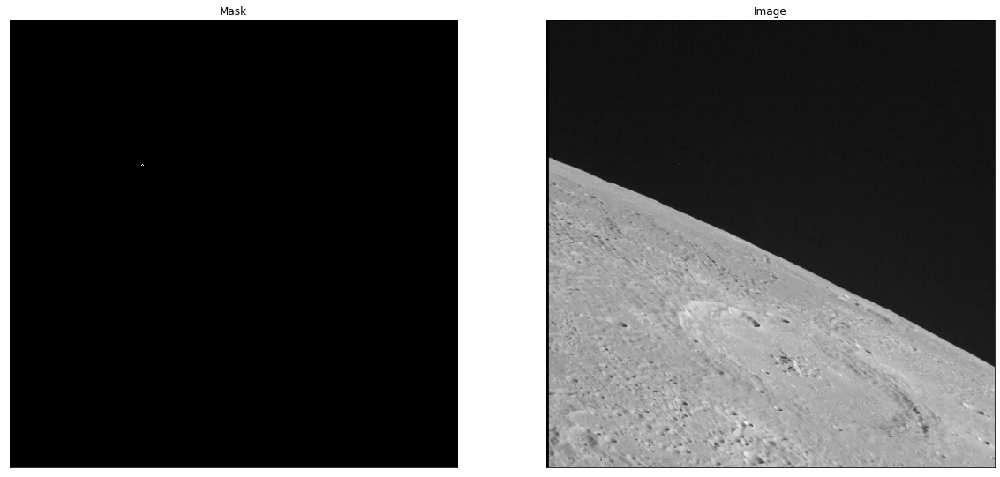

Index 22
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


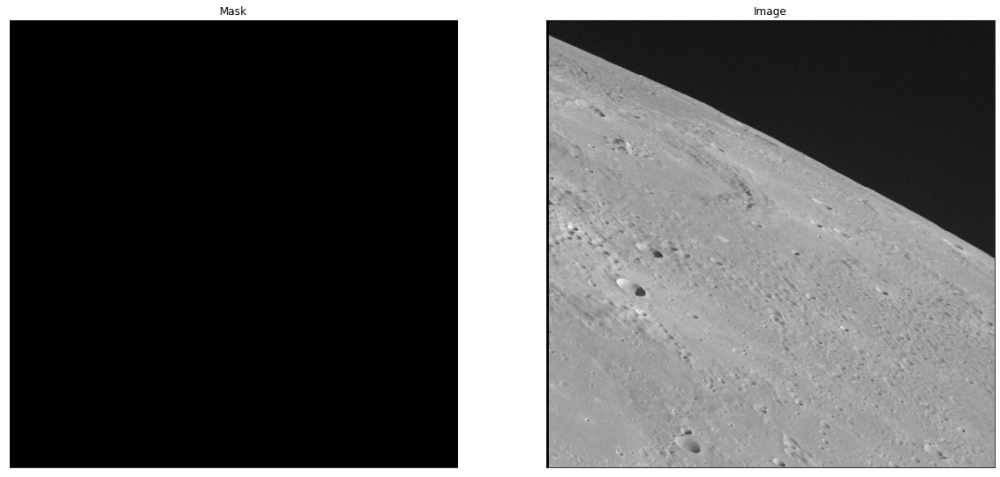

Index 23
INFO: Iteration 1: Found 0 cosmic-ray pixels, Total: 0 [unknown]


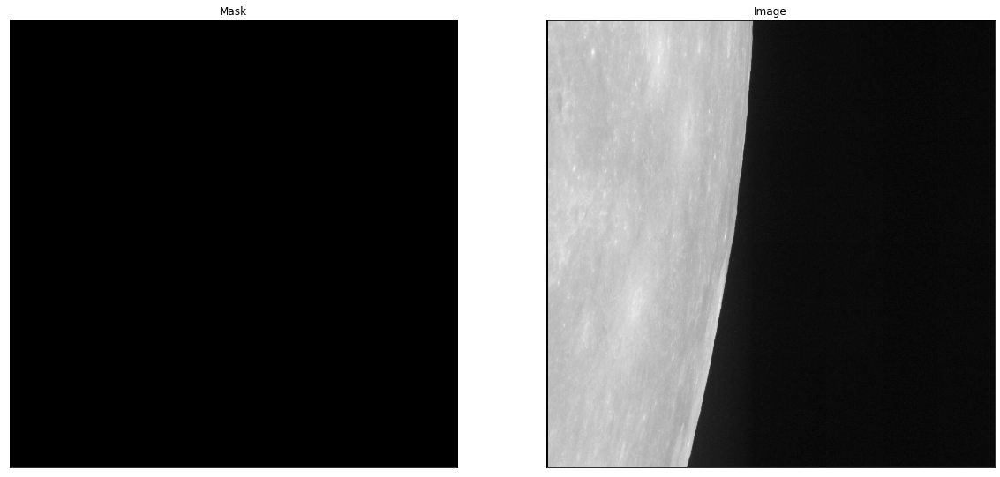

Index 24
INFO: Iteration 1: Found 1338 cosmic-ray pixels, Total: 1338 [unknown]


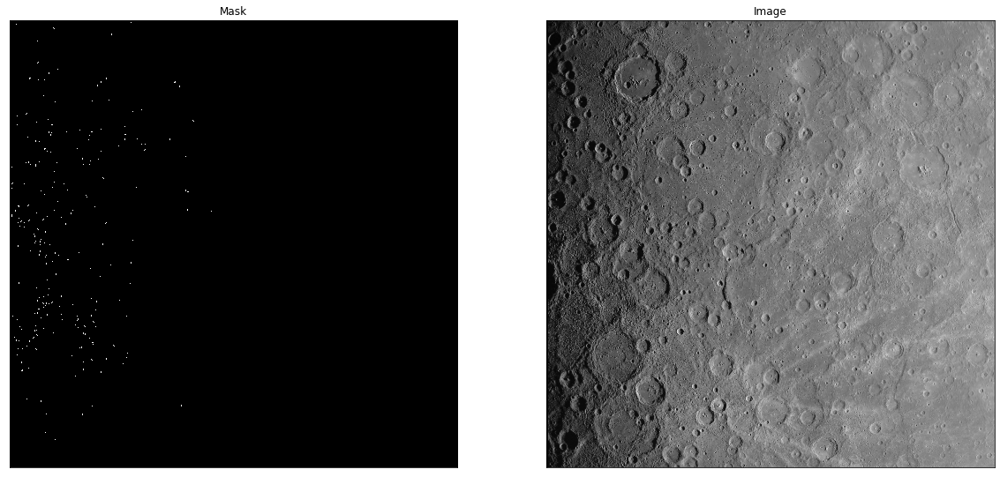

Index 25
INFO: Iteration 1: Found 948 cosmic-ray pixels, Total: 948 [unknown]


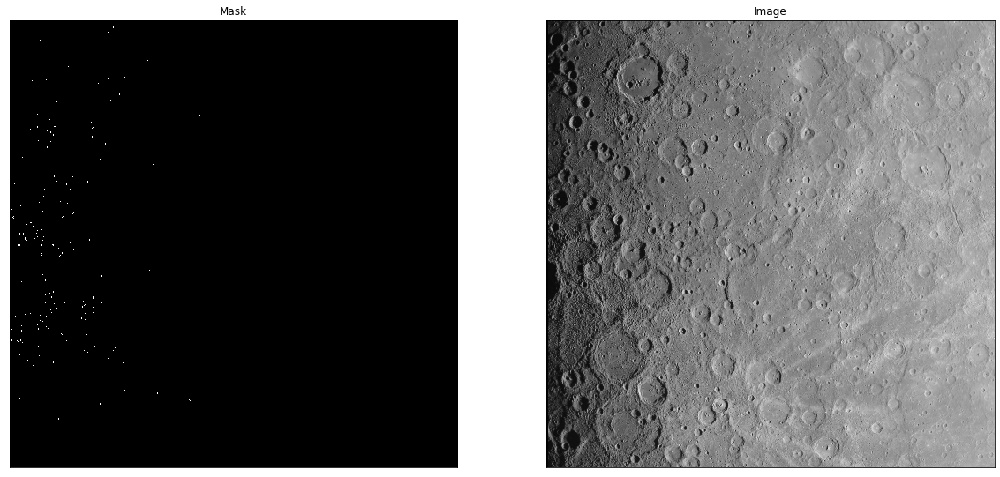

In [ ]:
test_lacosmic('Negatives')